In [1]:
import FinanceDataReader as fdr
import pandas_datareader as pdr
import pymysql
import pandas as pd
import numpy as np
from datetime import timedelta
from datetime import datetime
import pytz
import requests
from bs4 import BeautifulSoup
import re
from dateutil.relativedelta import relativedelta
import sys
import pymysql
import time
from matplotlib import pyplot as plt
import seaborn
import math
fdr.__version__

C:\Users\Sunghyun\Anaconda3\lib\site-packages\pandas_datareader\compat\__init__.py:7: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  from pandas.util.testing import assert_frame_equal


'0.9.1'

## Data Load 및 전처리

### Data Load

In [2]:
## Make Connection
def connect():
    connection = pymysql.connect(host='localhost',
                             user='investment',
                             password='1111',
                             db='investment',
                             charset='utf8mb4',
                             cursorclass=pymysql.cursors.DictCursor)
    return connection

In [3]:
#데이터베이스 연결
connection = connect()

df_comp = []
df_kospi = []
df_financial = []
df_financial_statement = []

with connection.cursor() as cursor:
    sql = '''SELECT *
                FROM company;'''
    cursor.execute(sql)
    df_comp = pd.DataFrame(cursor.fetchall())
    
    sql = '''SELECT *
                FROM companydailystockdata;'''
    cursor.execute(sql)
    df_kospi = pd.DataFrame(cursor.fetchall())
    
    sql = '''SELECT *
                FROM dailyfinancedata;'''
    cursor.execute(sql)
    df_financial = pd.DataFrame(cursor.fetchall())
    
    sql = '''SELECT *
                FROM financial_statement;'''
    cursor.execute(sql)
    df_financial_statement = pd.DataFrame(cursor.fetchall())
    
connection.close()

###### Store Variable List

In [21]:
%store -r name_list
%store int_sec

print(name_list)
print(int_sec)

Stored 'int_sec' (list)
{'매출액': 'sales', '영업이익': 'operating_income', '당기순이익(지배)': 'net_income', '자산총계': 'asset', '부채총계': 'liability', '자본총계(지배)': 'capital', '자본금': 'capital_stock', '영업활동현금흐름': 'operating_cashflow', '투자활동현금흐름': 'investment_cashflow', '재무활동현금흐름': 'financial_cashflow', 'CAPEX': 'capex', 'FCF': 'fcf', '이자발생부채': 'Interest_liability', '영업이익률': 'operating_margin', '순이익률': 'net_margin', 'ROE(%)': 'roe', 'ROA(%)': 'roa', '부채비율': 'debt_ratio', '자본유보율': 'capital_reserve_rate', 'EPS(원)': 'eps', 'PER(배)': 'per', 'BPS(원)': 'bps', 'PBR(배)': 'pbr', '현금DPS(원)': 'dps', '현금배당수익률': 'dividend_yield', '현금배당성향(%)': 'dividend_payout', '발행주식수(보통주)': 'issued_stocks'}
['전기 및 통신 공사업', '전기 통신업', '컴퓨터 및 주변장치 제조업', '측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외', '기타 전기장비 제조업', '전동기, 발전기 및 전기 변환 · 공급 · 제어 장치 제조업', '전기업', '그외 기타 제품 제조업', '컴퓨터 프로그래밍, 시스템 통합 및 관리업', '일차전지 및 축전지 제조업', '반도체 제조업', '전자부품 제조업']


### Data 정제 (string → float), record_date(year) Set Index

In [6]:
df_kosp = df_kospi.copy()
df_fina = df_financial.copy()
df_fist = df_financial_statement.copy()

df_kosp[df_kosp.columns[3:]] = df_kosp[df_kospi.columns[3:]].astype(float)
df_fina[df_fina.columns[2:]] = df_fina[df_fina.columns[2:]].astype(float)
df_fist[df_fist.columns[4:]] = df_fist[df_fist.columns[4:]].astype(float)

df_kosp = df_kosp.set_index('record_date')
df_fina = df_fina.set_index('record_date')
df_fist = df_fist.set_index('year')
df_kosp.index = pd.to_datetime(df_kosp.index)
df_fina.index = pd.to_datetime(df_fina.index)

In [7]:
df_comp.head(2)

,company_id,name,code,sector,industry,update_datetime
0,6016,DSR,155660,1차 비철금속 제조업,합섬섬유로프,2020-03-02 02:27:15
1,6017,GS글로벌,001250,상품 종합 도매업,"수출입업(시멘트,철강금속,전기전자,섬유,기계화학),상품중개,광업,채석업/하수처리 서...",2020-03-02 02:27:15


In [8]:
df_comp.isnull().sum()

company_id         0
name               0
code               0
sector             0
industry           0
update_datetime    0
dtype: int64

In [9]:
df_kosp.tail(2)

,id,company_id,starting_price,closing_price,exchange_rate,volume,organ,foreign,foreign_ratio
record_date,,,,,,,,,
2020-05-27,4444752,6411,28950.0,30600.0,0.0570,317481.0,12326.0,29968.0,7.41
2020-05-28,4444753,6411,31100.0,32150.0,0.0507,1019750.0,60554.0,-12384.0,7.27


In [10]:
df_kosp.isnull().sum()

id                      0
company_id              0
starting_price          0
closing_price           0
exchange_rate           0
volume               5600
organ             1343133
foreign           1343802
foreign_ratio     1343133
dtype: int64

In [11]:
df_fina.tail(2)

,id,kospi_price,kospi_exchange_rate,nasdaq_price,nasdaq_exchange_rate,csi300_price,csi300_exchange_rate,usd_krw_price,usd_krw_exchange_rate,gold_price,gold_exchange_rate,oil_dbi_price,oil_dbi_exchange_rate,bitcoin_price,bitcoin_exchange_rate
record_date,,,,,,,,,,,,,,,
2020-05-18,56454,1937.11,0.0051,NaN,NaN,3922.91,0.0026,1229.36,-0.003,NaN,NaN,NaN,NaN,11605000.0,-0.0008
2020-05-20,56455,1989.64,0.0046,NaN,NaN,3935.22,-0.0053,1227.60,0.002,NaN,NaN,NaN,NaN,11710000.0,-0.0015


In [12]:
df_fina.isnull().sum()

id                           0
kospi_price               4197
kospi_exchange_rate       4197
nasdaq_price              4526
nasdaq_exchange_rate      4526
csi300_price             10865
csi300_exchange_rate     10865
usd_krw_price             4591
usd_krw_exchange_rate     4591
gold_price                8054
gold_exchange_rate        8054
oil_dbi_price            11115
oil_dbi_exchange_rate    11115
bitcoin_price            13512
bitcoin_exchange_rate    13512
dtype: int64

In [13]:
df_fist.tail(2)

,id,company_id,update_date,sales,operating_income,net_income,asset,liability,capital,capital_stock,...,debt_ratio,capital_reserve_rate,eps,per,bps,pbr,dividend_yield,dividend_payout,issued_stocks,dps
year,,,,,,,,,,,,,,,,,,,,,
2018,4328,6586,None,2940.0,-615.0,-444.0,6537.0,2940.0,3581.0,134.0,...,81.75,2670.21,-869.0,0.0,7013.0,0.33,0.0,0.0,51120439.0,0.0
2019,4329,6586,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0


In [14]:
df_fist.isnull().sum()

id                         0
company_id                 0
update_date             3973
sales                      0
operating_income           0
net_income                 0
asset                      0
liability                  0
capital                    0
capital_stock              0
operating_cashflow         0
investment_cashflow        0
financial_cashflow         0
capex                      0
fcf                        0
Interest_liability         0
operating_margin           0
net_margin                 0
roe                        0
roa                        0
debt_ratio                 0
capital_reserve_rate       0
eps                        0
per                        0
bps                        0
pbr                        0
dividend_yield             0
dividend_payout            0
issued_stocks              0
dps                        0
dtype: int64

## 간단한 Pandas 복습

#### 날짜별로 뽑기

In [15]:
df_kosp_2018 = df_kosp[df_kosp.index.year == 2018]
df_kosp_2018.head()

,id,company_id,starting_price,closing_price,exchange_rate,volume,organ,foreign,foreign_ratio
record_date,,,,,,,,,
2018-01-02,5470,6351,9750.0,9870.0,0.0123,120676.0,8.0,-25791.0,11.68
2018-01-03,5471,6351,9900.0,10000.0,0.0132,268220.0,0.0,-23102.0,11.67
2018-01-04,5472,6351,10050.0,9750.0,-0.0250,161342.0,0.0,-41336.0,11.52
2018-01-05,5473,6351,9750.0,9910.0,0.0164,116604.0,131.0,2664.0,11.53
2018-01-08,5474,6351,10000.0,9950.0,0.0040,158326.0,-8296.0,-10517.0,11.49


#### 특정 Column만 뽑기 + null값 제거

In [16]:
df_foreign_ratio = df_kosp[['company_id', 'foreign_ratio']]
df_foreign_ratio = df_foreign_ratio[df_foreign_ratio['foreign_ratio'].notnull()]
df_foreign_ratio.head(2)

,company_id,foreign_ratio
record_date,,
2005-01-03,6351,0.49
2005-01-04,6351,0.49


#### 여러 Table Join하기

In [17]:
df_merge = pd.merge(df_fist, df_comp, how='inner', on = 'company_id')

df_merge.head(2)

,id,company_id,update_date,sales,operating_income,net_income,asset,liability,capital,capital_stock,...,pbr,dividend_yield,dividend_payout,issued_stocks,dps,name,code,sector,industry,update_datetime
0,357,6351,None,2232.0,48.0,56.0,3172.0,871.0,2301.0,279.0,...,0.98,0.98,39.46,27931470.0,80.0,동화약품,000020,의약품 제조업,"의약품 제조,판매,수출입",2020-03-02 02:27:15
1,358,6351,None,2375.0,113.0,263.0,3246.0,717.0,2529.0,279.0,...,0.89,1.35,11.59,27931470.0,110.0,동화약품,000020,의약품 제조업,"의약품 제조,판매,수출입",2020-03-02 02:27:15


#### Plot 함수

In [18]:
def plot(df, column_names=[], year=[], fig_size = (40,10), lines = [], normalize = False, minmax = False):
    
    df_plot = pd.DataFrame(df.loc[:, column_names])
    df_plot = df_plot[df_plot.notna()]
    try:
        df_plot = df_plot[df_plot.index.year.isin(year)]
    except Exception as e:
        print(e, "Year should be passed in a 'list' format")
        return 0
    
    if(normalize == True):
        df_plot=(df_plot-df_plot.mean())/df_plot.std()
    if(minmax == True):    
        df_plot=(df_plot-df_plot.min())/(df_plot.max()-df_plot.min())
    
    df_plot.plot()
    plt.rcParams["figure.figsize"] = fig_size
    
    for line in lines:
        plt.axhline(y=line, color='r', linestyle='-')
    plt.show()
    

## 분석

### 높은 상승률 / 높은 배당률을 가진 기업 찾기

#### 높은 상승률을 가진 기업 : up_rate, up_rate_100

In [19]:
count = 0
up_rate = []
df_int = df_kosp[df_kosp.index.year.isin([2015, 2016, 2017, 2018, 2019])]
for id_ in df_comp['company_id']:
    
    df_test = df_int[df_int['company_id'] == id_]
    df_all = df_test['closing_price']
    try:    
        start_price = df_all.iloc[0]
        end_price = df_all.iloc[-1]
    except Exception as e:
        print(name, e)
    
    rate = round((end_price - start_price)/start_price, 2) * 100
    name = (df_comp[df_comp['company_id'] == id_].loc[:,'name'].iloc[0])
    
    up_rate.append([name,id_, rate])

up_rate = sorted(up_rate, key = lambda x : x[2], reverse = True)
up_rate_100 = []

for comp in up_rate:
    if(comp[2] > 25):
        up_rate_100.append(comp)

케이씨씨 single positional indexer is out-of-bounds
흥국화재 single positional indexer is out-of-bounds


#### 높은 배당률을 가진 기업 : df_high_div, df_div_100

STX중공업


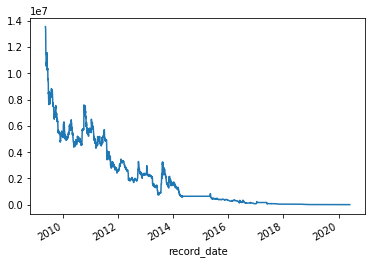

STX중공업


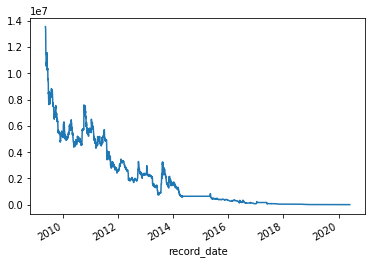

STX중공업


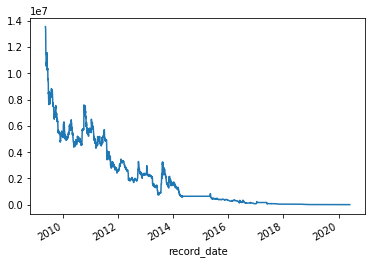

In [20]:
df = df_merge.groupby('company_id').mean()

df = df.sort_values(by=['dividend_yield'], ascending = False)

#배당률 높은 것
df_high_div = pd.merge(df, df_comp, on = 'company_id').loc[:,['name', 'company_id', 'dividend_yield']]
df_div_100 = df_high_div[df_high_div['dividend_yield'] >=3]

count = 0
for high, div in zip(up_rate, df_high_div):
    
    code = comp[1]
    name = comp[0]
    print(name)
    df_kosp[df_kosp['company_id'] ==code]['closing_price'].plot()
    plt.show()
    count += 1
    
    if(count == 100):
        break

#### 배당률 높고 가격상승 높은 기업 : up_div

In [21]:


up_div = []
df_div_100_list = df_div_100['company_id'].tolist()

for idx, i in enumerate(up_rate_100):
    
    if(i[1] in df_div_100_list):
        print(i)
        i.append(df_high_div[df_high_div['company_id'] == i[1]]['dividend_yield'].iloc[0])
        up_div.append(i)

for comp in up_div:
    print(comp)
    #df_kosp[df_kosp['company_id'] == comp[1]]['closing_price'].plot()
    #plt.show()

['경농', 6538, 135.0]
['도화엔지니어링', 6656, 107.0]
['쌍용양회공업', 6680, 106.0]
['효성', 6216, 99.0]
['S-Oil', 6447, 96.0]
['아주캐피탈', 6583, 94.0]
['백광소재', 6567, 80.0]
['SK이노베이션', 6026, 79.0]
['진양산업', 6694, 56.00000000000001]
['삼호개발', 6669, 46.0]
['극동유화', 6035, 43.0]
['메리츠화재', 6565, 42.0]
['부국증권', 6049, 39.0]
['천일고속', 6787, 35.0]
['KB금융', 6126, 32.0]
['애경유화', 6274, 32.0]
['GS', 6438, 28.999999999999996]
['하이트진로', 6204, 28.000000000000004]
['메리츠금융지주', 6752, 26.0]
['경농', 6538, 135.0, 3.69]
['도화엔지니어링', 6656, 107.0, 3.232]
['쌍용양회공업', 6680, 106.0, 4.022]
['효성', 6216, 99.0, 4.956]
['S-Oil', 6447, 96.0, 3.272]
['아주캐피탈', 6583, 94.0, 9.161999999999999]
['백광소재', 6567, 80.0, 3.4579999999999997]
['SK이노베이션', 6026, 79.0, 3.686]
['진양산업', 6694, 56.00000000000001, 4.354000000000001]
['삼호개발', 6669, 46.0, 3.4899999999999998]
['극동유화', 6035, 43.0, 4.156000000000001]
['메리츠화재', 6565, 42.0, 4.461999999999999]
['부국증권', 6049, 39.0, 5.952]
['천일고속', 6787, 35.0, 9.612]
['KB금융', 6126, 32.0, 3.536]
['애경유화', 6274, 32.0, 3.309999999

In [22]:
num = 0

for name in up_rate:
    #print(num, name[0])
    name = name[0]
    #print(df_merge[df_merge['name'] == name]['debt_ratio'])
    num += 1
    

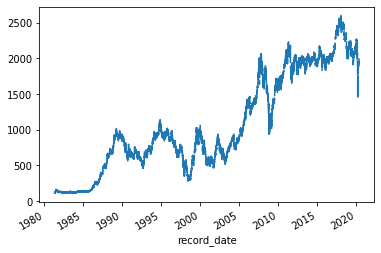

In [24]:
df_fina['kospi_price'].plot()

### 우량기업 찾아내기

In [25]:
## 우량기업 기준 : 자본 1000억 이상, 부채비율 100% 미만, 유동비율 150% 이상, 유보율 500% 이상
## 성장기업 : 매출이 평균 5% 이상 상승

In [26]:
good_comp = []
bad_comp = []

df_mean = df_merge.groupby('company_id').mean()
good_comp = df_mean[(df_mean['capital'] >= 1000) & (df_mean['debt_ratio'] <= 100) & (df_mean['capital_reserve_rate'] >= 150)]

In [27]:
bad_comp

[]

In [28]:
df_high_div

,name,company_id,dividend_yield
0,바다로19호,6362,12.148000
1,하이골드3호,6604,10.265000
2,천일고속,6787,9.612000
3,아주캐피탈,6583,9.162000
4,하이골드8호,6799,9.146667
...,...,...,...
793,청호컴넷,6501,0.000000
794,팬오션,6509,0.000000
795,한솔테크닉스,6515,0.000000
796,현대로템,6517,0.000000


### 유가와 밀접한 관계를 가지는 주식 찾기 : oil_dep

In [29]:
company = df_comp['company_id']
oil = pd.DataFrame(df_fina['oil_dbi_price'][df_fina['oil_dbi_price'].notnull()])
#oil = oil[oil.index.year == 2020]
oil_dep = []

for comp in company:
    
    get = oil.merge(df_kosp[df_kosp['company_id'] == comp], left_index = True, right_index = True)
    get = get.loc[:,['closing_price', 'oil_dbi_price']]
    get['oil_dbi_price'] = get['oil_dbi_price'].mul(get['closing_price'].mean()/50)
    corr = get.corr().iloc[0][1]
    
    if(abs(corr) > 0.5):
        oil_dep.append(comp)
        name = df_comp[df_comp['company_id'] == comp]['name'] 
        print(name, corr)
        #get.loc[:,['closing_price', 'oil_dbi_price']].plot()
        #plt.show()

2    HSD엔진
Name: name, dtype: object 0.7270164470320358
5    OCI
Name: name, dtype: object 0.6281307160235579
14    경동도시가스
Name: name, dtype: object 0.6412000296332031
20    까뮤이앤씨
Name: name, dtype: object -0.5886027385146458
28    두산
Name: name, dtype: object 0.5557392063349476
29    락앤락
Name: name, dtype: object 0.6482219034355391
41    삼영화학공업
Name: name, dtype: object 0.5972852965308765
44    선진
Name: name, dtype: object -0.5817743438365406
51    에넥스
Name: name, dtype: object -0.5042580506324073
59    인터지스
Name: name, dtype: object 0.5415108096381774
60    일동제약
Name: name, dtype: object 0.6685194041187312
76    태양금속공업
Name: name, dtype: object -0.501887182442238
82    한국조선해양
Name: name, dtype: object 0.6193298403025389
85    한국패러랠
Name: name, dtype: object 0.8490573902801495
87    한미약품
Name: name, dtype: object -0.7800377325196888
88    한세실업
Name: name, dtype: object -0.5443113416715728
96    현대건설
Name: name, dtype: object 0.7010492830145073
104    효성중공업
Name: name, dtype: object 0.

### 외국인 보유율 높은 기업 구하기 : hi_for 

0    DSR
Name: name, dtype: object 1.2322376811594211


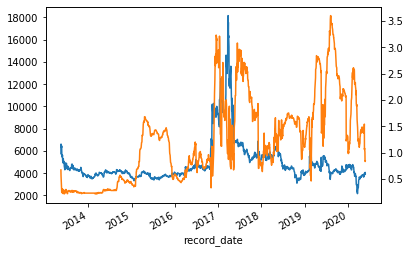

1    GS글로벌
Name: name, dtype: object 16.671544370860754


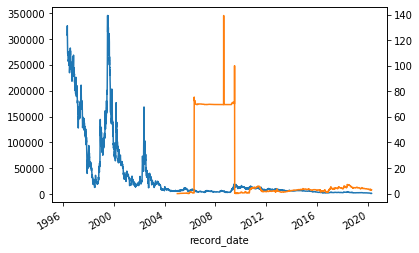

2    HSD엔진
Name: name, dtype: object 2.7784645328719764


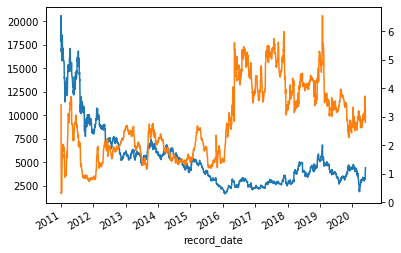

3    LG이노텍
Name: name, dtype: object 15.562256392536277


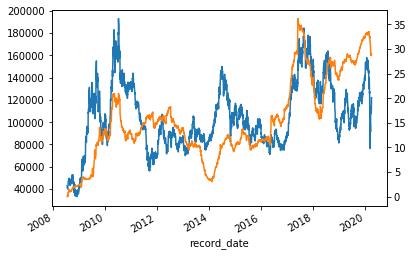

4    LS산전
Name: name, dtype: object 12.705318166831526


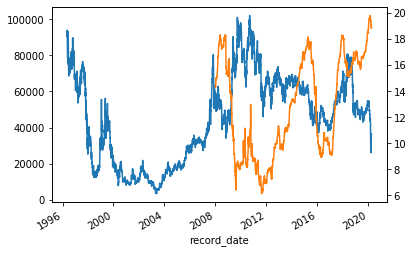

5    OCI
Name: name, dtype: object 20.897639301022107


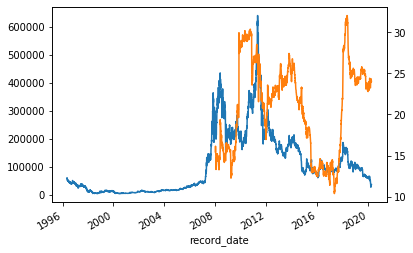

6    S&TC
Name: name, dtype: object 1.6583338832068666


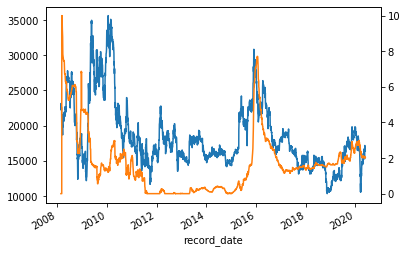

7    S&T모티브
Name: name, dtype: object 10.755752039151691


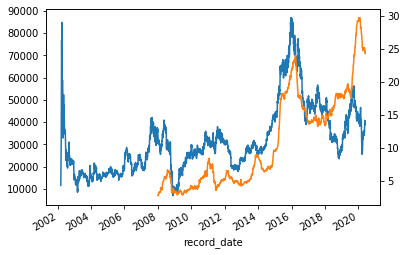

8    SK네트웍스
Name: name, dtype: object 9.23628079470199


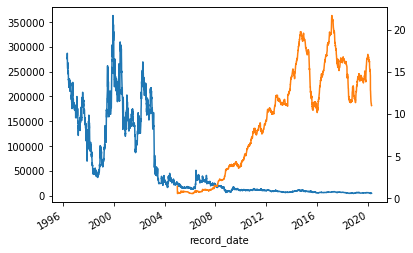

9    SK렌터카
Name: name, dtype: object 6.118476339053555


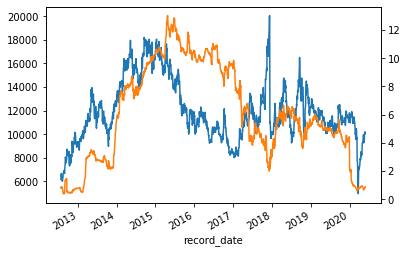

10    SK이노베이션
Name: name, dtype: object 35.38290375203918


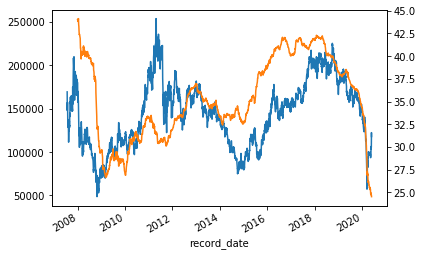

11    STX
Name: name, dtype: object 4.406456769983692


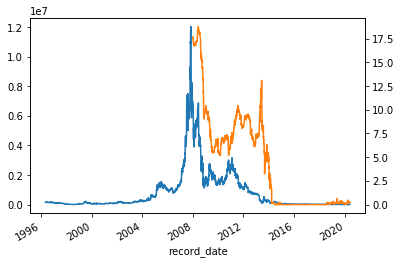

12    WISCOM
Name: name, dtype: object 4.122342577487763


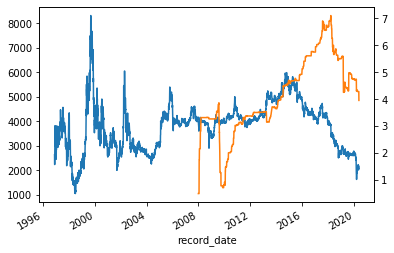

13    갤럭시아에스엠
Name: name, dtype: object 0.46720391517128884


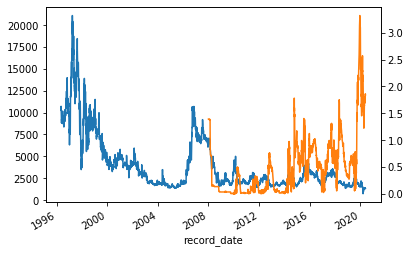

14    경동도시가스
Name: name, dtype: object 21.409018817204306


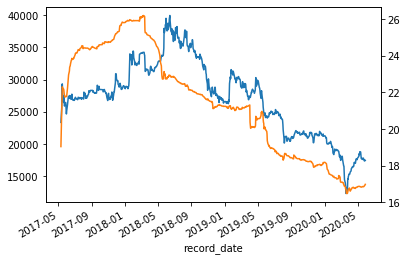

15    경동인베스트
Name: name, dtype: object 17.101663947797736


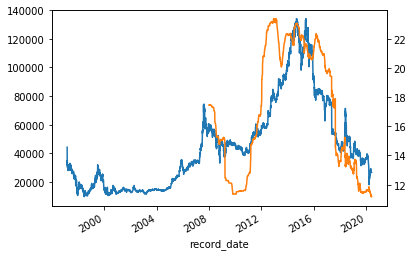

16    고려아연
Name: name, dtype: object 17.212997032640914


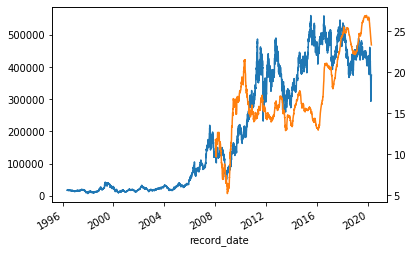

17    고려제강
Name: name, dtype: object 5.492373509933782


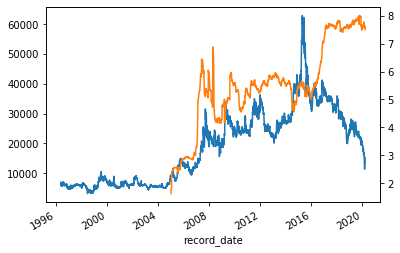

18    국보
Name: name, dtype: object 0.46006622516556206


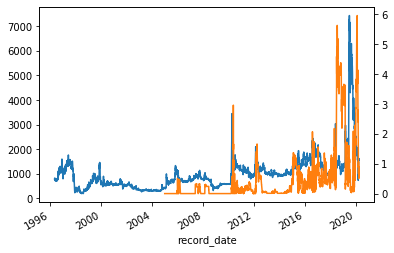

19    극동유화
Name: name, dtype: object 0.9877422512234943


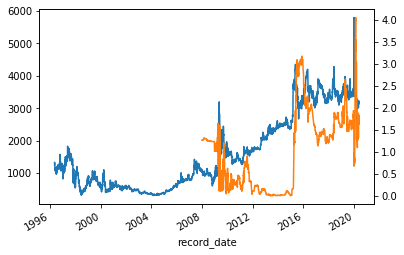

20    까뮤이앤씨
Name: name, dtype: object 0.3199575856443729


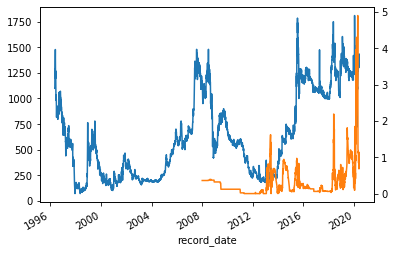

21    남양유업
Name: name, dtype: object 23.642116556291356


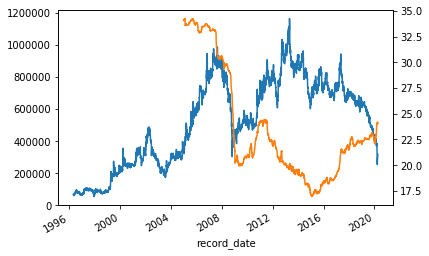

22    대영포장
Name: name, dtype: object 2.470557911908647


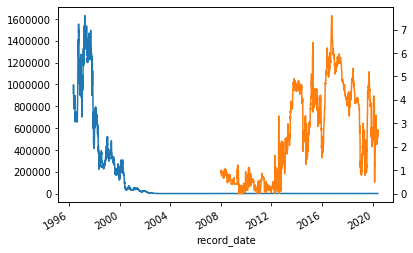

23    대원제약
Name: name, dtype: object 12.117809271523178


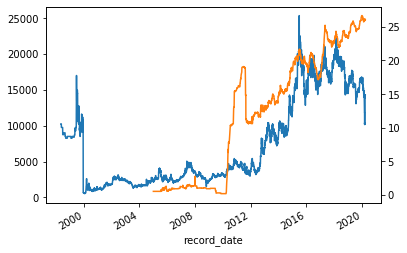

24    대한해운
Name: name, dtype: object 8.208539399934054


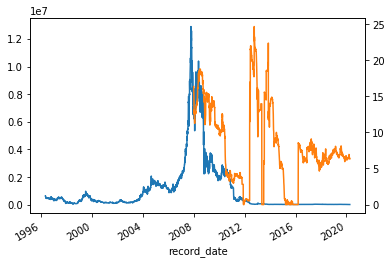

25    동남합성
Name: name, dtype: object 0.052544861337684406


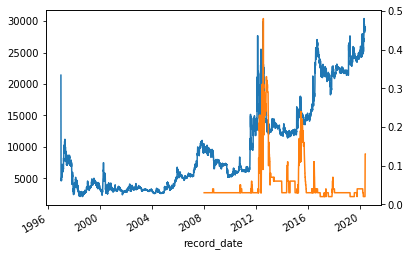

26    동아쏘시오홀딩스
Name: name, dtype: object 19.980892715231807


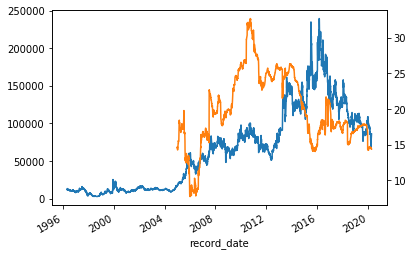

27    동양
Name: name, dtype: object 6.514974834437079


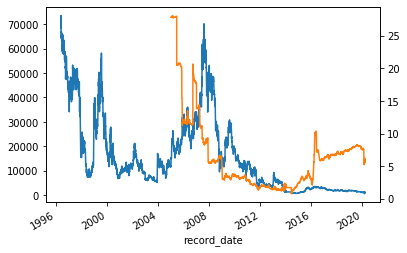

28    두산
Name: name, dtype: object 10.92495894039733


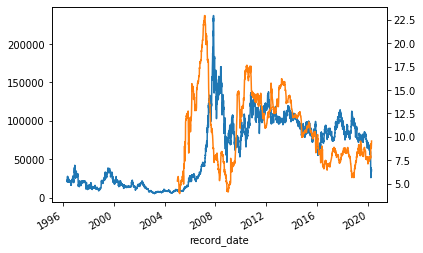

29    락앤락
Name: name, dtype: object 23.419697564807507


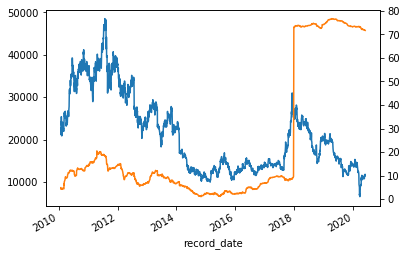

30    마니커
Name: name, dtype: object 0.7386851549755321


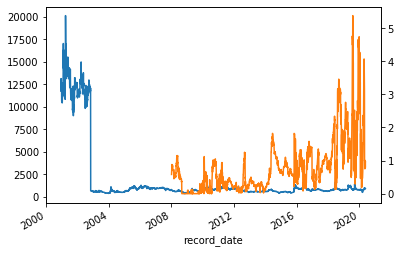

31    모두투어리츠
Name: name, dtype: object 0.21571587125416283


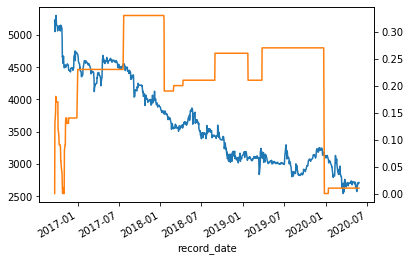

32    무림페이퍼
Name: name, dtype: object 7.168005275304955


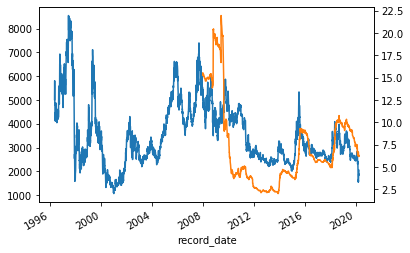

33    부국증권
Name: name, dtype: object 1.463862251655635


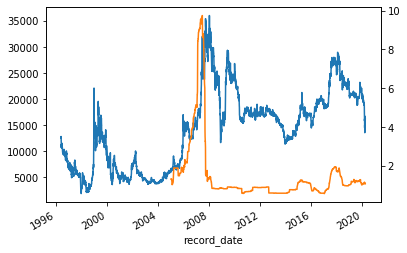

34    삼성SDI
Name: name, dtype: object 26.413379492251906


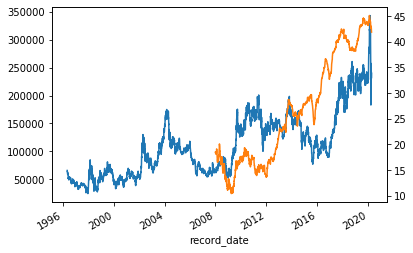

35    삼성바이오로직스
Name: name, dtype: object 9.788512110726645


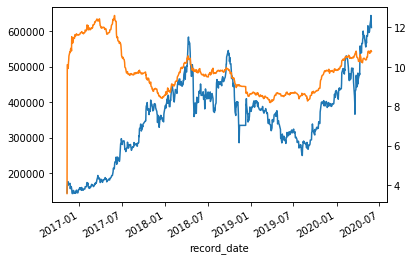

36    삼성출판사
Name: name, dtype: object 1.0380424143556268


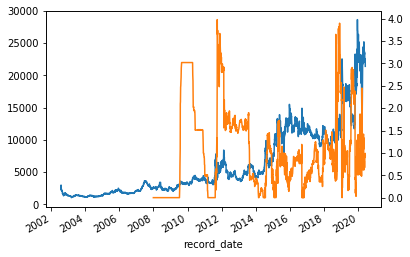

37    삼성카드
Name: name, dtype: object 12.007380097879278


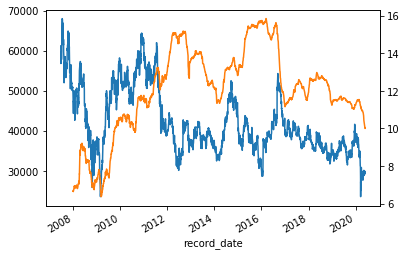

38    삼성화재해상보험
Name: name, dtype: object 52.75660397350992


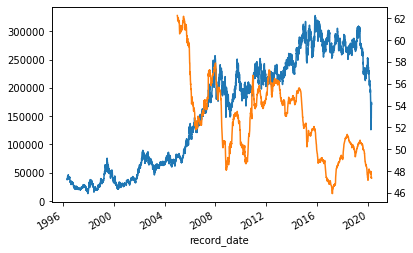

39    삼양홀딩스
Name: name, dtype: object 7.931218543046361


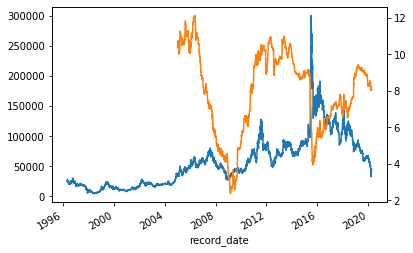

40    삼영전자공업
Name: name, dtype: object 43.08909990108798


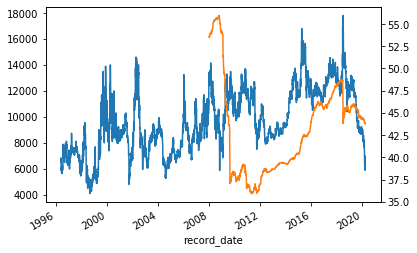

41    삼영화학공업
Name: name, dtype: object 1.7733880794701977


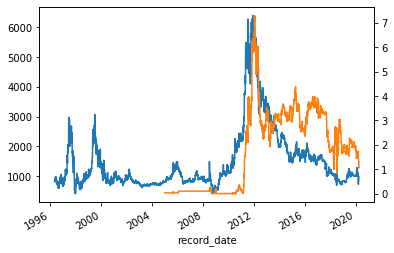

42    상상인증권
Name: name, dtype: object 5.30730860927159


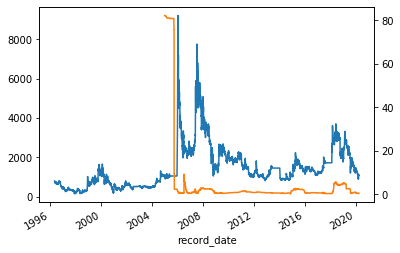

43    선도전기
Name: name, dtype: object 1.722126607319485


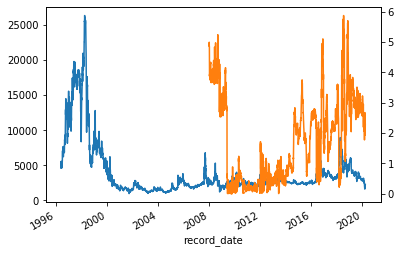

44    선진
Name: name, dtype: object 12.074921190893159


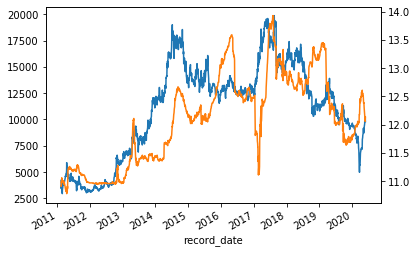

45    세원셀론텍
Name: name, dtype: object 2.2831941272430623


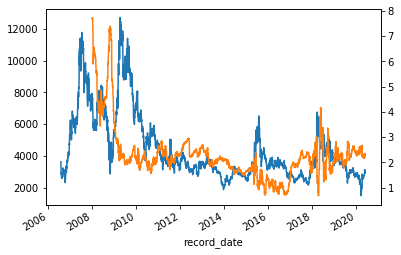

46    신성이엔지
Name: name, dtype: object 1.6515725938009826


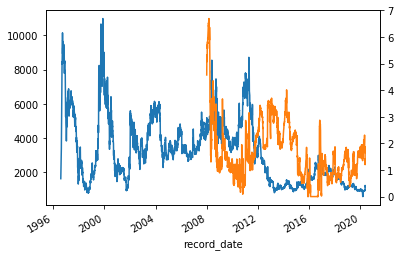

47    신송홀딩스
Name: name, dtype: object 1.1850095846645385


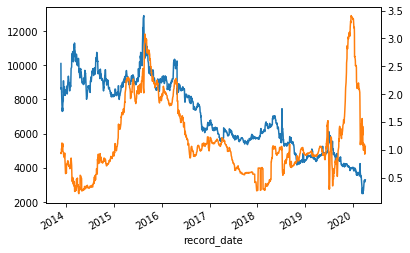

48    신풍제약
Name: name, dtype: object 2.062694942903742


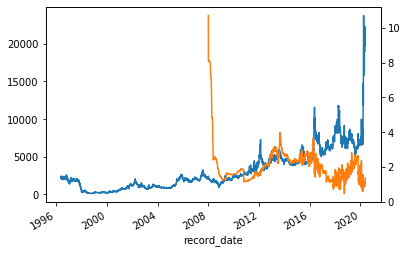

49    신한알파리츠
Name: name, dtype: object 1.5776363636363635


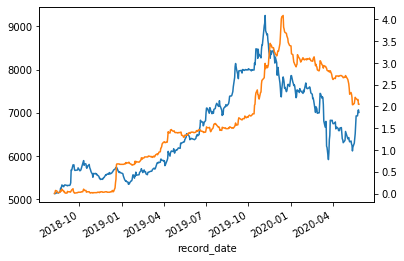

50    신한지주
Name: name, dtype: object 63.034822185970405


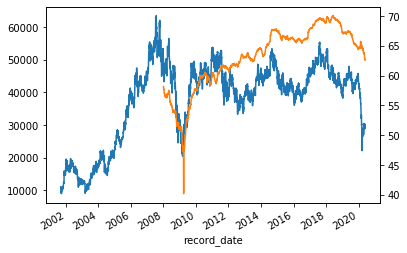

51    에넥스
Name: name, dtype: object 2.8204385097263325


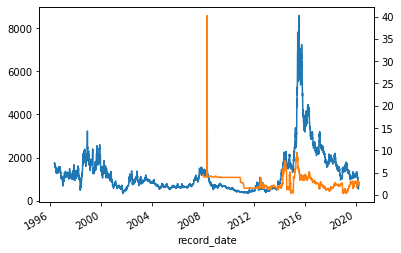

52    영화금속
Name: name, dtype: object 1.090371941272427


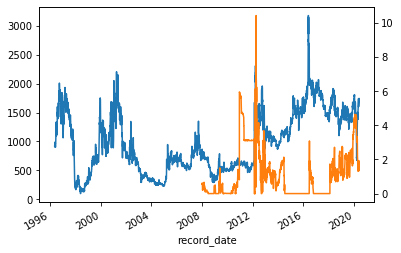

53    원림
Name: name, dtype: object 0.9349917573359486


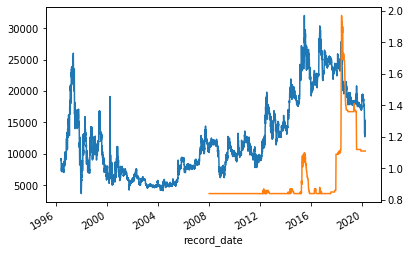

54    윌비스
Name: name, dtype: object 2.87669304319156


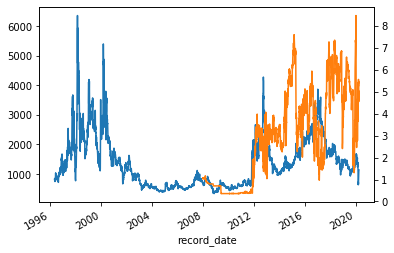

55    유나이티드
Name: name, dtype: object 10.610721044045675


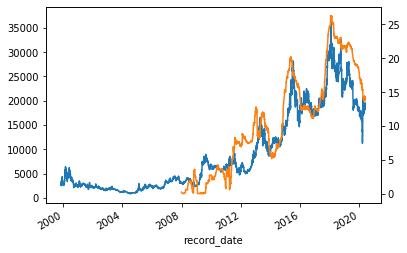

56    유니온머티리얼
Name: name, dtype: object 0.5918531202435315


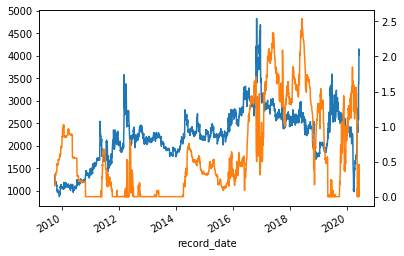

57    이리츠코크렙
Name: name, dtype: object 0.4540212765957447


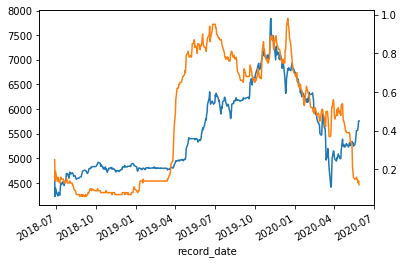

58    인지컨트롤스
Name: name, dtype: object 14.202094616639494


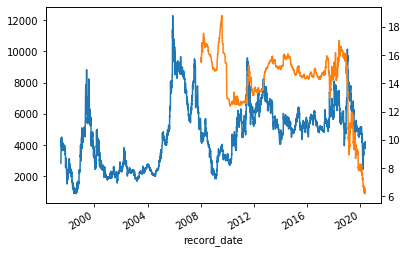

59    인터지스
Name: name, dtype: object 1.4667180722891564


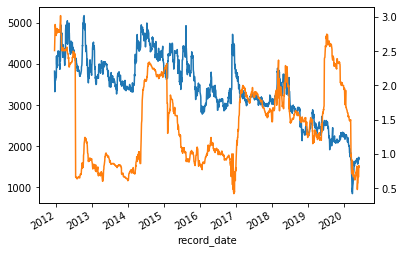

60    일동제약
Name: name, dtype: object 6.08086433260394


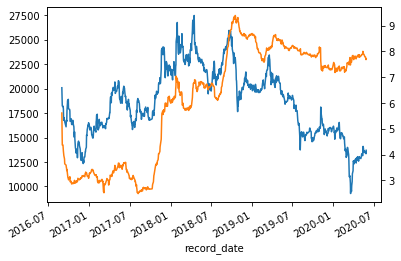

61    제일약품
Name: name, dtype: object 5.407725321888402


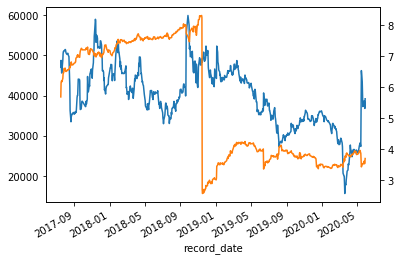

62    제일연마
Name: name, dtype: object 1.6055379836204515


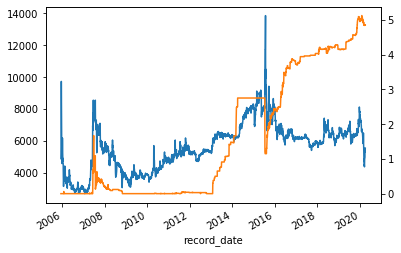

63    제일파마홀딩스
Name: name, dtype: object 11.715809271523224


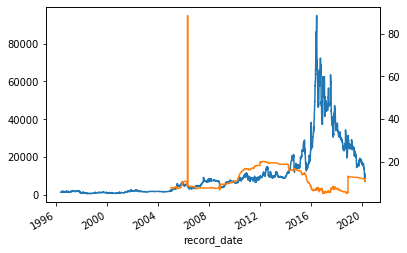

64    제주항공
Name: name, dtype: object 6.82954260089687


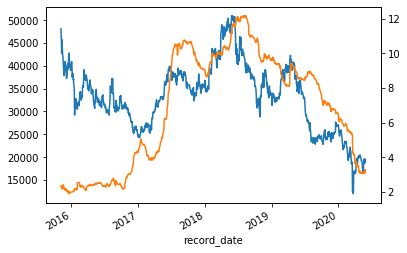

65    조흥
Name: name, dtype: object 0.04032847682119313


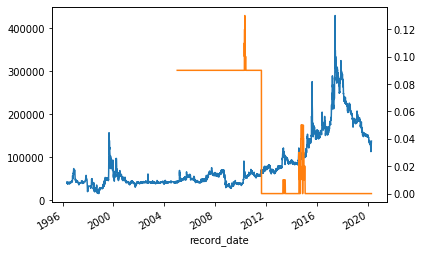

66    지역난방공사
Name: name, dtype: object 3.385119842829074


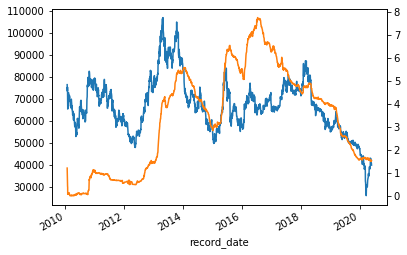

67    지코
Name: name, dtype: object 0.37724365314869795


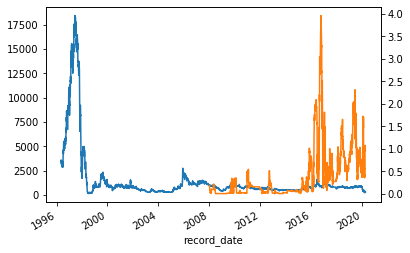

68    진도
Name: name, dtype: object 0.7260228384991754


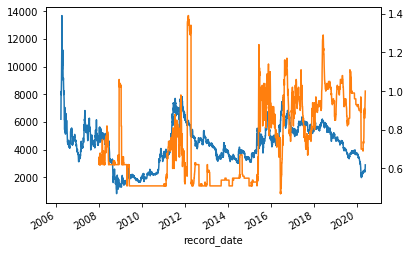

69    컨버즈
Name: name, dtype: object 2.3228994938539174


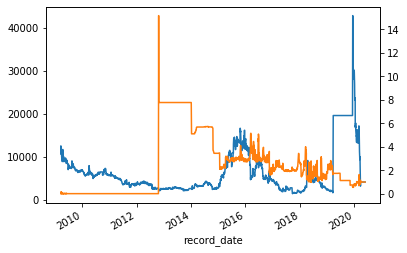

70    코리아써키트
Name: name, dtype: object 3.0576920540718815


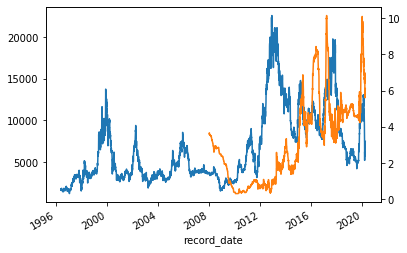

71    코스맥스
Name: name, dtype: object 25.185435215946832


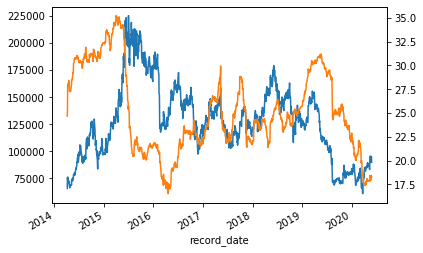

72    코오롱인더
Name: name, dtype: object 18.245267295597525


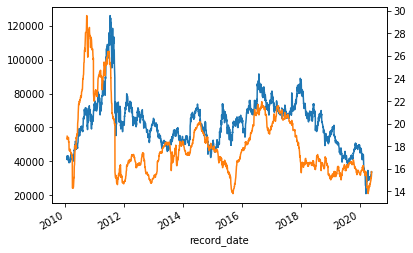

73    코오롱플라스틱
Name: name, dtype: object 0.92630049931911


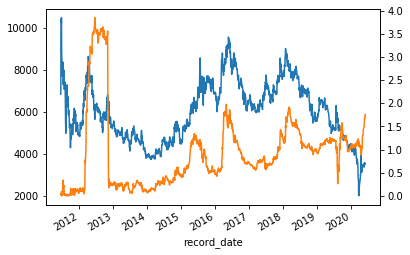

74    키다리스튜디오
Name: name, dtype: object 0.3122969004893962


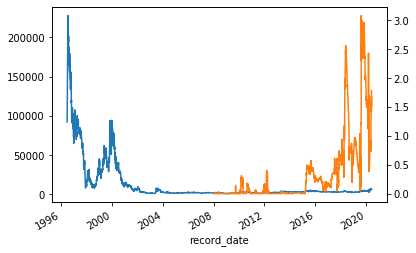

75    태광산업
Name: name, dtype: object 7.999263576158948


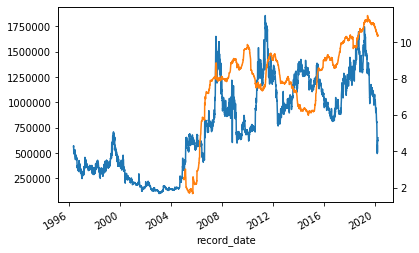

76    태양금속공업
Name: name, dtype: object 0.614834437086093


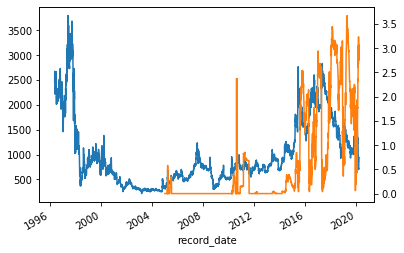

77    포스코케미칼
Name: name, dtype: object 4.73143093465675


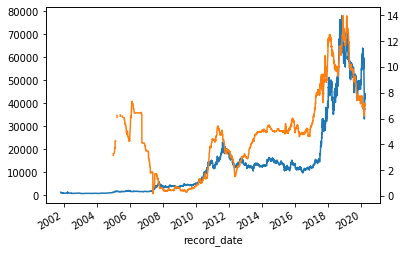

78    필룩스
Name: name, dtype: object 1.4620554649265909


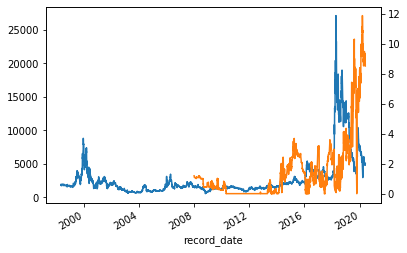

79    하나투어
Name: name, dtype: object 21.515895595432294


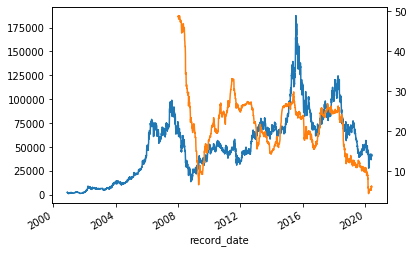

80    한국전자홀딩스
Name: name, dtype: object 4.590698977909717


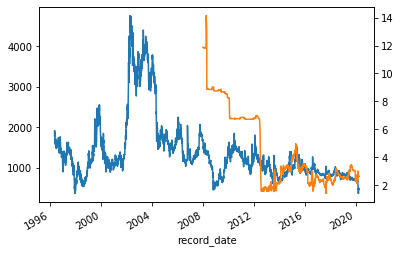

81    한국제지
Name: name, dtype: object 8.175335099337753


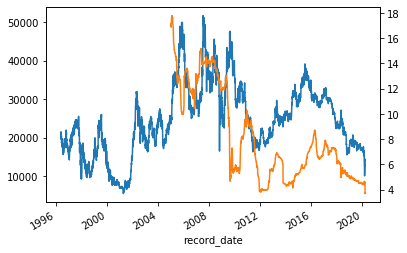

82    한국조선해양
Name: name, dtype: object 16.72673920211014


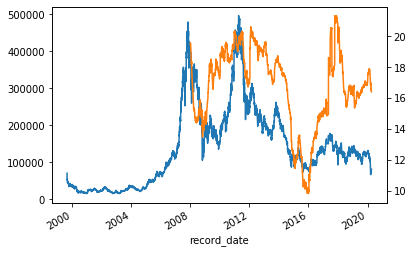

83    한국종합기술
Name: name, dtype: object 1.0131154879140551


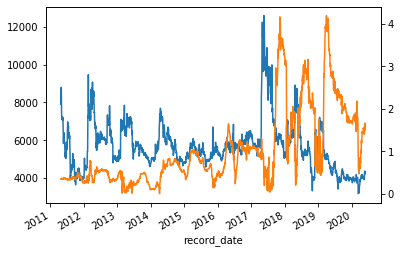

84    한국철강
Name: name, dtype: object 10.51053800763622


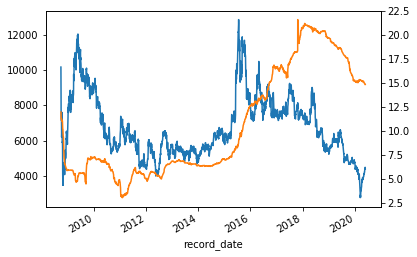

85    한국패러랠
Name: name, dtype: object 0.0007405281285878307


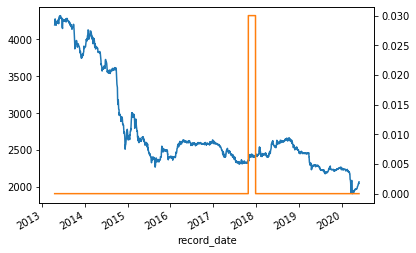

86    한라홀딩스
Name: name, dtype: object 14.821898785425146


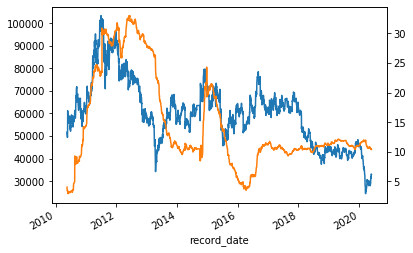

87    한미약품
Name: name, dtype: object 12.549743801652898


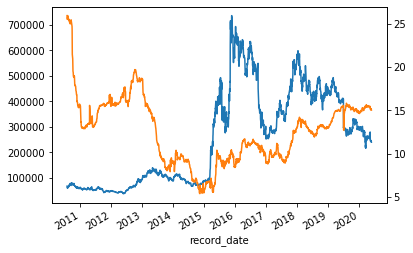

88    한세실업
Name: name, dtype: object 5.985038002171545


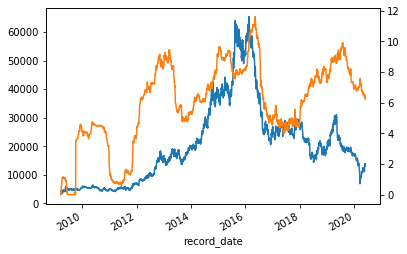

89    한솔로지스틱스
Name: name, dtype: object 4.3637157929442845


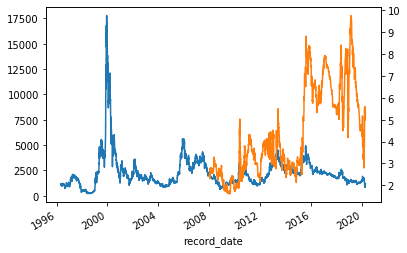

90    한일철강
Name: name, dtype: object 2.047867549668876


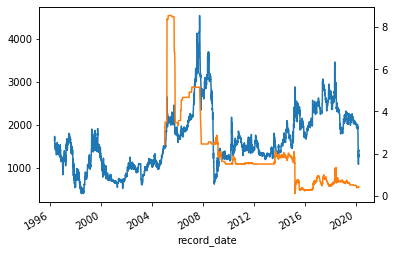

91    한일현대시멘트
Name: name, dtype: object 1.282274975272013


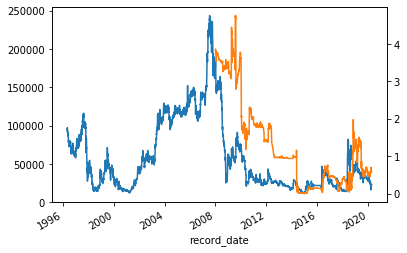

92    한진
Name: name, dtype: object 9.754826490066224


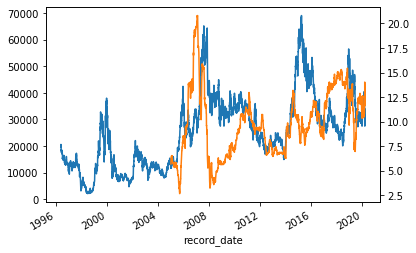

93    한창제지
Name: name, dtype: object 1.3670227497527223


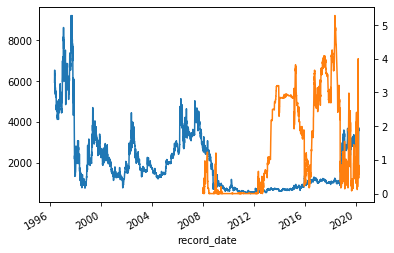

94    한화갤러리아타임월드
Name: name, dtype: object 5.926428336079084


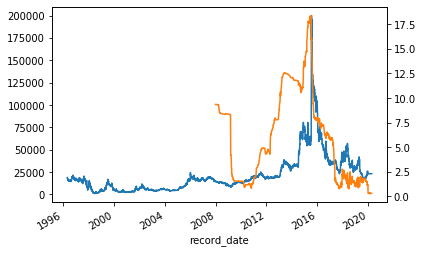

95    한화생명
Name: name, dtype: object 14.35329753381061


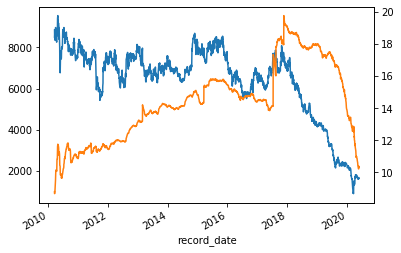

96    현대건설
Name: name, dtype: object 20.58759470198675


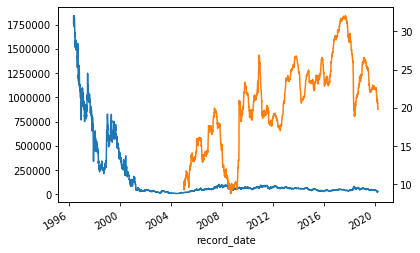

97    현대건설기계
Name: name, dtype: object 9.836635388739944


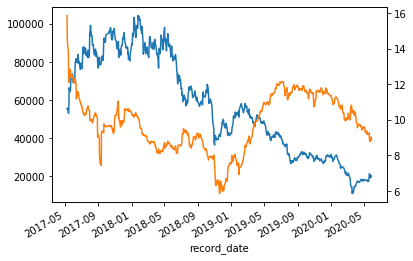

98    현대모비스
Name: name, dtype: object 46.319840130505796


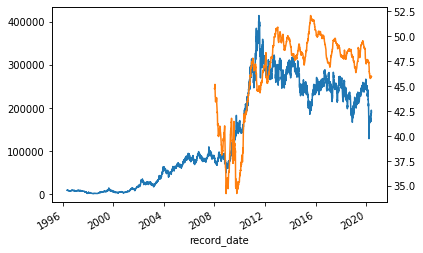

99    현대비앤지스틸
Name: name, dtype: object 4.504225165562914


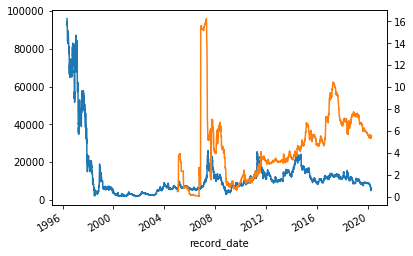

100    현대엘리베이터
Name: name, dtype: object 29.10656443719414


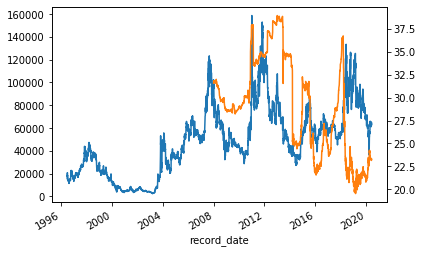

101    현대홈쇼핑
Name: name, dtype: object 28.25974884889077


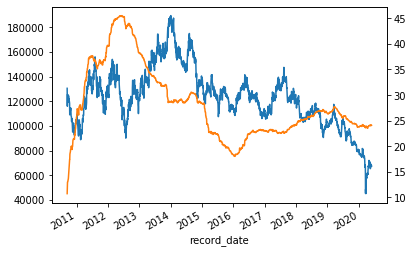

102    호전실업
Name: name, dtype: object 0.6560493827160507


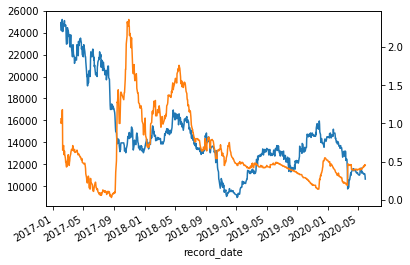

103    호텔신라
Name: name, dtype: object 23.418137157929458


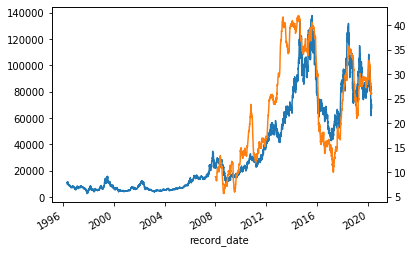

104    효성중공업
Name: name, dtype: object 8.138908296943233


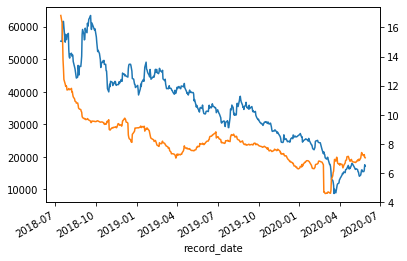

105    BNK금융지주
Name: name, dtype: object 53.991773835920156


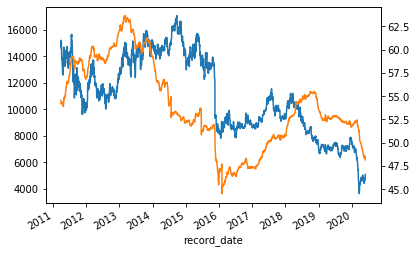

106    CJ CGV
Name: name, dtype: object 16.710440456769987


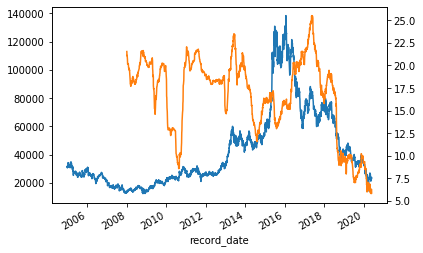

107    CS홀딩스
Name: name, dtype: object 0.6562225165562922


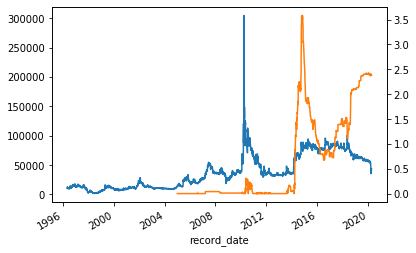

108    GKL
Name: name, dtype: object 16.577993827160533


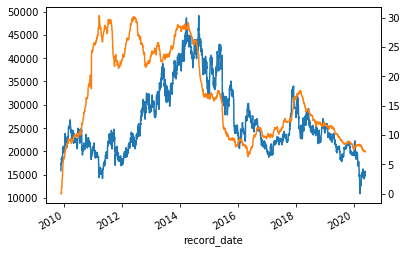

109    GS건설
Name: name, dtype: object 27.720438509726435


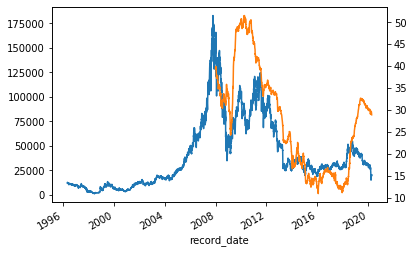

110    KB금융
Name: name, dtype: object 64.40409328228337


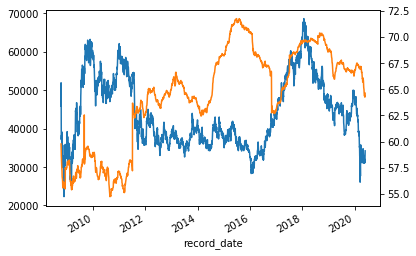

111    LG디스플레이
Name: name, dtype: object 29.622166394779782


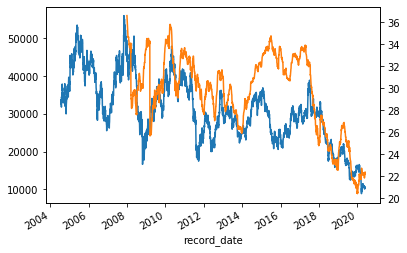

112    SG충방
Name: name, dtype: object 0.37497218543046307


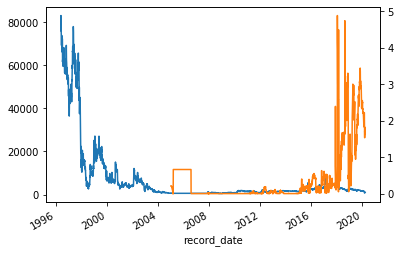

113    SK
Name: name, dtype: object 20.874218629715184


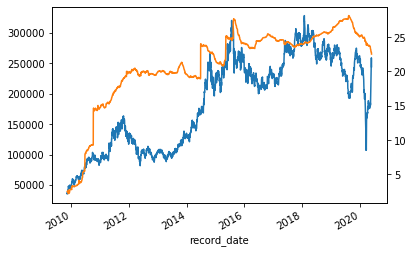

114    SKC
Name: name, dtype: object 9.07571615008157


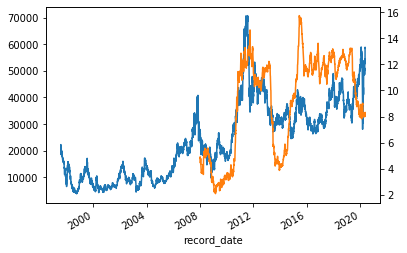

115    SPC삼립
Name: name, dtype: object 2.3425387405209306


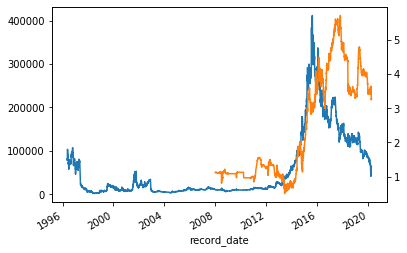

116    금강공업
Name: name, dtype: object 1.4665644371941287


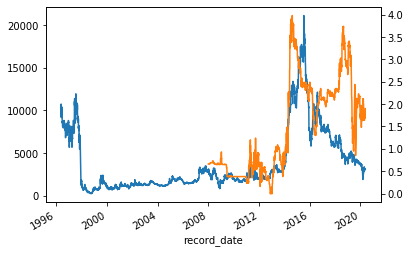

117    금호산업
Name: name, dtype: object 7.0255576158940665


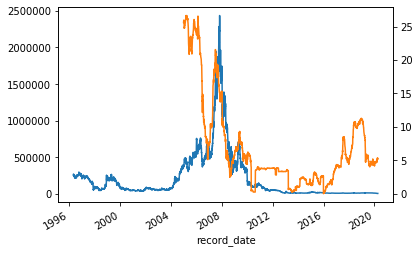

118    금호전기
Name: name, dtype: object 7.680235761589437


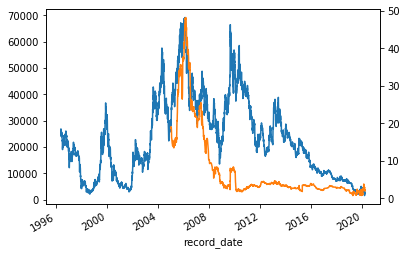

119    기업은행
Name: name, dtype: object 16.764368678629623


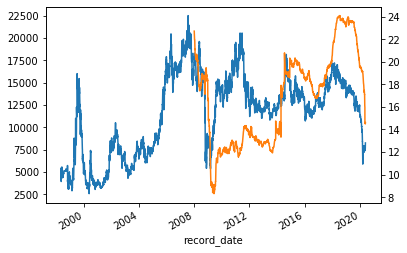

120    남선알미늄
Name: name, dtype: object 1.8640883613583878


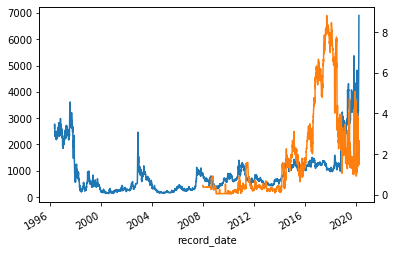

121    남성
Name: name, dtype: object 0.22998145695364236


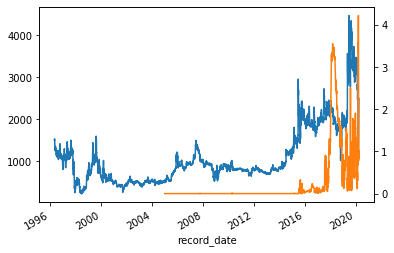

122    대구백화점
Name: name, dtype: object 14.29807781074841


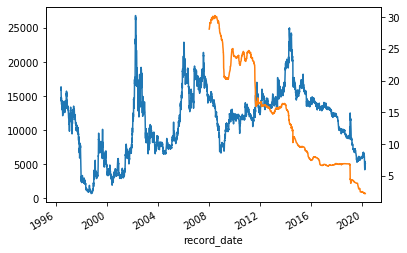

123    대신증권
Name: name, dtype: object 24.50008741721854


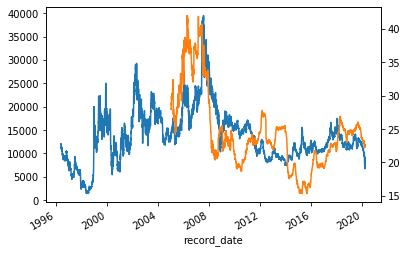

124    대우건설
Name: name, dtype: object 8.637399673735729


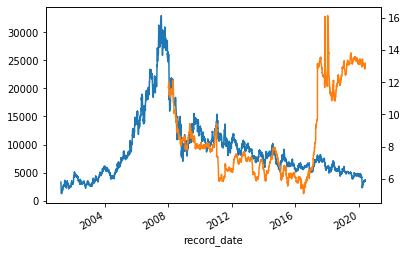

125    대한방직
Name: name, dtype: object 1.0018781456953858


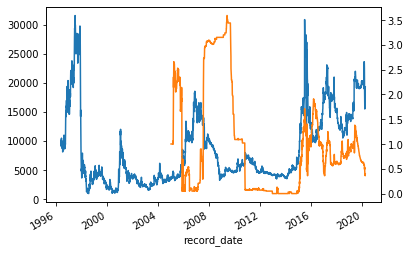

126    대한제강
Name: name, dtype: object 9.352818923327893


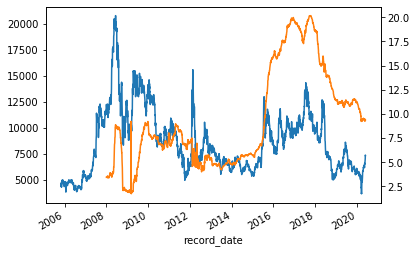

127    대한제당
Name: name, dtype: object 4.9469165562913675


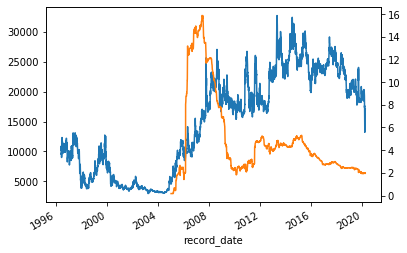

128    대현
Name: name, dtype: object 3.7183001631321395


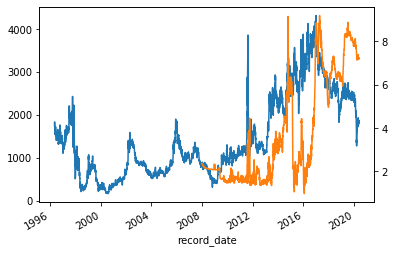

129    덕양산업
Name: name, dtype: object 29.297582381729345


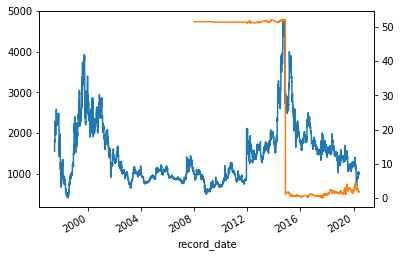

130    동방아그로
Name: name, dtype: object 28.22346635883887


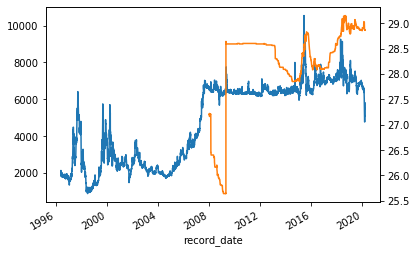

131    동성코퍼레이션
Name: name, dtype: object 4.46481858257036


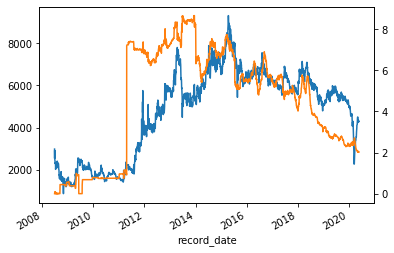

132    동양생명
Name: name, dtype: object 46.021338672768756


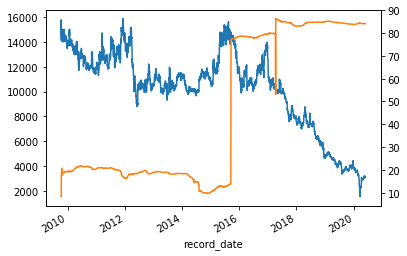

133    동원금속
Name: name, dtype: object 0.7793344208809145


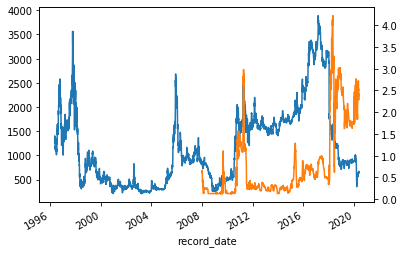

134    두산인프라코어
Name: name, dtype: object 14.007216965742252


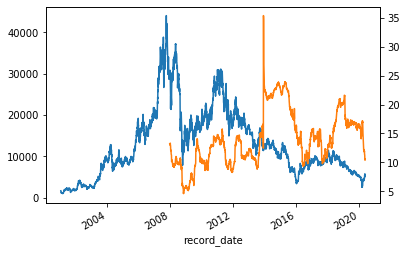

135    두올
Name: name, dtype: object 2.6785790598290613


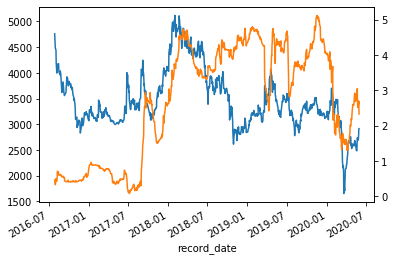

136    디씨엠
Name: name, dtype: object 1.9531158238173043


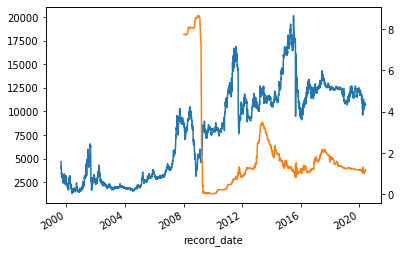

137    롯데손해보험
Name: name, dtype: object 7.045372185430423


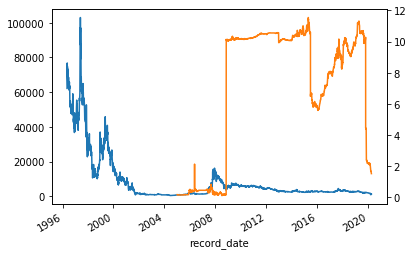

138    롯데칠성음료
Name: name, dtype: object 26.388630463576153


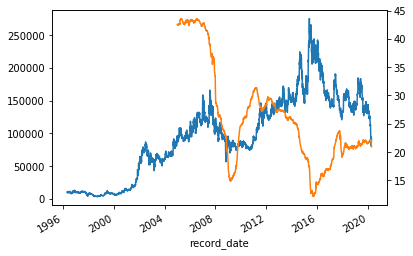

139    미원홀딩스
Name: name, dtype: object 1.7505473532589042


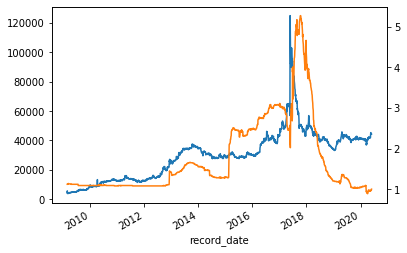

140    백산
Name: name, dtype: object 2.542453507340947


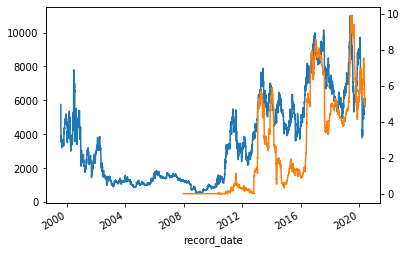

141    범양건영
Name: name, dtype: object 9.190619867549458


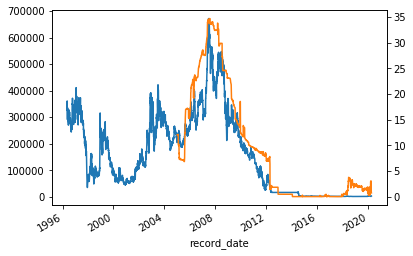

142    보락
Name: name, dtype: object 0.6470039735099348


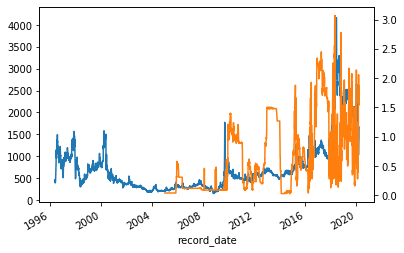

143    보해양조
Name: name, dtype: object 1.3204344370860963


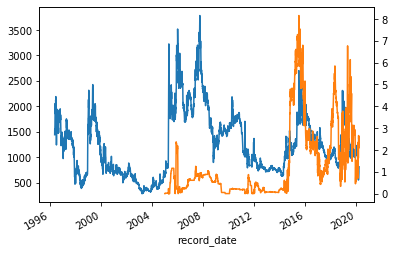

144    사조대림
Name: name, dtype: object 0.7373086092715151


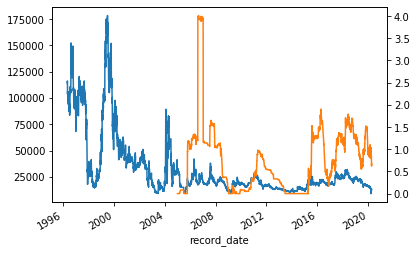

145    사조동아원
Name: name, dtype: object 0.7438740520936375


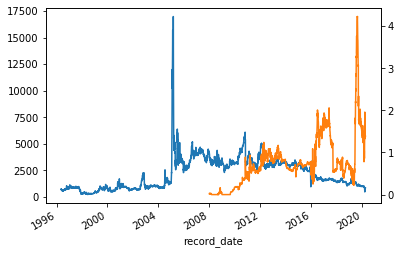

146    사조씨푸드
Name: name, dtype: object 2.038486875965004


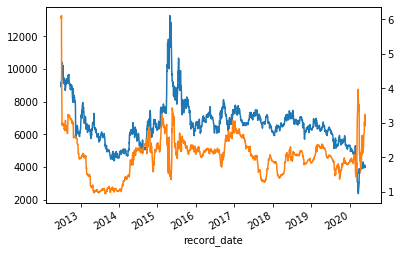

147    삼부토건
Name: name, dtype: object 6.3256344370860536


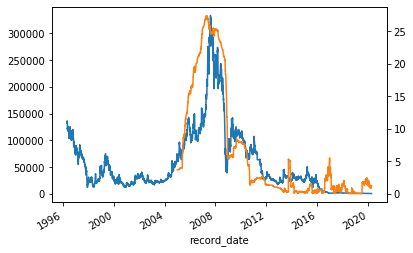

148    삼양식품
Name: name, dtype: object 1.4399178807947026


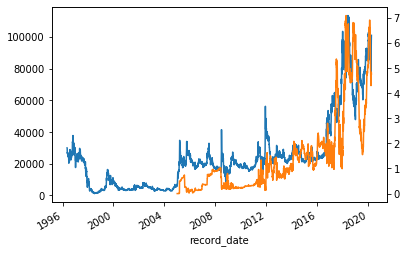

149    삼원강재
Name: name, dtype: object 0.753060661764693


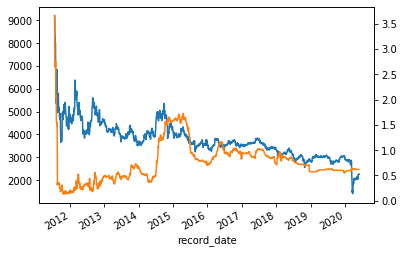

150    삼호
Name: name, dtype: object 3.561713907284835


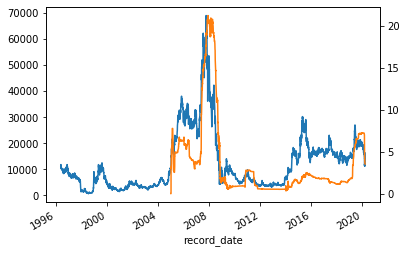

151    서원
Name: name, dtype: object 1.0895595432300145


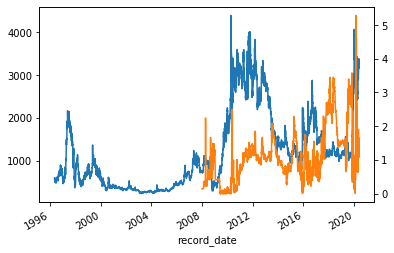

152    세방
Name: name, dtype: object 8.832797350993387


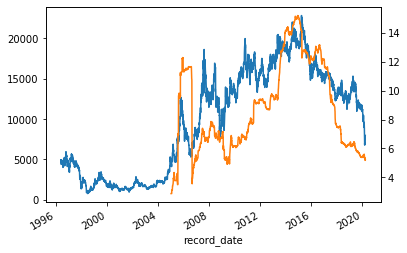

153    세아홀딩스
Name: name, dtype: object 1.2023882544861288


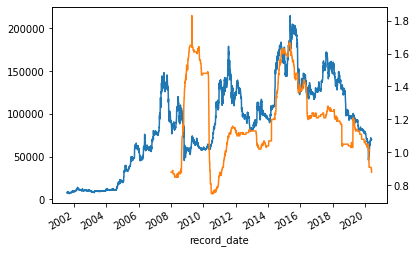

154    세이브존I&C
Name: name, dtype: object 2.6387275693311585


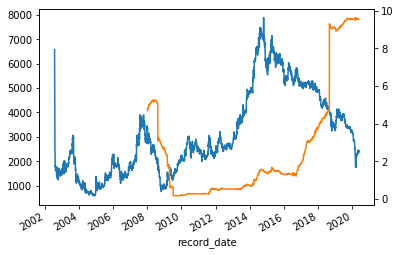

155    신세계인터내셔날
Name: name, dtype: object 3.5304628780934943


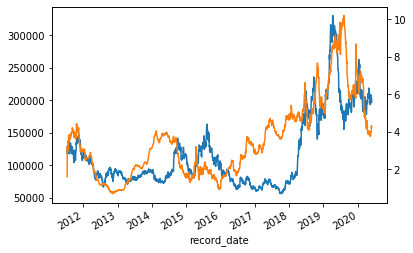

156    신영와코루
Name: name, dtype: object 26.161572700296865


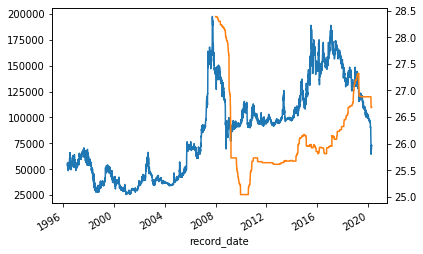

157    신일산업
Name: name, dtype: object 1.2268609271523152


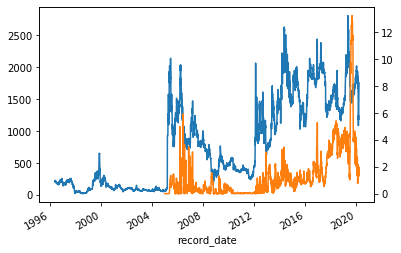

158    써니전자
Name: name, dtype: object 0.9625801324503279


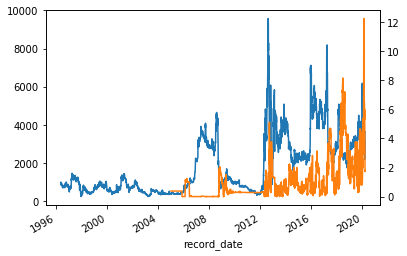

159    아시아나항공
Name: name, dtype: object 7.051445822454313


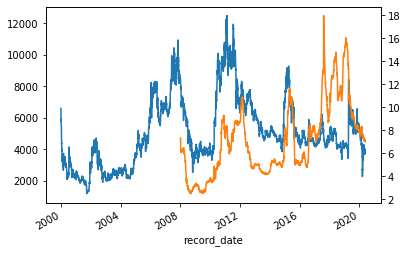

160    아이마켓코리아
Name: name, dtype: object 10.39041735537191


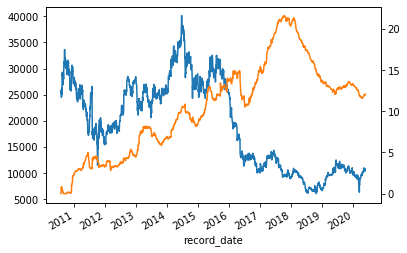

161    아이에이치큐
Name: name, dtype: object 3.328508609271508


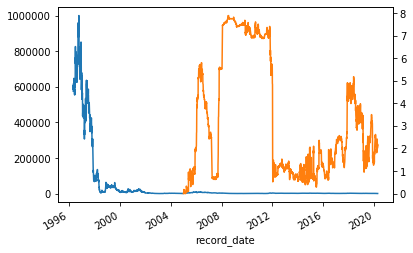

162    엔씨소프트
Name: name, dtype: object 36.50581402936376


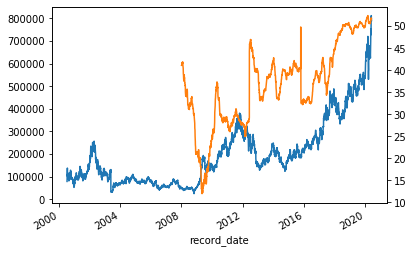

163    영보화학
Name: name, dtype: object 51.841305057096456


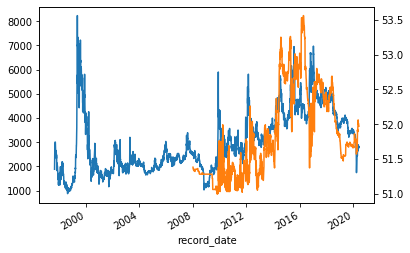

164    영원무역
Name: name, dtype: object 28.22822538375142


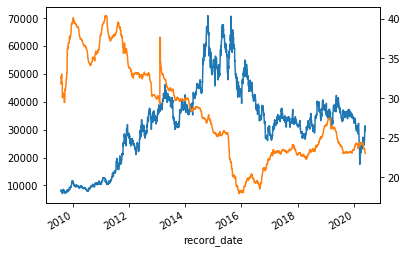

165    영진약품
Name: name, dtype: object 1.5184291390728488


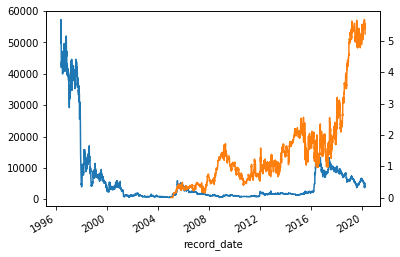

166    영풍
Name: name, dtype: object 2.7964238410596116


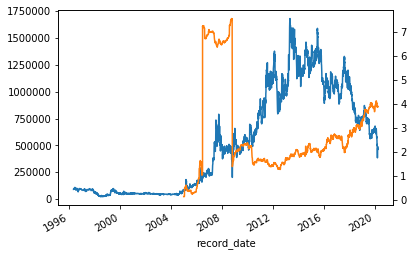

167    예스코홀딩스
Name: name, dtype: object 13.540789559543237


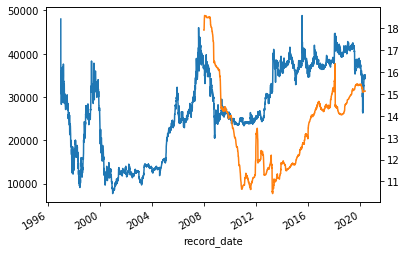

168    유성기업
Name: name, dtype: object 11.125147019867576


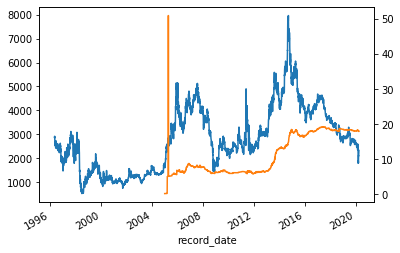

169    유유제약
Name: name, dtype: object 7.072996026490066


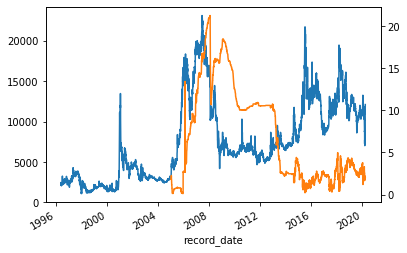

170    유한양행
Name: name, dtype: object 27.549260927152346


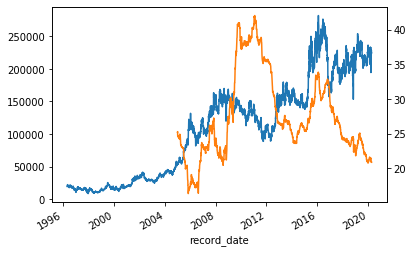

171    이수화학
Name: name, dtype: object 4.699762611275964


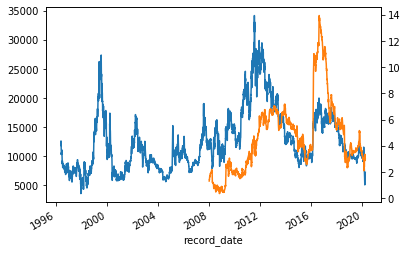

172    이스타코
Name: name, dtype: object 1.219699836867863


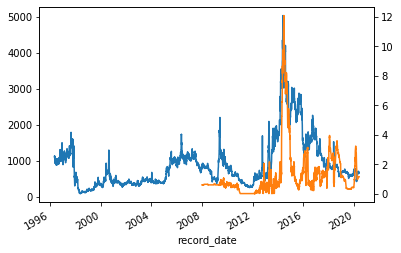

173    일정실업
Name: name, dtype: object 5.238664688427181


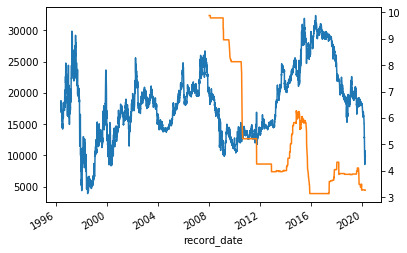

174    자이에스앤디
Name: name, dtype: object 1.0368382352941177


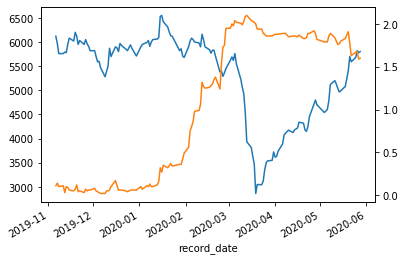

175    조선선재
Name: name, dtype: object 1.797558277360732


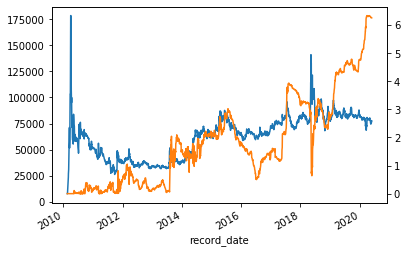

176    종근당
Name: name, dtype: object 10.706141235813364


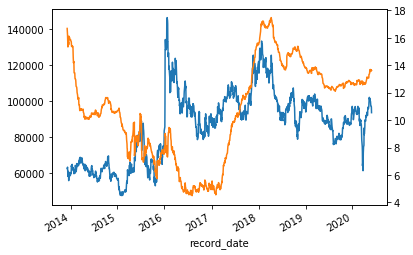

177    진에어
Name: name, dtype: object 6.269568106312294


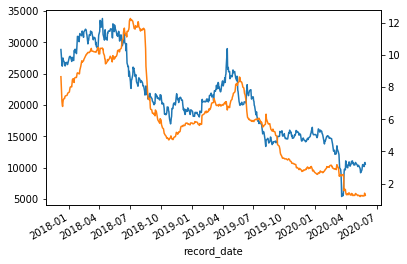

178    케이티
Name: name, dtype: object 46.59733115823821


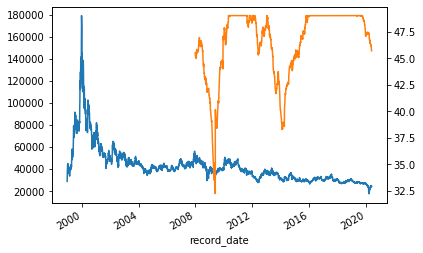

179    코스모화학
Name: name, dtype: object 1.4026913907284813


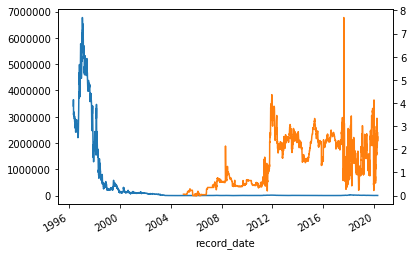

180    코아스
Name: name, dtype: object 2.4708972267536713


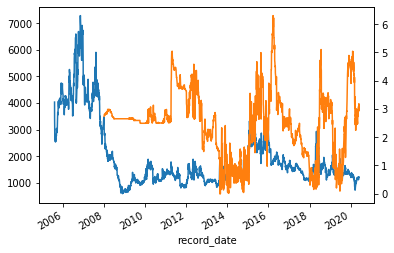

181    쿠쿠홀딩스
Name: name, dtype: object 8.07869290231904


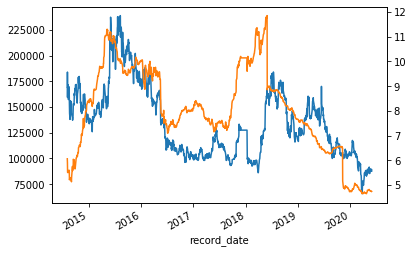

182    큐로
Name: name, dtype: object 1.1784371941272427


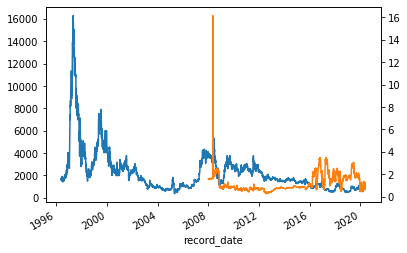

183    태경화학
Name: name, dtype: object 1.5367293109132871


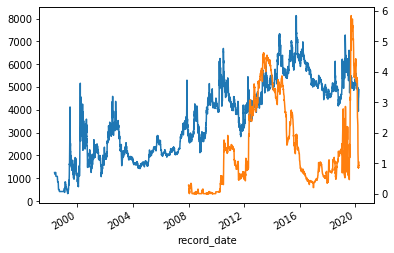

184    태영건설
Name: name, dtype: object 7.959287833827871


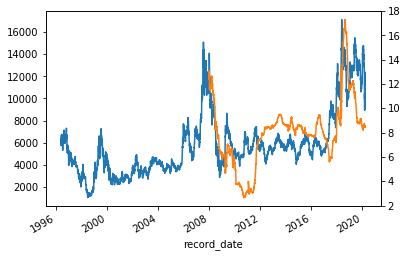

185    티비에이치글로벌
Name: name, dtype: object 21.954306688417656


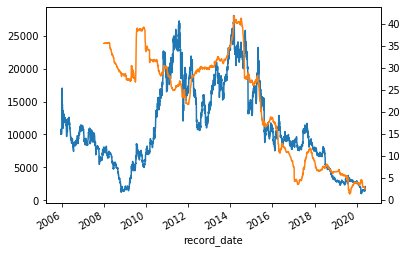

186    티웨이항공
Name: name, dtype: object 0.5391235955056184


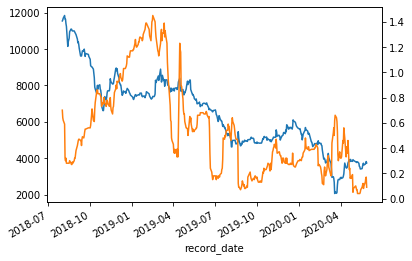

187    하이트론씨스템즈
Name: name, dtype: object 0.8794290375203764


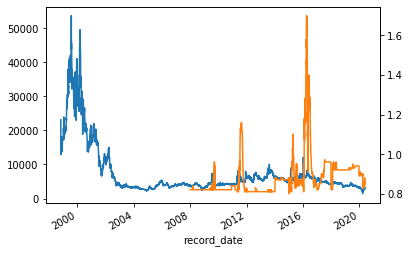

188    하이트진로
Name: name, dtype: object 14.00558652729385


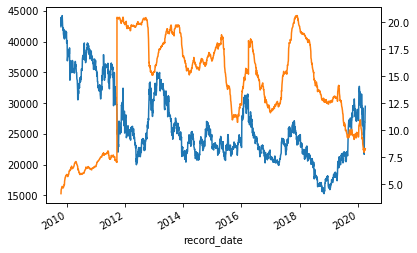

189    한국금융지주
Name: name, dtype: object 40.65152691680259


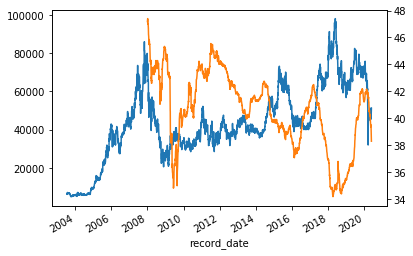

190    한국테크놀로지그룹
Name: name, dtype: object 25.15060132450327


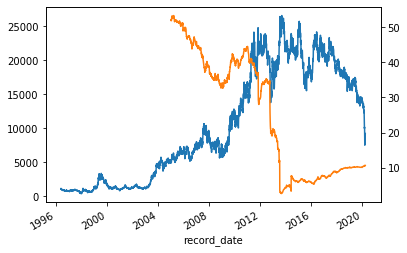

191    한국토지신탁
Name: name, dtype: object 5.414584013050566


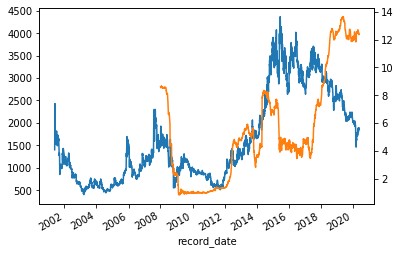

192    한일시멘트
Name: name, dtype: object 6.11162895927603


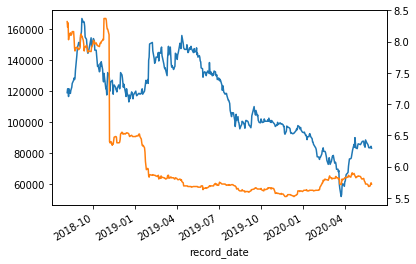

193    한전KPS
Name: name, dtype: object 14.233004893964099


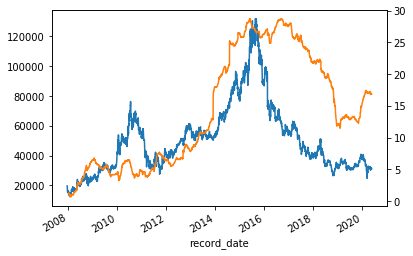

194    한화시스템
Name: name, dtype: object 1.458625954198474


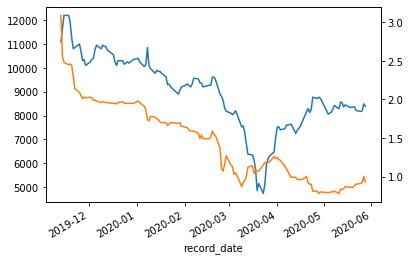

195    해태제과식품
Name: name, dtype: object 0.8365927419354827


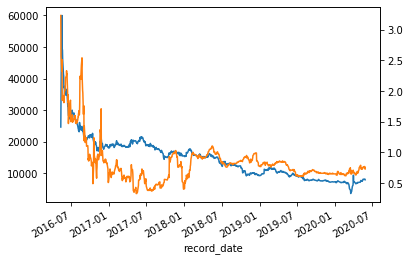

196    현대중공업지주
Name: name, dtype: object 20.15073726541555


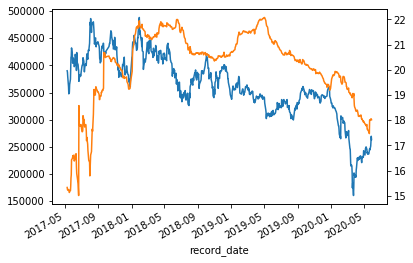

197    화승인더스트리
Name: name, dtype: object 6.468018463567418


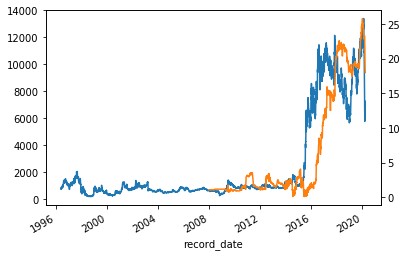

198    화천기공
Name: name, dtype: object 10.51555496688747


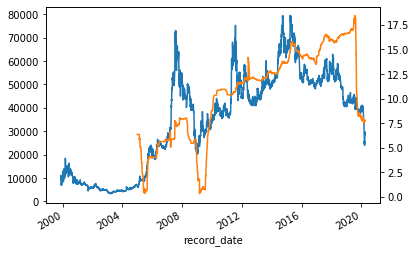

199    환인제약
Name: name, dtype: object 21.183353996737427


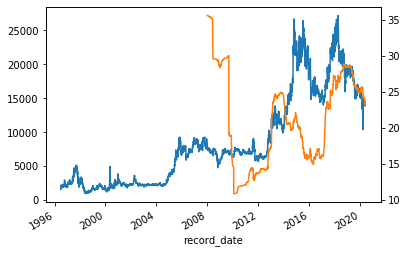

200    효성
Name: name, dtype: object 21.100964238410572


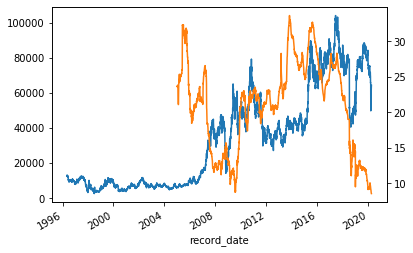

201    효성티앤씨
Name: name, dtype: object 11.988908296943242


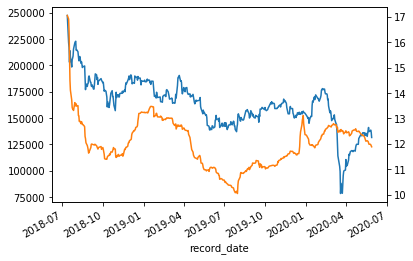

202    BGF
Name: name, dtype: object 20.11020297699597


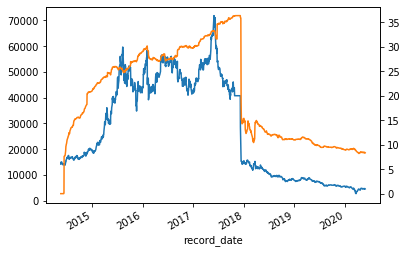

203    CJ
Name: name, dtype: object 19.58457218543048


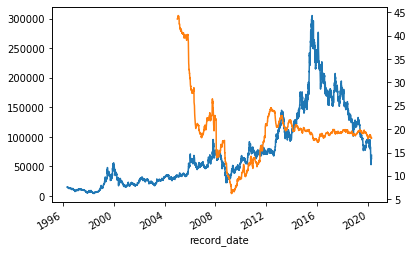

204    HDC현대산업개발
Name: name, dtype: object 30.54306250000002


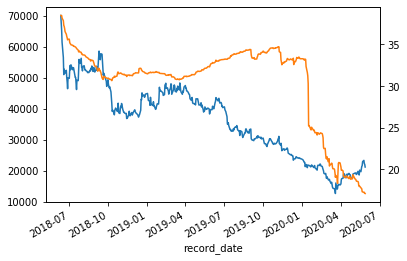

205    KPX케미칼
Name: name, dtype: object 30.122277324632915


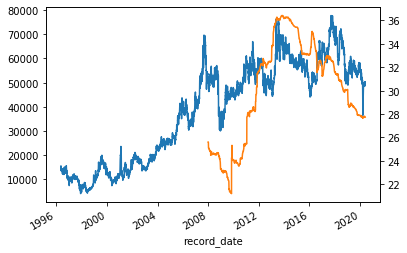

206    LG상사
Name: name, dtype: object 11.387517880794684


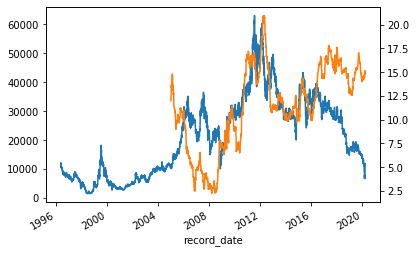

207    SBS
Name: name, dtype: object 0.0


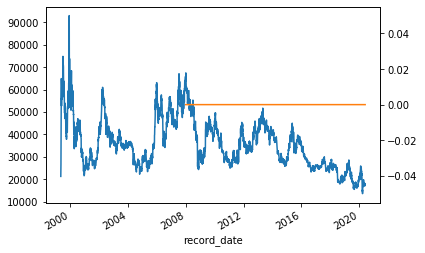

208    SBS미디어홀딩스
Name: name, dtype: object 2.99341860465117


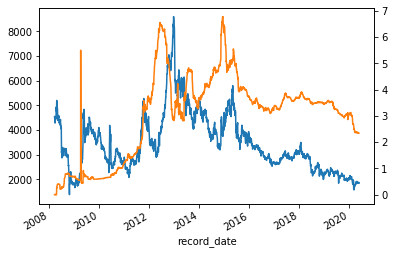

209    SK텔레콤
Name: name, dtype: object 44.27966068515513


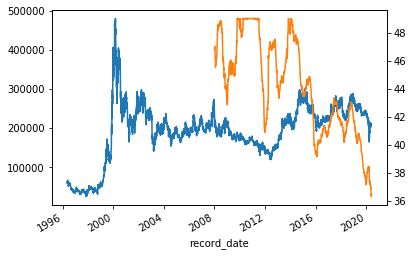

210    YG PLUS
Name: name, dtype: object 18.23582707993484


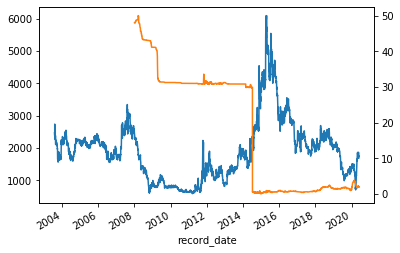

211    강원랜드
Name: name, dtype: object 29.589513866231595


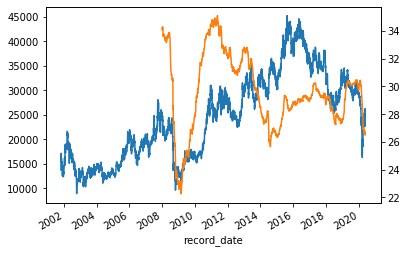

212    고려개발
Name: name, dtype: object 3.5711337748344576


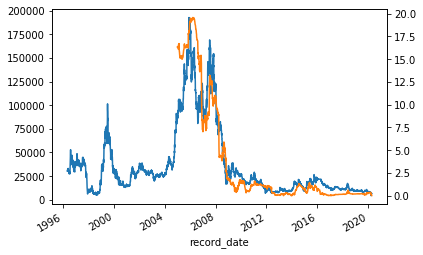

213    국동
Name: name, dtype: object 0.957033112582778


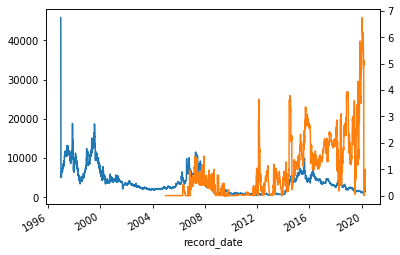

214    국제약품
Name: name, dtype: object 2.0625986754966905


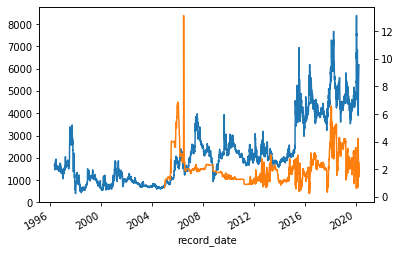

215    금양
Name: name, dtype: object 0.5977377483443735


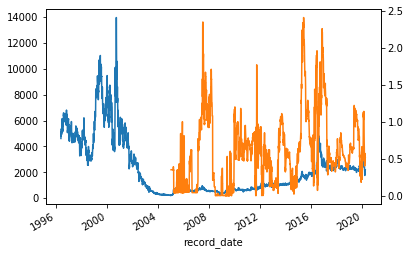

216    금호에이치티
Name: name, dtype: object 10.249955035971245


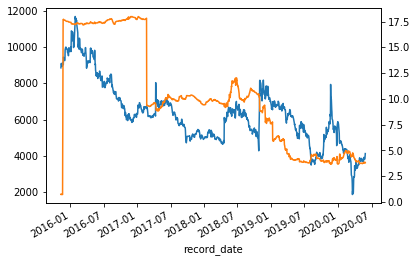

217    넥센타이어
Name: name, dtype: object 10.279011920529788


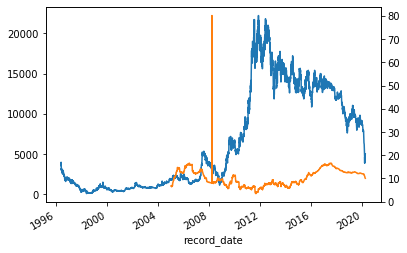

218    녹십자홀딩스
Name: name, dtype: object 3.699663576158934


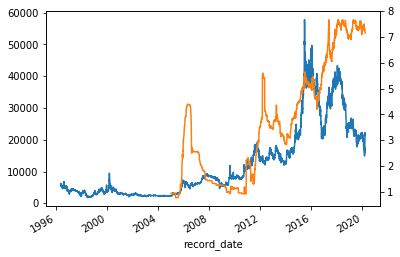

219    농심홀딩스
Name: name, dtype: object 8.31819249592173


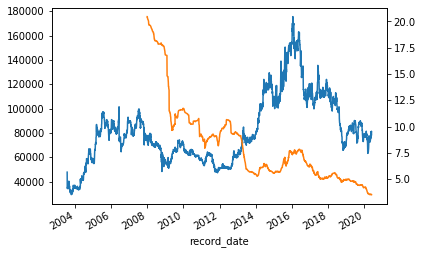

220    다스코
Name: name, dtype: object 0.7882577487765089


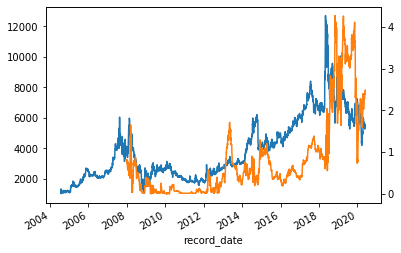

221    대웅제약
Name: name, dtype: object 8.440636215334433


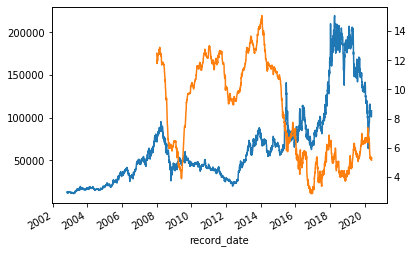

222    대한유화
Name: name, dtype: object 13.110797889878002


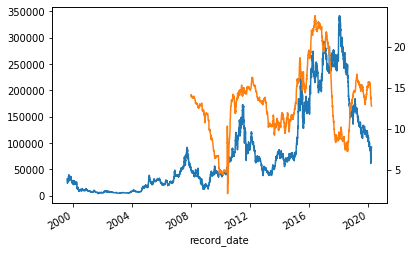

223    더블유게임즈
Name: name, dtype: object 9.625828111011643


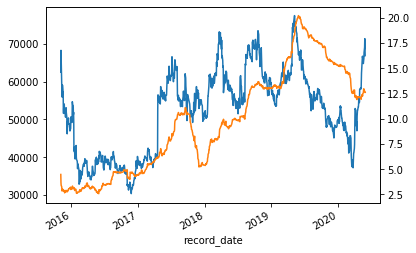

224    더존비즈온
Name: name, dtype: object 15.28901794453507


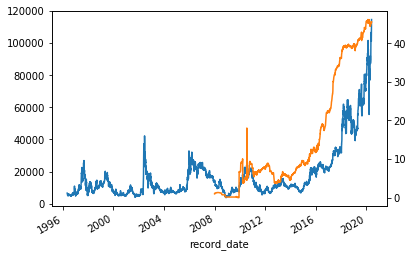

225    덕성
Name: name, dtype: object 0.9752211920529809


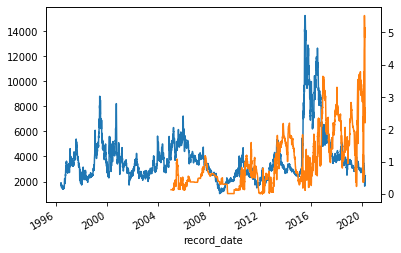

226    동부제철
Name: name, dtype: object 4.038965742251252


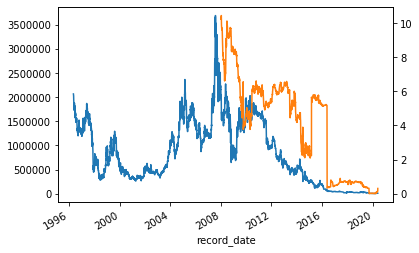

227    동서
Name: name, dtype: object 8.954730831973905


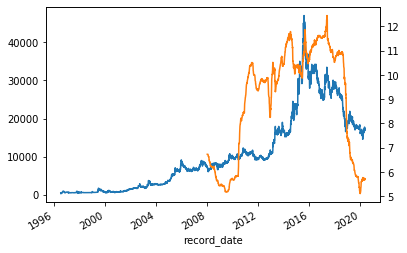

228    동원산업
Name: name, dtype: object 4.662393669634025


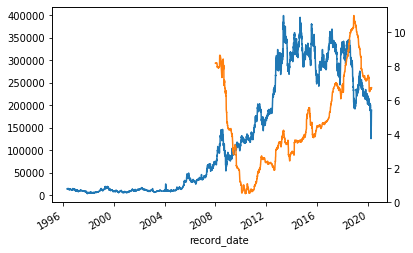

229    두산퓨얼셀
Name: name, dtype: object 4.017114093959733


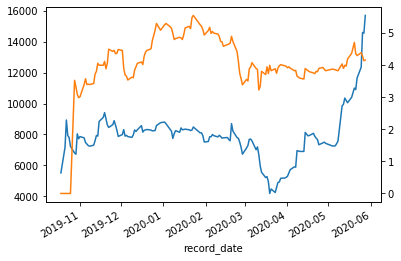

230    디아이
Name: name, dtype: object 4.220150993377484


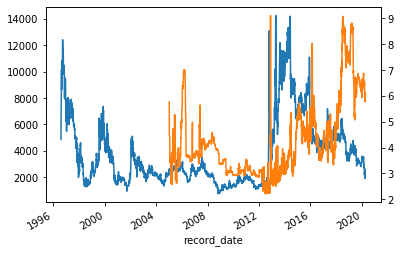

231    디와이
Name: name, dtype: object 10.32580750407829


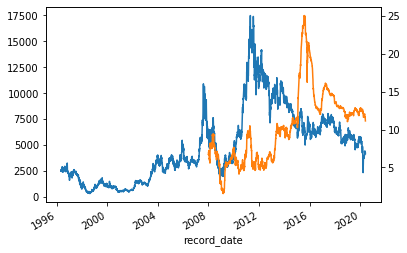

232    디티알오토모티브
Name: name, dtype: object 5.973537751401264


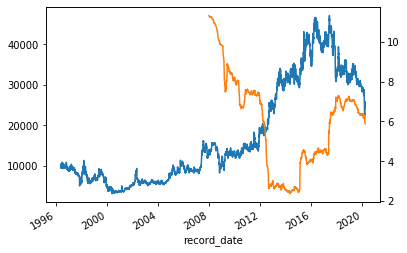

233    디피씨
Name: name, dtype: object 1.7472104404567703


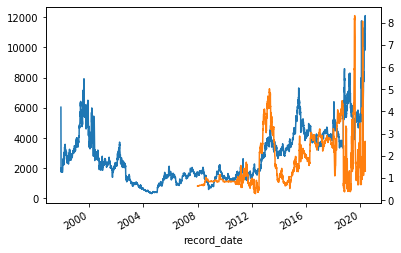

234    롯데정밀화학
Name: name, dtype: object 14.85109933774835


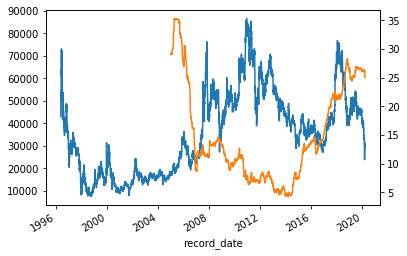

235    맥쿼리인프라
Name: name, dtype: object 25.12103425774877


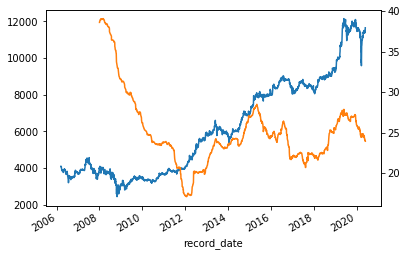

236    메타랩스
Name: name, dtype: object 19.001673735725934


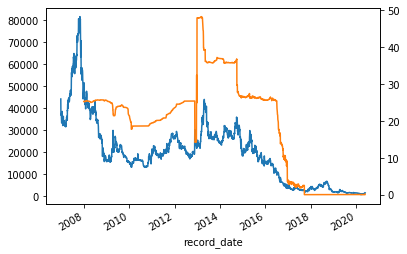

237    명문제약
Name: name, dtype: object 1.3719891008174387


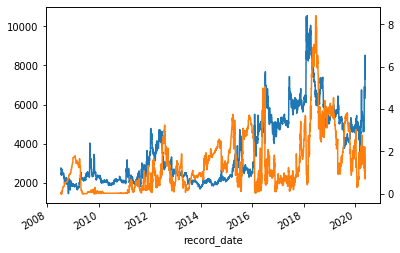

238    모토닉
Name: name, dtype: object 14.906363336630404


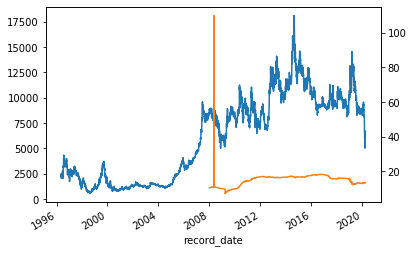

239    미원화학
Name: name, dtype: object 4.867037199124727


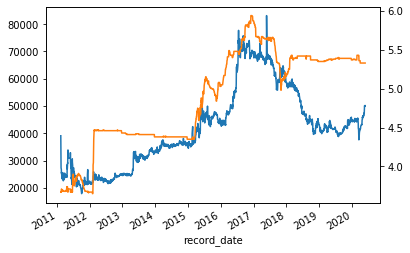

240    베트남개발1
Name: name, dtype: object 0.038003262642740676


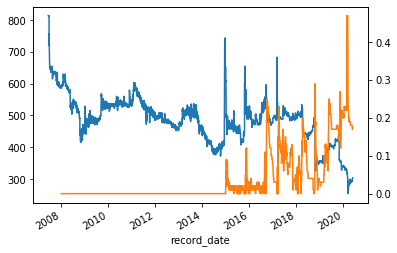

241    빙그레
Name: name, dtype: object 30.62327417218535


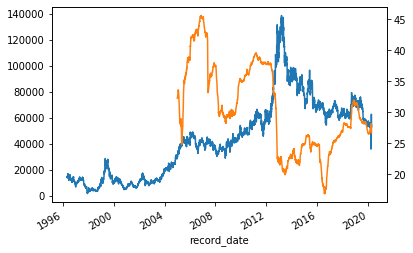

242    삼성에스디에스
Name: name, dtype: object 9.64011790714814


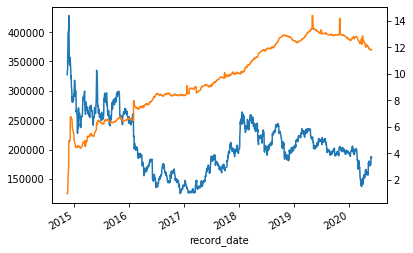

243    삼성중공업
Name: name, dtype: object 22.325113748763535


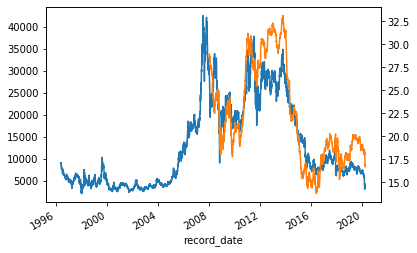

244    삼성증권
Name: name, dtype: object 21.506430668841762


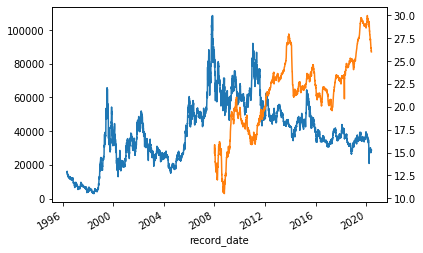

245    삼양통상
Name: name, dtype: object 5.137260927152333


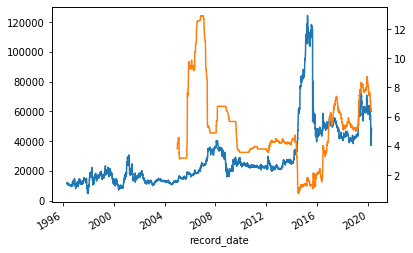

246    삼영무역
Name: name, dtype: object 5.798148344370858


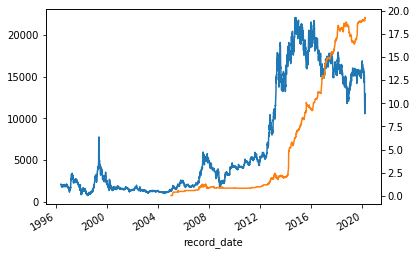

247    삼정펄프
Name: name, dtype: object 1.333857566765582


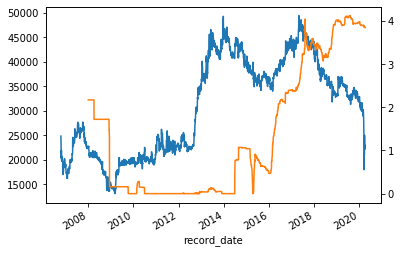

248    샘표식품
Name: name, dtype: object 2.1473304628632923


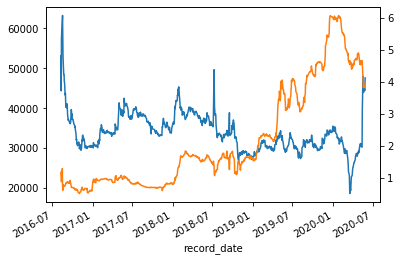

249    성보화학
Name: name, dtype: object 0.4928211920529858


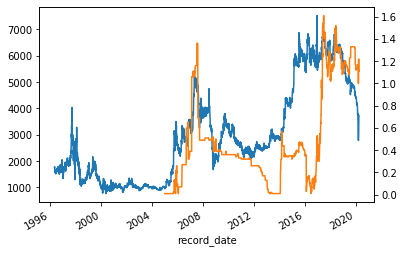

250    세아제강
Name: name, dtype: object 7.821910669975197


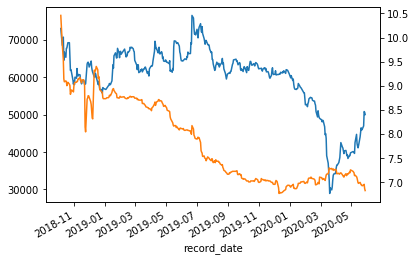

251    센트랄모텍
Name: name, dtype: object 0.2403252032520325


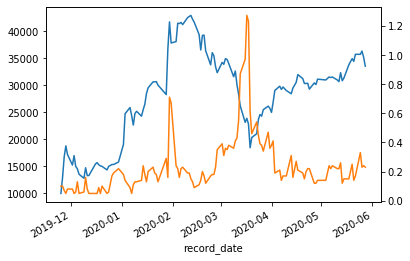

252    송원산업
Name: name, dtype: object 13.753637086092713


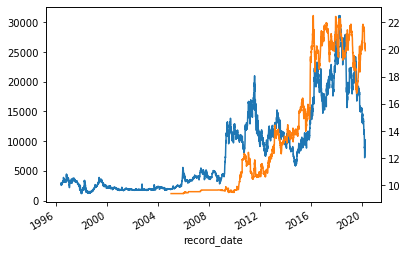

253    신세계푸드
Name: name, dtype: object 13.213572593801036


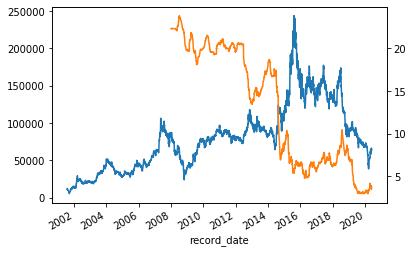

254    신영증권
Name: name, dtype: object 17.537549668874117


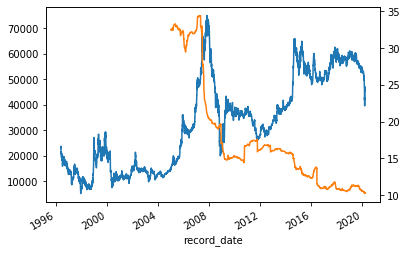

255    신화실업
Name: name, dtype: object 0.7540980132450301


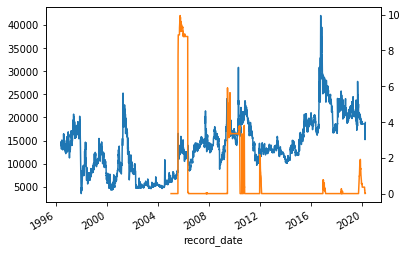

256    쌍방울
Name: name, dtype: object 1.137670723461798


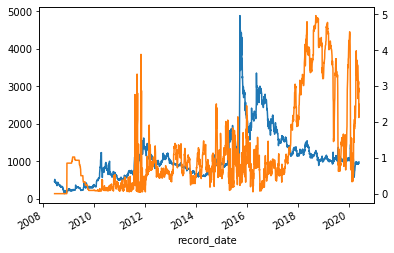

257    아세아시멘트
Name: name, dtype: object 6.3467226368159295


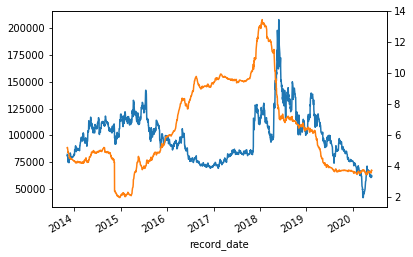

258    애경유화
Name: name, dtype: object 18.60002118644067


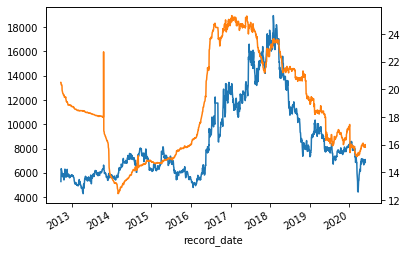

259    에어부산
Name: name, dtype: object 0.3554913294797689


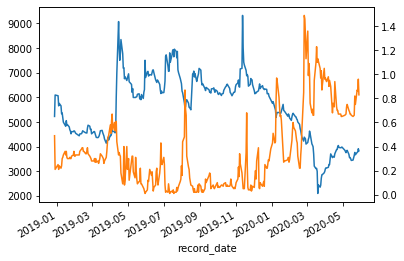

260    엔에스쇼핑
Name: name, dtype: object 10.391143533123024


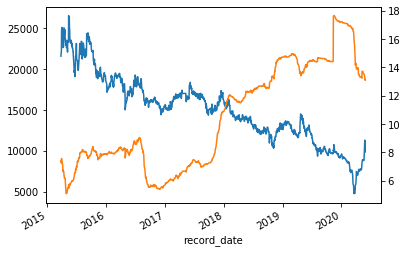

261    엔에이치엔
Name: name, dtype: object 12.092391041162204


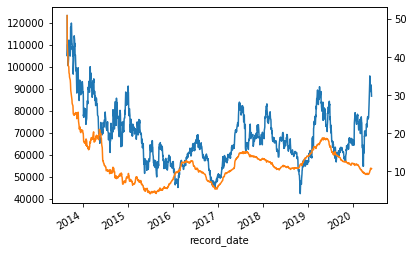

262    유니온
Name: name, dtype: object 1.652034437086094


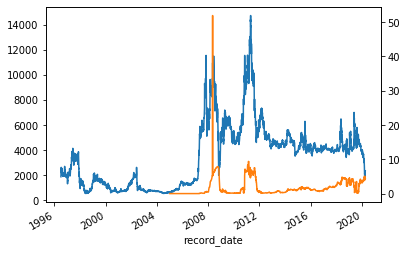

263    유니켐
Name: name, dtype: object 0.4286688417618271


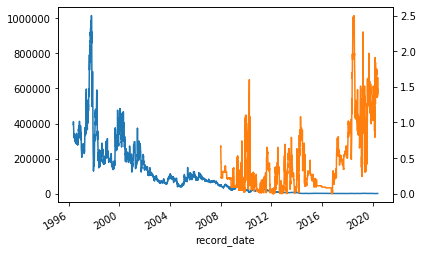

264    유진증권
Name: name, dtype: object 10.237552317880771


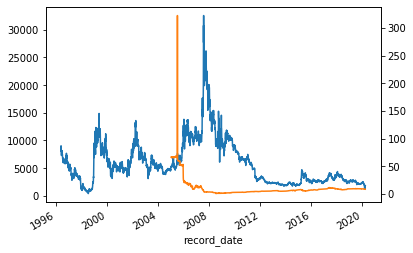

265    유화증권
Name: name, dtype: object 2.9189377483443244


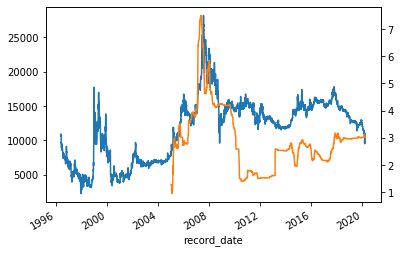

266    일성신약
Name: name, dtype: object 10.939576158940385


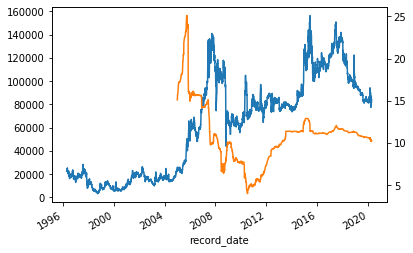

267    제이에스코퍼레이션
Name: name, dtype: object 0.937201138519925


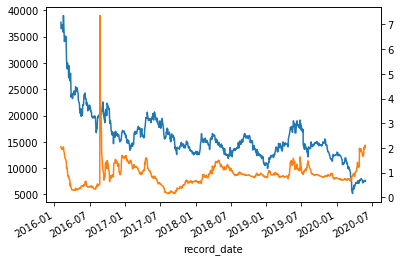

268    조비
Name: name, dtype: object 0.2936476821192049


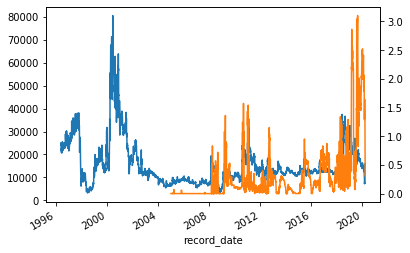

269    종근당바이오
Name: name, dtype: object 5.341148450244695


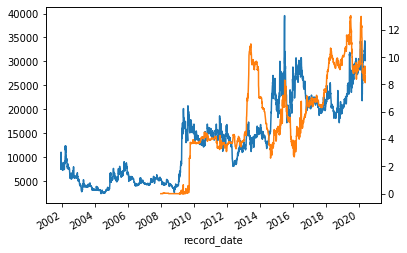

270    종근당홀딩스
Name: name, dtype: object 12.694805298013263


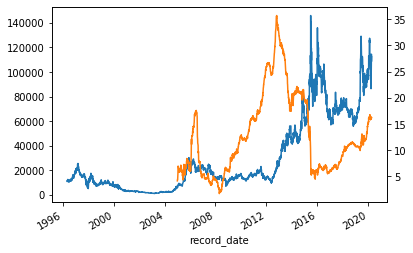

271    진양화학
Name: name, dtype: object 0.693725938009793


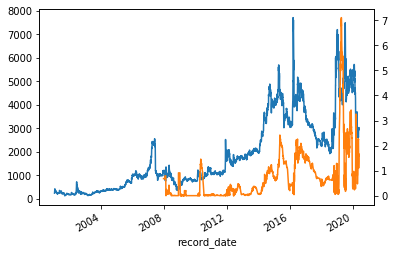

272    케이탑리츠
Name: name, dtype: object 9.52340664711632


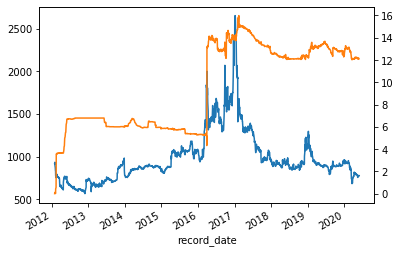

273    코스맥스비티아이
Name: name, dtype: object 10.446339314845021


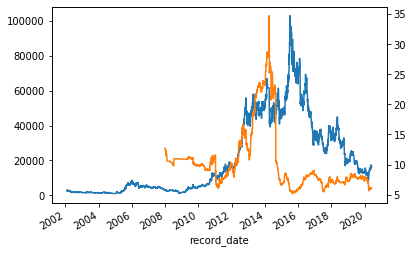

274    코스모신소재
Name: name, dtype: object 1.2379311258278134


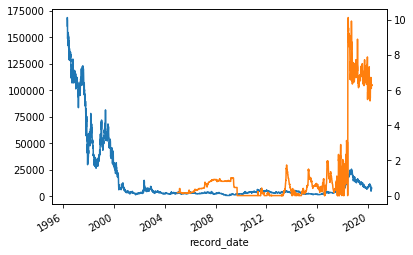

275    코웨이
Name: name, dtype: object 52.08971288743892


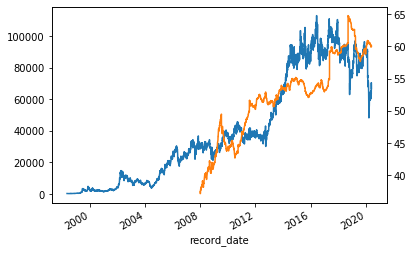

276    태평양물산
Name: name, dtype: object 0.9564622485987463


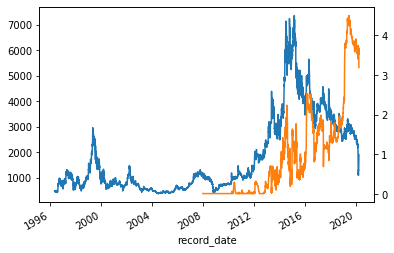

277    텔코웨어
Name: name, dtype: object 2.021115823817284


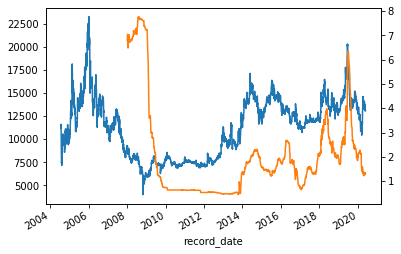

278    티웨이홀딩스
Name: name, dtype: object 2.33937218543048


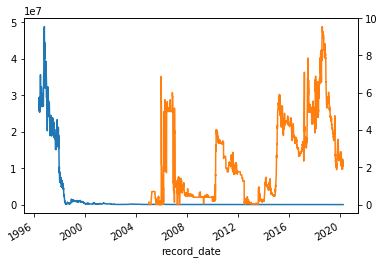

279    팜스코
Name: name, dtype: object 2.075262642740622


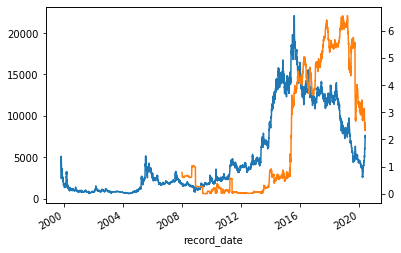

280    퍼시스
Name: name, dtype: object 26.885856443719558


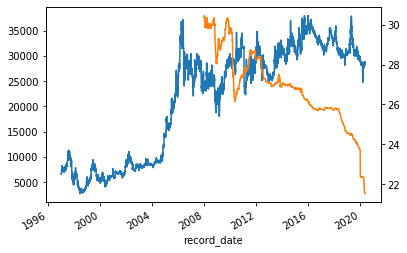

281    풍산홀딩스
Name: name, dtype: object 6.253468513023405


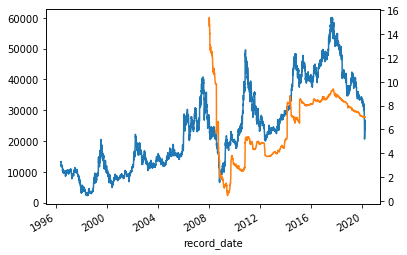

282    하나니켈1호
Name: name, dtype: object 0.02991784423266529


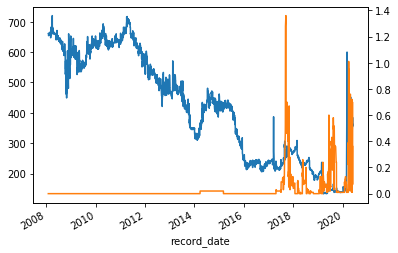

283    하이스틸
Name: name, dtype: object 0.7816639477977145


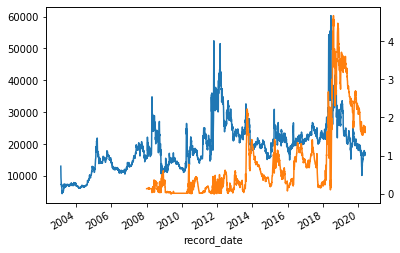

284    한국공항
Name: name, dtype: object 3.683592052980137


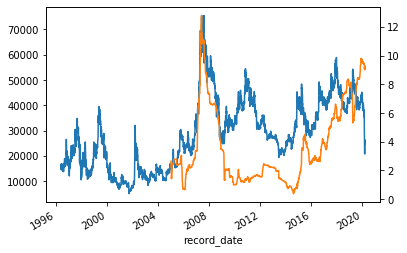

285    한국석유공업
Name: name, dtype: object 0.8770463576158937


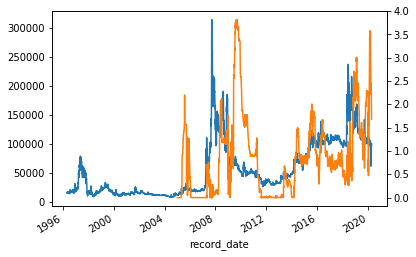

286    한국수출포장공업
Name: name, dtype: object 2.534524503311247


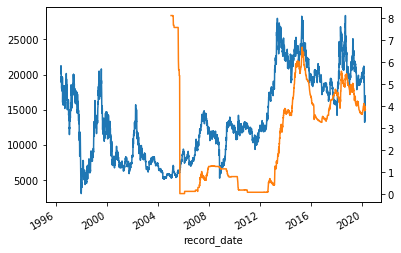

287    한국자산신탁
Name: name, dtype: object 5.757278481012657


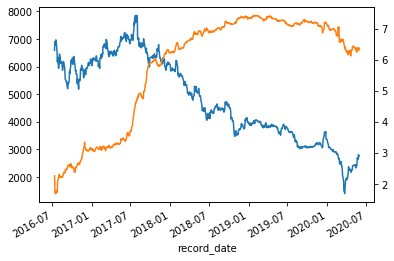

288    한국주강
Name: name, dtype: object 0.4307275693311588


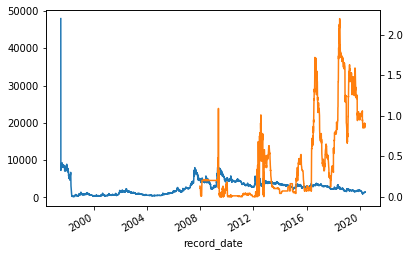

289    한국콜마홀딩스
Name: name, dtype: object 17.71094942903748


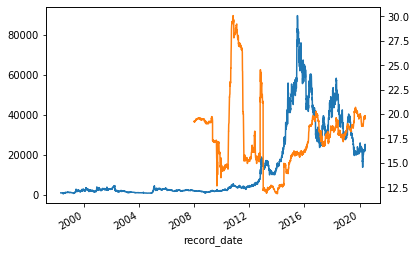

290    한샘
Name: name, dtype: object 16.608981206726074


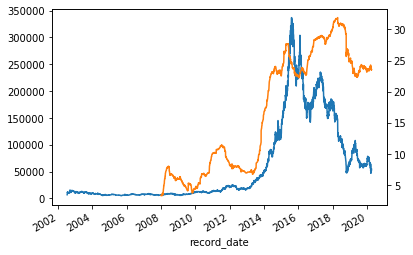

291    한솔홀딩스
Name: name, dtype: object 14.133467549668906


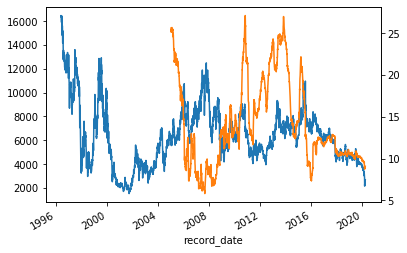

292    한신기계공업
Name: name, dtype: object 10.385869494290379


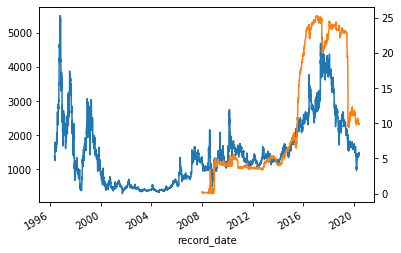

293    한진중공업
Name: name, dtype: object 10.799983686786328


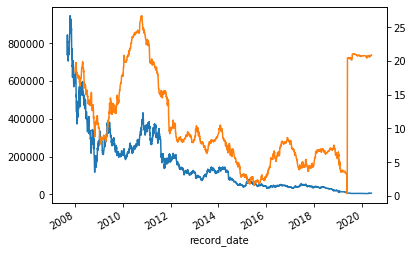

294    한화에어로스페이스
Name: name, dtype: object 15.162205546492697


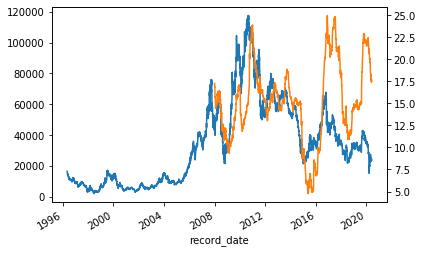

295    현대그린푸드
Name: name, dtype: object 12.072596026490084


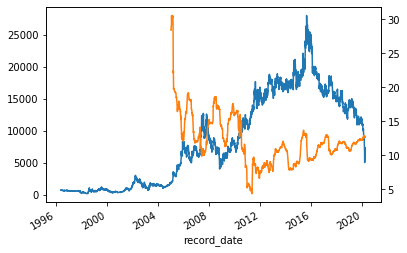

296    효성 ITX
Name: name, dtype: object 0.6319249592169646


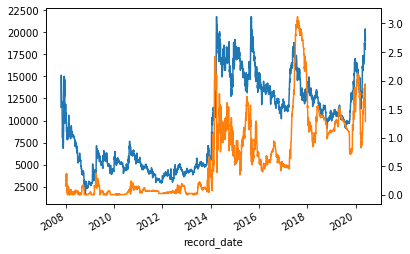

297    효성화학
Name: name, dtype: object 13.250764192139753


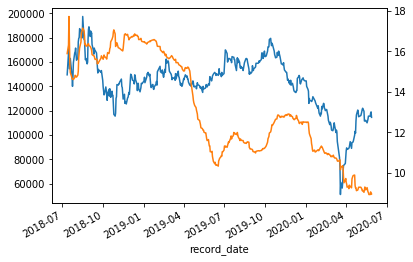

298    휴니드테크놀러지스
Name: name, dtype: object 22.5303231124299


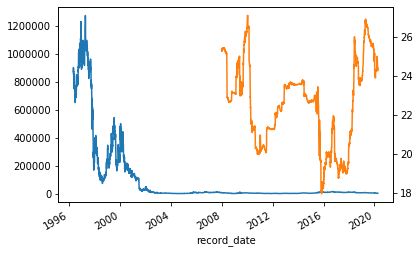

299    AJ네트웍스
Name: name, dtype: object 5.097746358183375


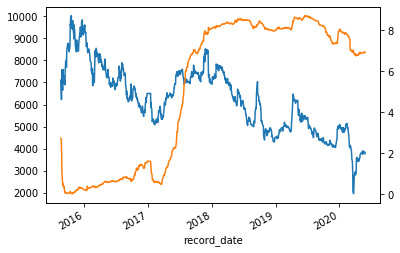

300    DB하이텍
Name: name, dtype: object 10.863419867549677


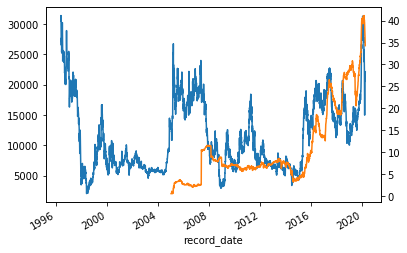

301    DSR제강
Name: name, dtype: object 1.2671125611745453


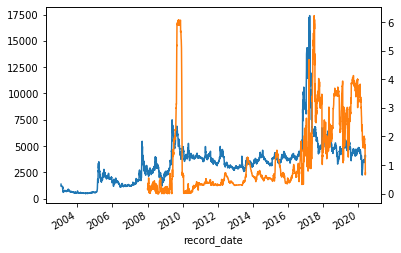

302    HDC아이콘트롤스
Name: name, dtype: object 4.16241469816272


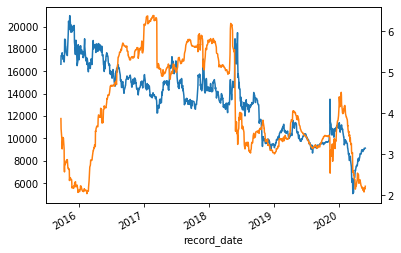

303    JW중외제약
Name: name, dtype: object 4.540823841059607


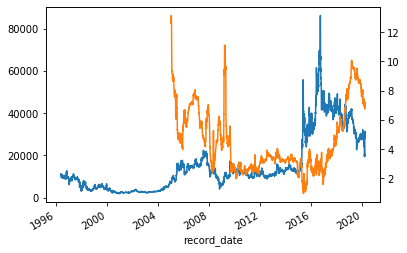

304    JW홀딩스
Name: name, dtype: object 2.027510603588907


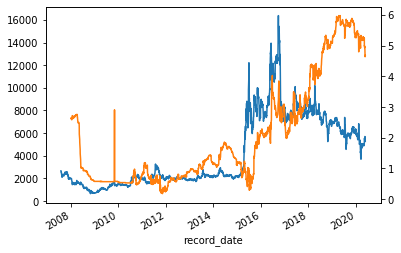

305    KPX홀딩스
Name: name, dtype: object 30.601353996737174


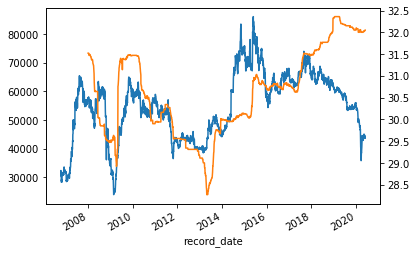

306    KSS해운
Name: name, dtype: object 2.6213703099510597


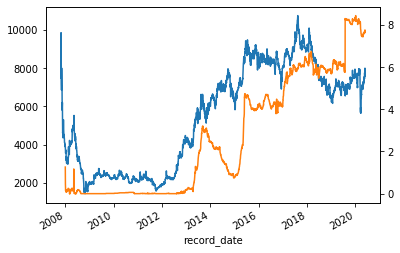

307    LF
Name: name, dtype: object 25.912499184339296


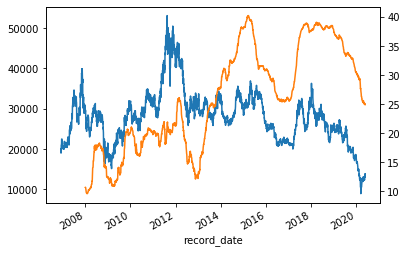

308    LG하우시스
Name: name, dtype: object 12.29378920495988


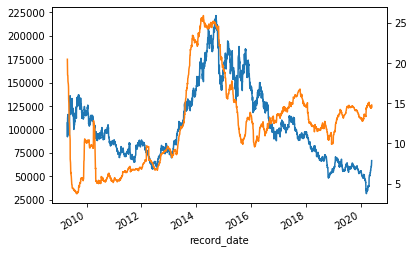

309    LG헬로비전
Name: name, dtype: object 7.816817936250687


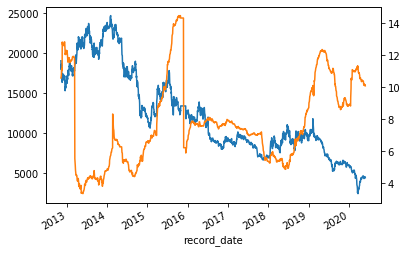

310    LG화학
Name: name, dtype: object 34.03119086460035


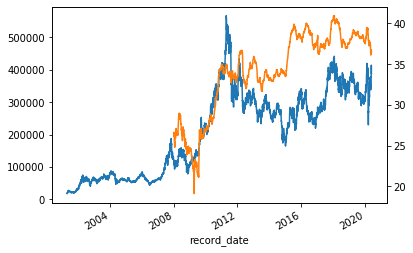

311    LIG넥스원
Name: name, dtype: object 12.668358208955228


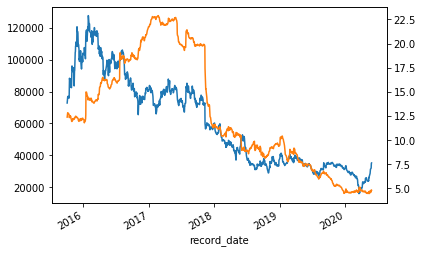

312    LS
Name: name, dtype: object 15.303870755028006


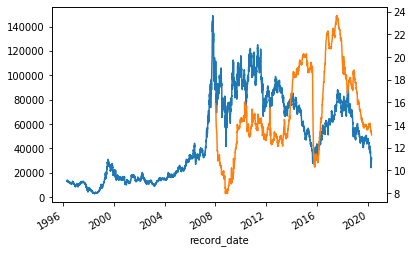

313    MH에탄올
Name: name, dtype: object 0.9943132137030997


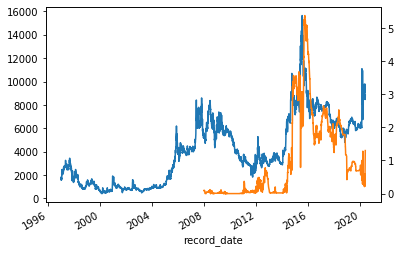

314    NAVER
Name: name, dtype: object 57.041981070496064


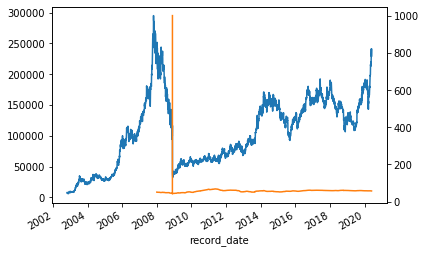

315    NH투자증권
Name: name, dtype: object 15.063386086383117


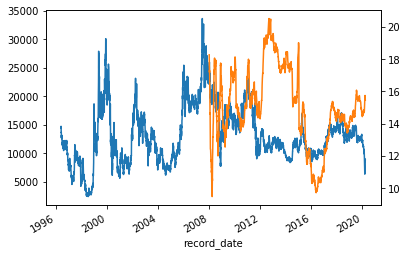

316    NI스틸
Name: name, dtype: object 0.9735080778107491


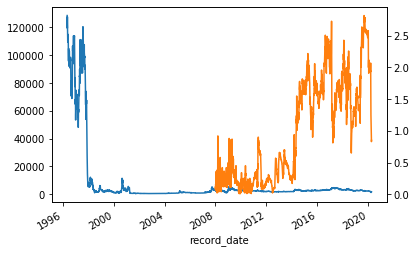

317    SH에너지화학
Name: name, dtype: object 29.74736158940405


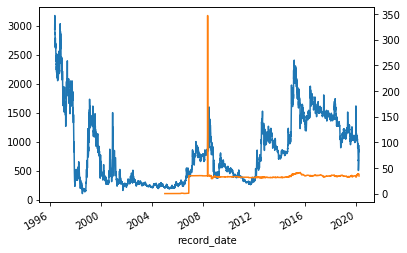

318    SK디앤디
Name: name, dtype: object 2.1512158808933


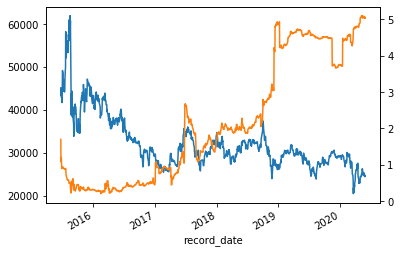

319    SK증권
Name: name, dtype: object 4.122847682119202


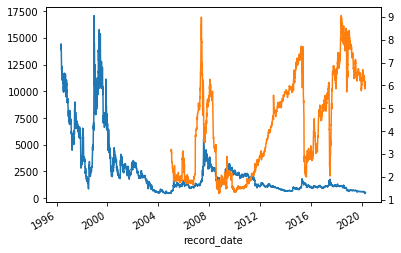

320    SK하이닉스
Name: name, dtype: object 32.87711258278148


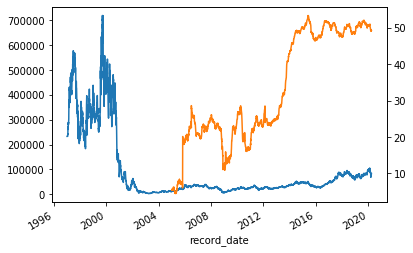

321    경인양행
Name: name, dtype: object 16.023122349102735


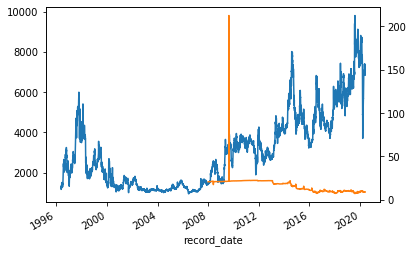

322    경인전자
Name: name, dtype: object 14.070989119683448


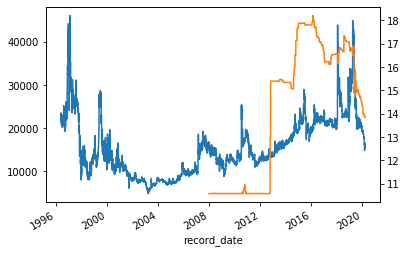

323    기신정기
Name: name, dtype: object 63.90890701468208


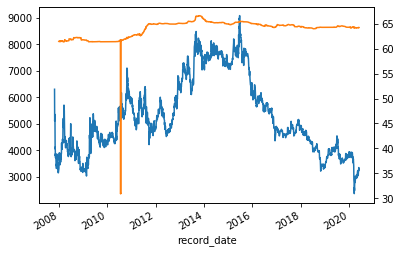

324    나노메딕스
Name: name, dtype: object 0.5952071778140294


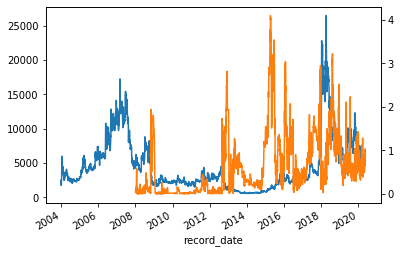

325    남영비비안
Name: name, dtype: object 0.7981615894039713


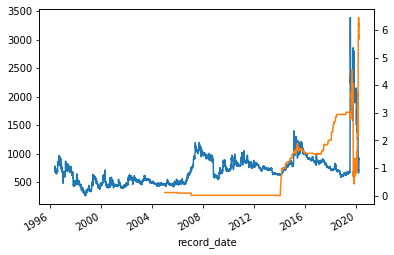

326    녹십자
Name: name, dtype: object 23.16411803494893


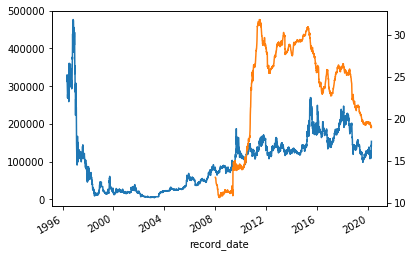

327    대교
Name: name, dtype: object 15.150407830342596


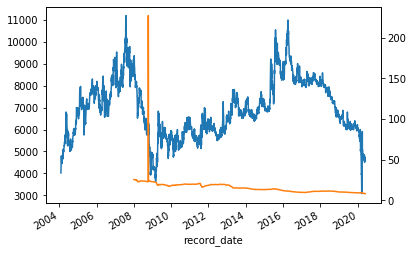

328    대동전자
Name: name, dtype: object 24.7475832509065


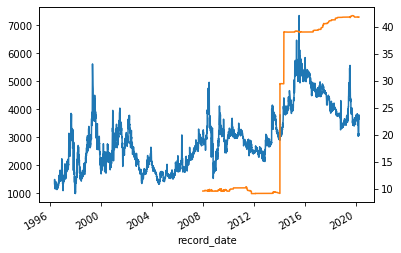

329    대림비앤코
Name: name, dtype: object 2.1700098911968375


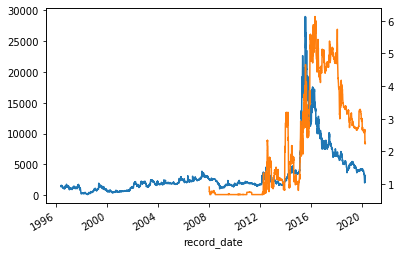

330    대양금속
Name: name, dtype: object 0.6411341905703839


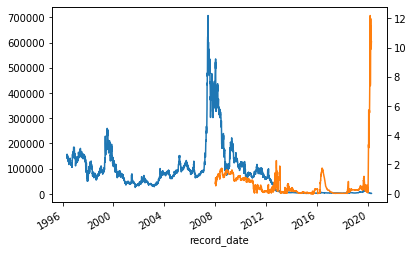

331    대창
Name: name, dtype: object 2.9010766721044132


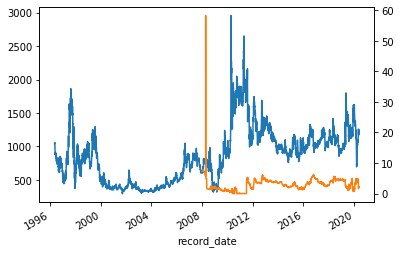

332    대한제분
Name: name, dtype: object 12.951690066225165


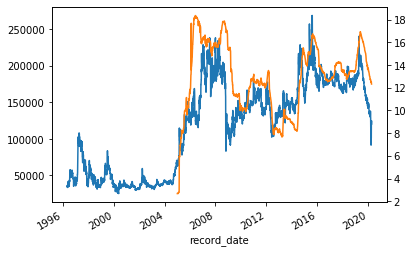

333    동국제강
Name: name, dtype: object 28.48652715231797


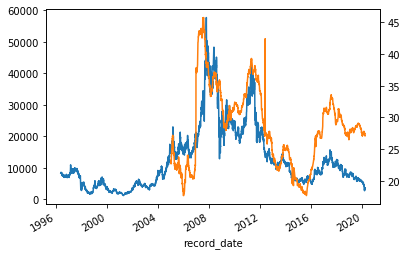

334    동일제강
Name: name, dtype: object 1.1173987398739829


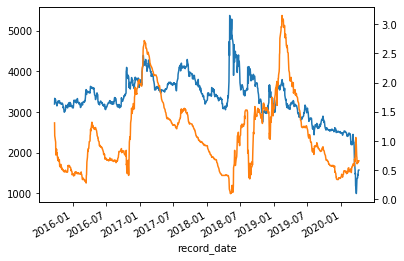

335    동화약품
Name: name, dtype: object 6.4330993377483425


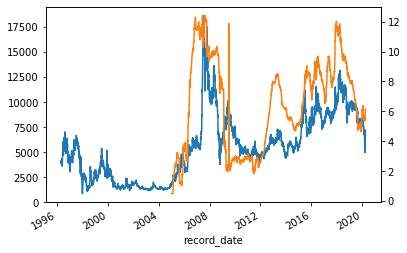

336    두산솔루스
Name: name, dtype: object 5.705503355704696


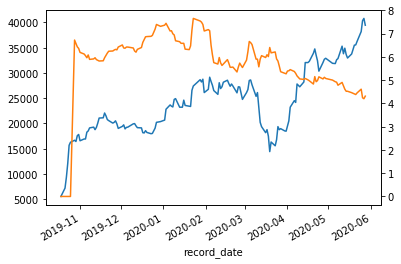

337    디아이씨
Name: name, dtype: object 1.6702675367047288


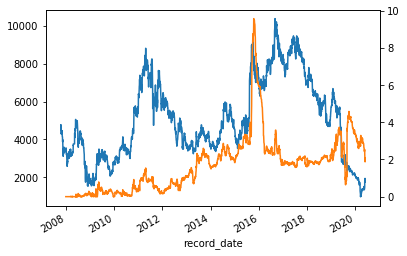

338    디와이파워
Name: name, dtype: object 6.509490881458967


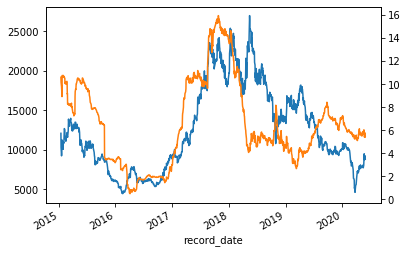

339    롯데관광개발
Name: name, dtype: object 1.6482577487765107


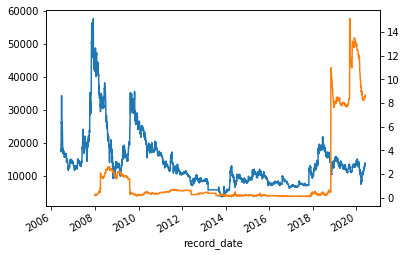

340    롯데지주
Name: name, dtype: object 34.853599999999894


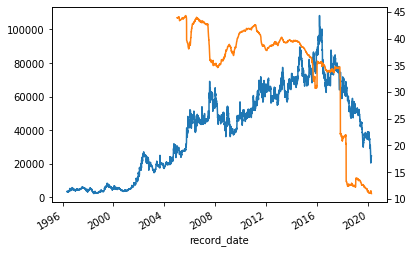

341    롯데하이마트
Name: name, dtype: object 10.603844049247583


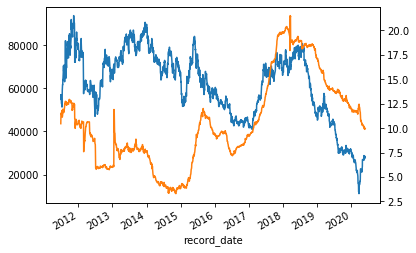

342    맵스리얼티1
Name: name, dtype: object 2.6209690048939627


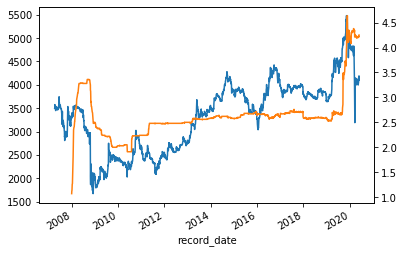

343    무림P&P
Name: name, dtype: object 4.598156940323118


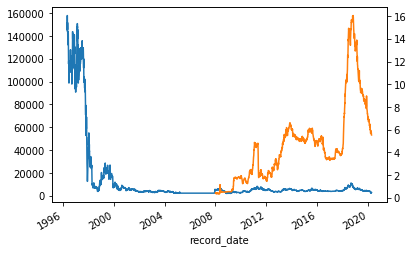

344    무학
Name: name, dtype: object 11.9725938009788


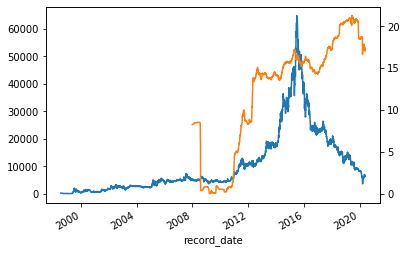

345    미래아이앤지
Name: name, dtype: object 0.5697065611605687


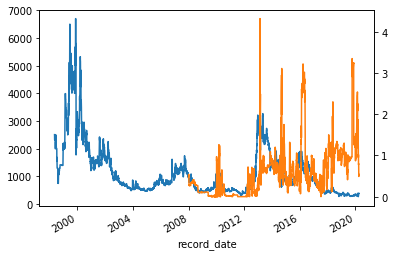

346    바다로19호
Name: name, dtype: object 0.0


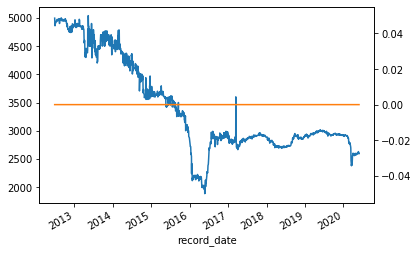

347    부산주공
Name: name, dtype: object 0.9133589403973541


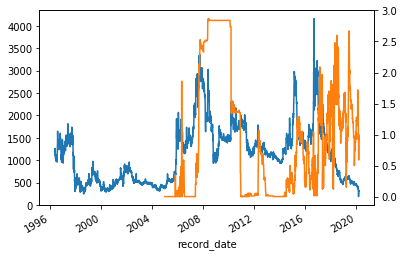

348    비티원
Name: name, dtype: object 0.348658008658007


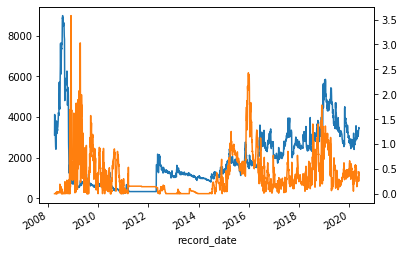

349    삼성물산
Name: name, dtype: object 10.01231807951989


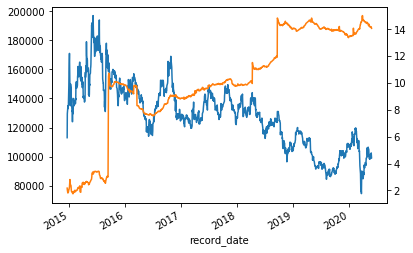

350    삼성전자
Name: name, dtype: object 50.44706890867132


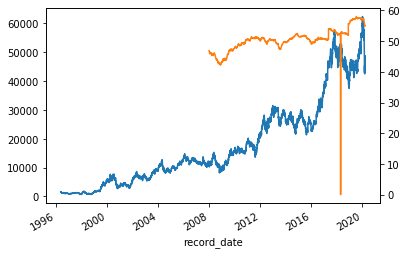

351    삼성제약
Name: name, dtype: object 0.9571788079470204


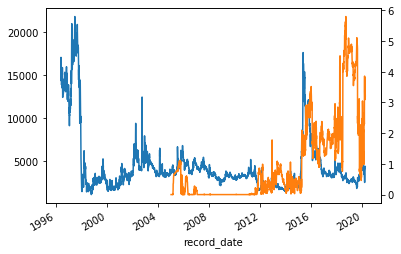

352    삼익THK
Name: name, dtype: object 34.96825430463581


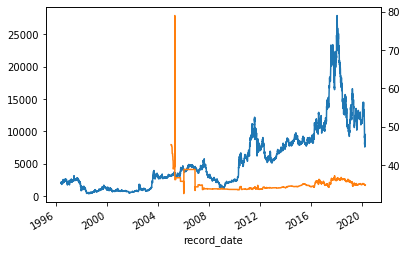

353    삼일제약
Name: name, dtype: object 18.514116556291466


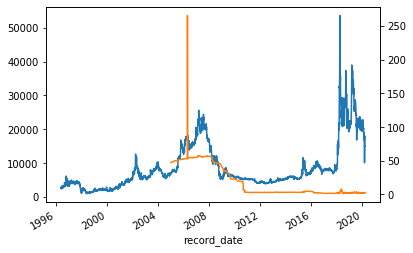

354    삼진제약
Name: name, dtype: object 13.185361028684474


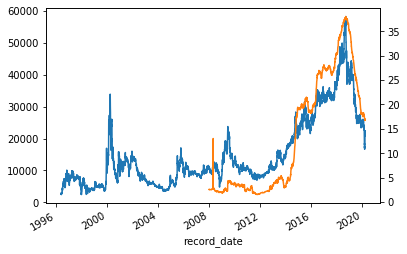

355    삼화왕관
Name: name, dtype: object 3.1777642384105427


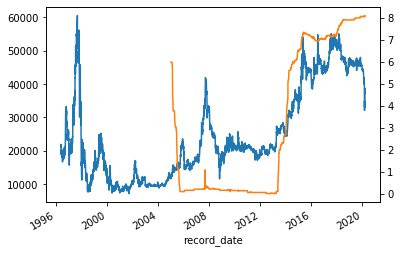

356    서연
Name: name, dtype: object 9.749798878997685


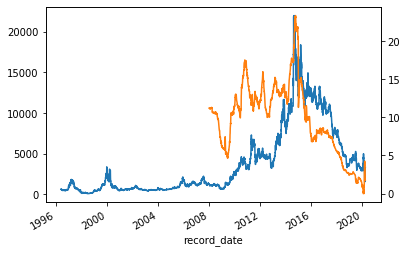

357    선창산업
Name: name, dtype: object 1.4111761589403984


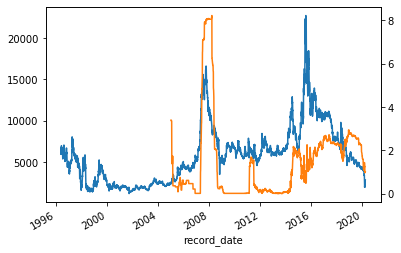

358    성신양회
Name: name, dtype: object 11.10909139072849


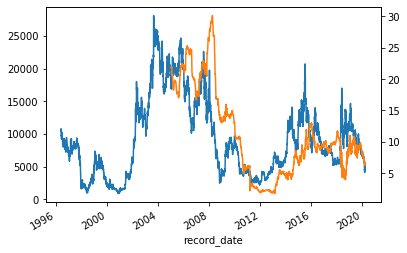

359    세기상사
Name: name, dtype: object 0.23567832538420588


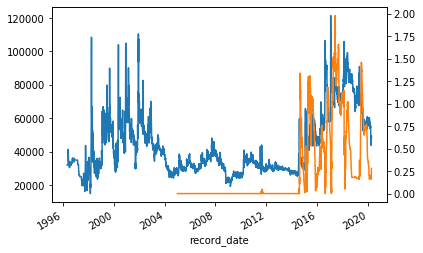

360    세방전지
Name: name, dtype: object 29.223904635761578


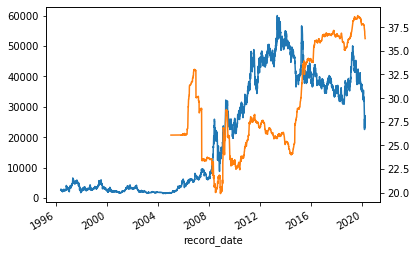

361    세우글로벌
Name: name, dtype: object 2.064110929853181


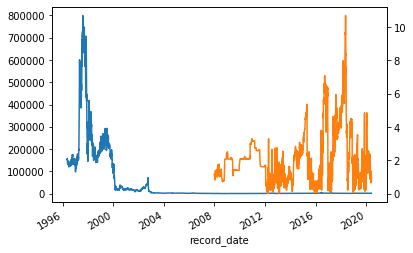

362    세원정공
Name: name, dtype: object 14.136035889070024


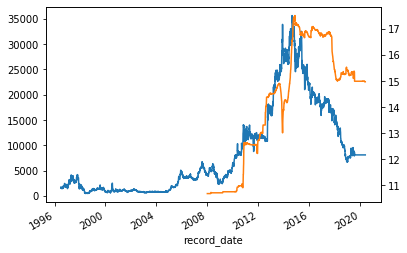

363    셀트리온
Name: name, dtype: object 20.977588907014713


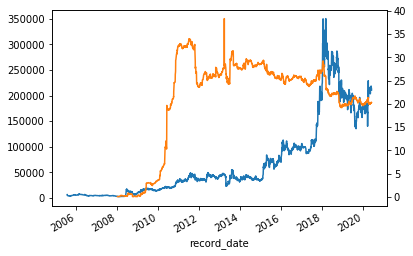

364    신라교역
Name: name, dtype: object 4.944874172185441


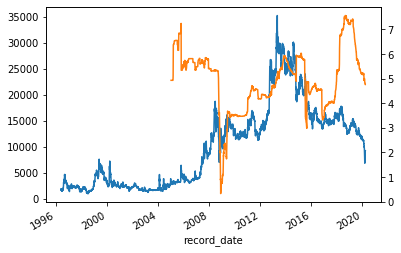

365    신성통상
Name: name, dtype: object 1.6562145695364239


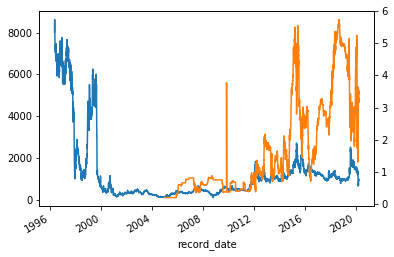

366    아모레퍼시픽
Name: name, dtype: object 34.20805872756941


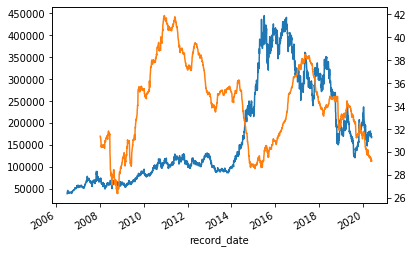

367    아세아
Name: name, dtype: object 12.176943046357627


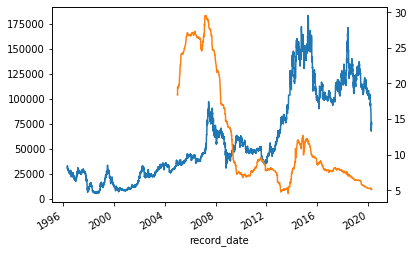

368    아이에스동서
Name: name, dtype: object 3.0240718760303373


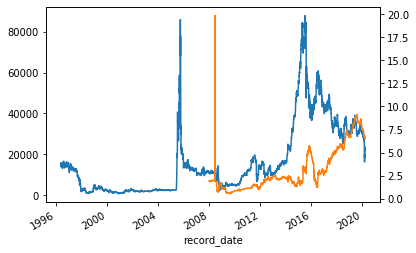

369    애경산업
Name: name, dtype: object 4.477865168539322


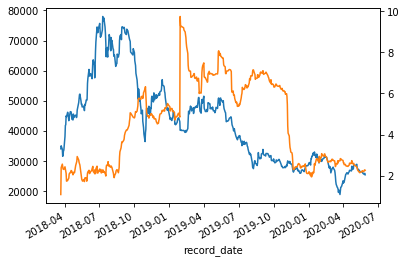

370    에스원
Name: name, dtype: object 49.48434584013055


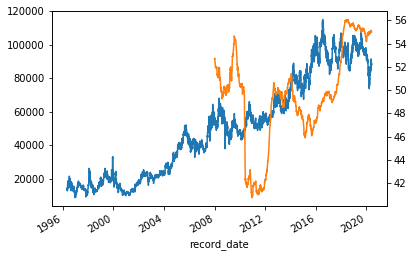

371    에스제이엠
Name: name, dtype: object 12.451904181892006


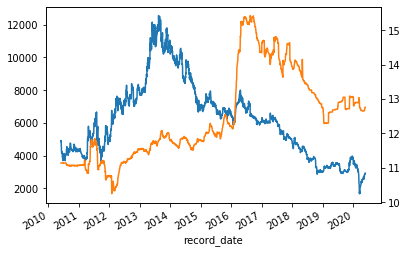

372    에이리츠
Name: name, dtype: object 0.19447754353803864


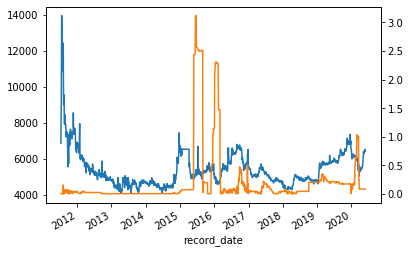

373    에이블씨엔씨
Name: name, dtype: object 15.106450244698157


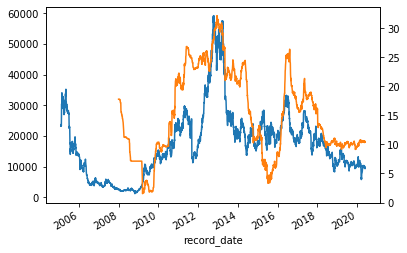

374    에이엔피
Name: name, dtype: object 0.325168026101142


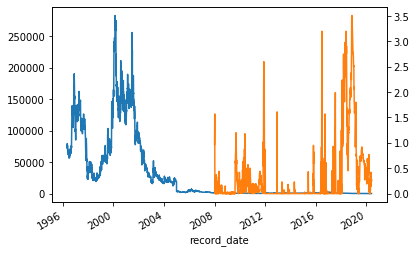

375    엔케이
Name: name, dtype: object 2.2832666448015844


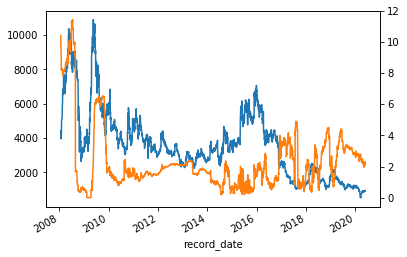

376    엔피씨
Name: name, dtype: object 1.147944370860936


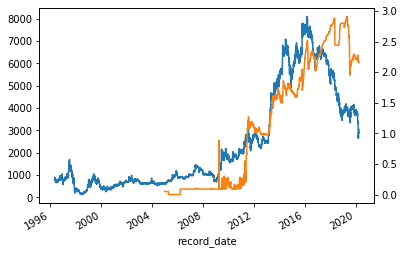

377    영원무역홀딩스
Name: name, dtype: object 28.210873722387042


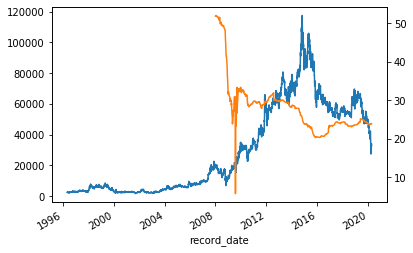

378    우신시스템
Name: name, dtype: object 8.650515497553043


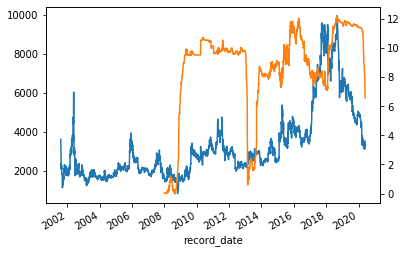

379    우진
Name: name, dtype: object 0.9509777227722747


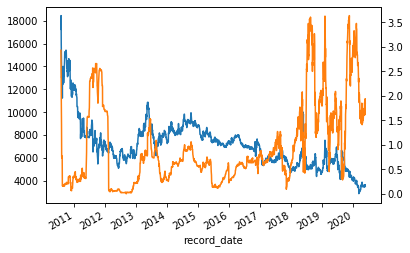

380    우진아이엔에스
Name: name, dtype: object 0.6406544502617803


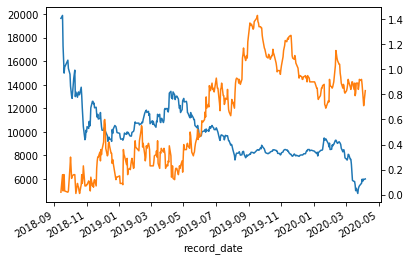

381    우진플라임
Name: name, dtype: object 2.634433931484494


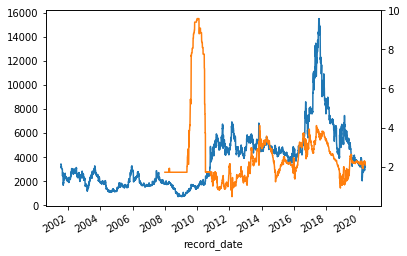

382    웅진에너지
Name: name, dtype: object 7.447604422604479


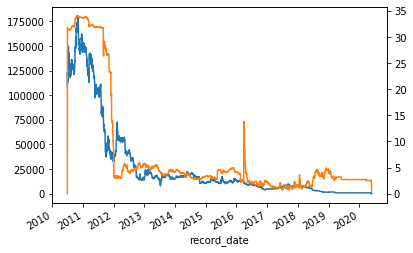

383    유니드
Name: name, dtype: object 5.249464926590536


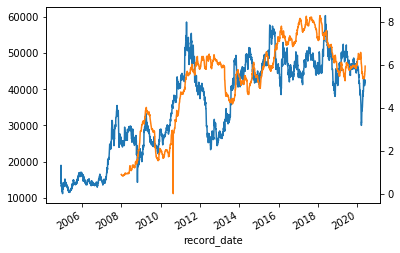

384    유안타증권
Name: name, dtype: object 27.843255629139094


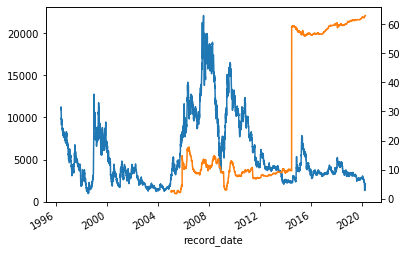

385    유양디앤유
Name: name, dtype: object 1.1362544861337718


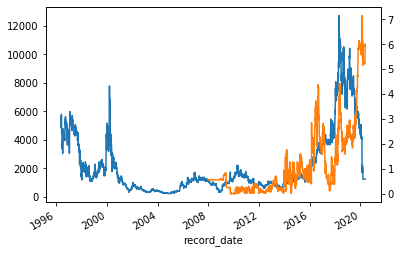

386    이건산업
Name: name, dtype: object 2.78719749423014


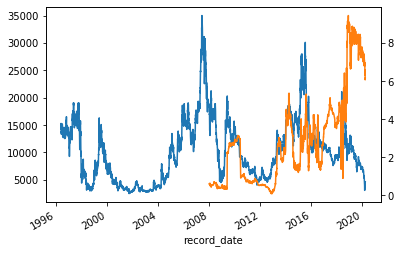

387    이연제약
Name: name, dtype: object 3.6102524429967384


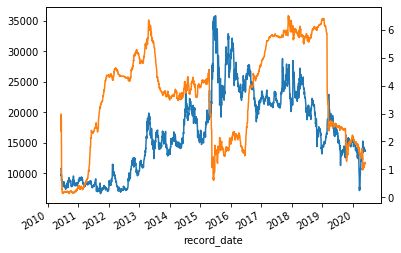

388    이월드
Name: name, dtype: object 3.7222381729200587


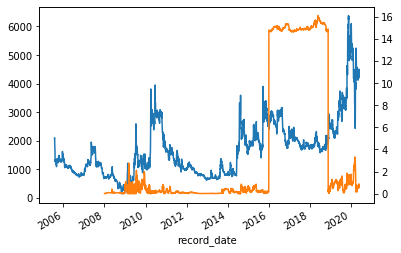

389    조광페인트
Name: name, dtype: object 2.7687390728476946


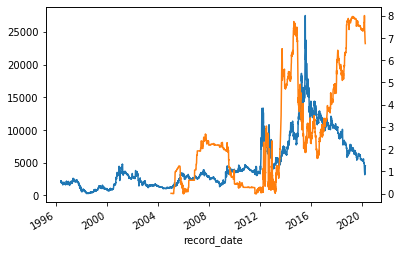

390    조선내화
Name: name, dtype: object 4.381006622516563


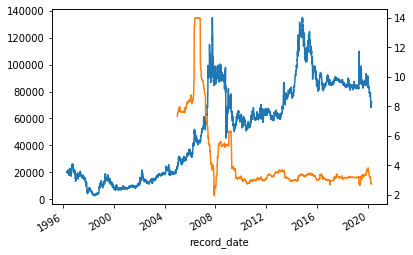

391    지누스
Name: name, dtype: object 12.0554609929078


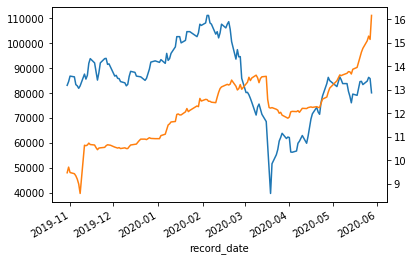

392    지엠비코리아
Name: name, dtype: object 52.067163774403376


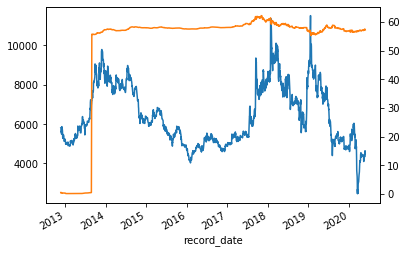

393    참엔지니어링
Name: name, dtype: object 4.893155291790297


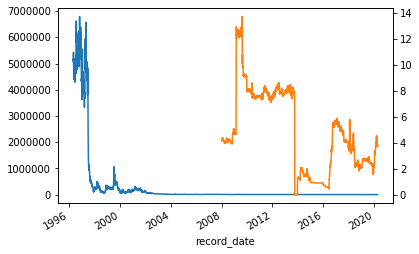

394    케이씨씨
Name: name, dtype: object 18.963599999999964


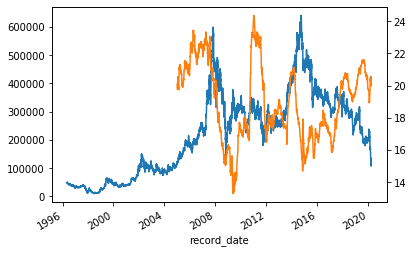

395    케이씨씨글라스
Name: name, dtype: object 10.119294117647058


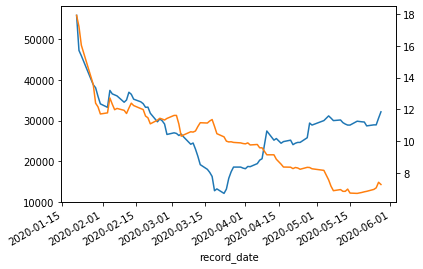

396    코리아오토글라스
Name: name, dtype: object 5.968674698795169


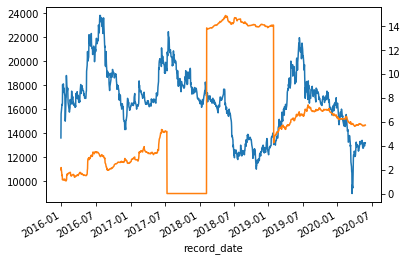

397    코오롱글로벌
Name: name, dtype: object 7.018431788079473


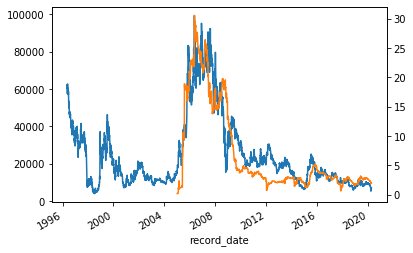

398    코오롱머티리얼
Name: name, dtype: object 1.3972100000000054


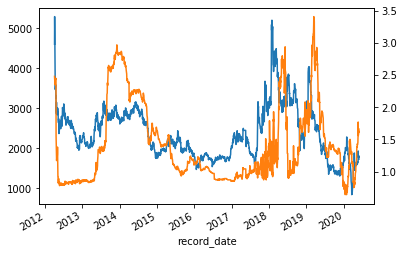

399    콤텍시스템
Name: name, dtype: object 1.2500261011419258


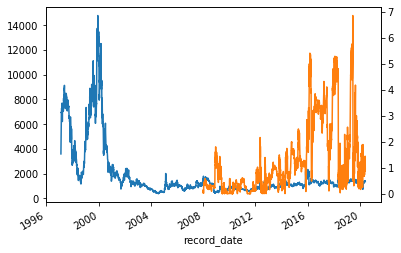

400    쿠쿠홈시스
Name: name, dtype: object 8.752048192771099


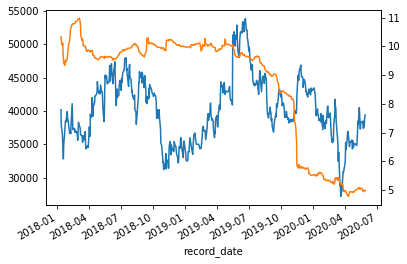

401    페이퍼코리아
Name: name, dtype: object 1.5490119205298043


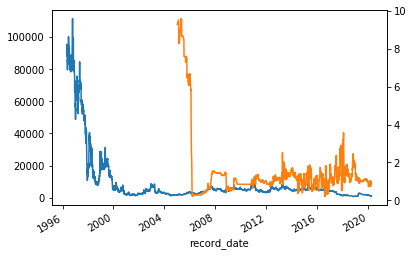

402    포스코
Name: name, dtype: object 51.69944645006027


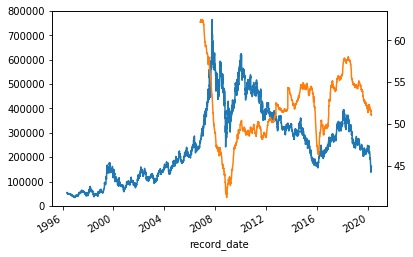

403    포스코강판
Name: name, dtype: object 2.488920065252851


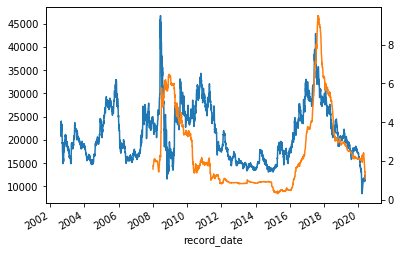

404    하나니켈2호
Name: name, dtype: object 0.0897633913900755


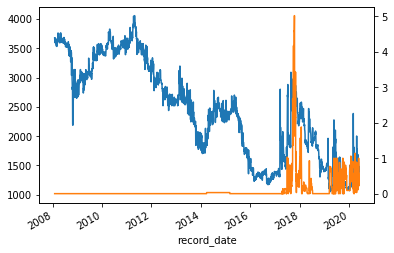

405    하나제약
Name: name, dtype: object 0.9963209876543209


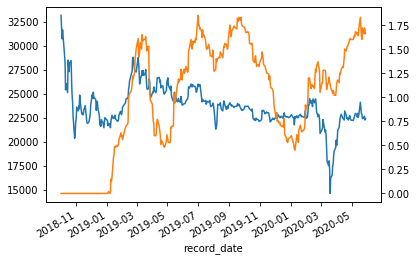

406    한국화장품제조
Name: name, dtype: object 0.9039602649006675


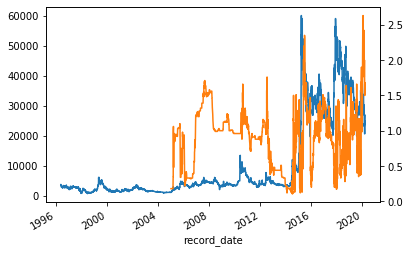

407    한독
Name: name, dtype: object 29.576585430463442


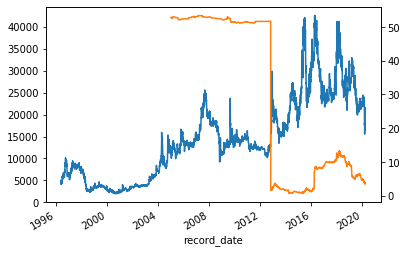

408    한솔피엔에스
Name: name, dtype: object 2.0375799538410804


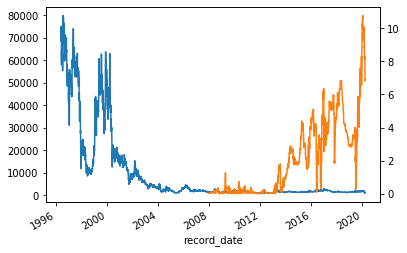

409    한양증권
Name: name, dtype: object 8.766018543046371


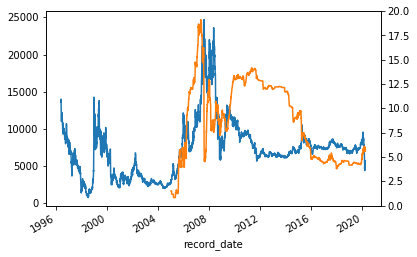

410    한전산업
Name: name, dtype: object 1.6762478485370063


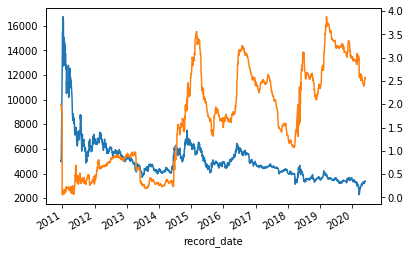

411    한진중공업홀딩스
Name: name, dtype: object 7.551435761589367


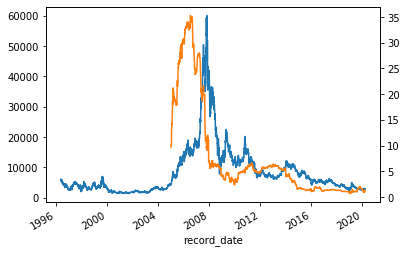

412    한진칼
Name: name, dtype: object 7.502530487804886


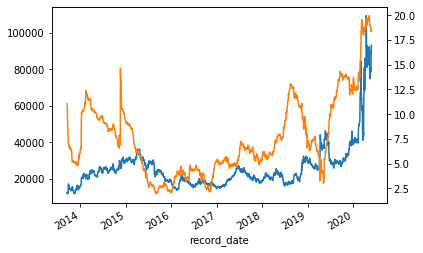

413    한화
Name: name, dtype: object 23.501353642384124


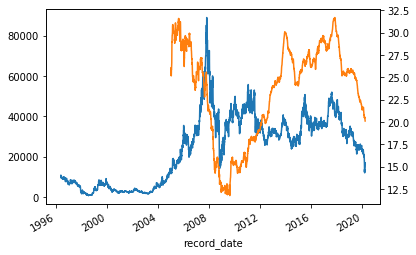

414    한화솔루션
Name: name, dtype: object 19.740735245631374


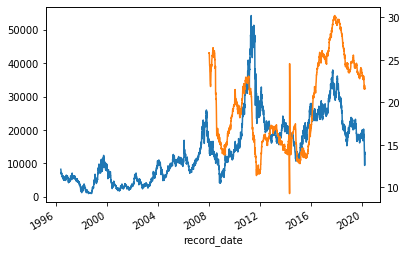

415    현대에너지솔루션
Name: name, dtype: object 1.7982677165354337


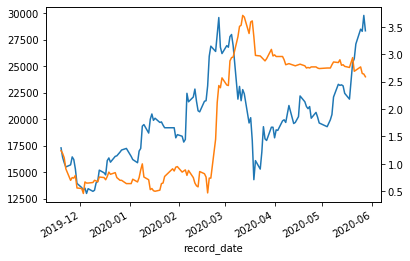

416    현대제철
Name: name, dtype: object 22.761268874172192


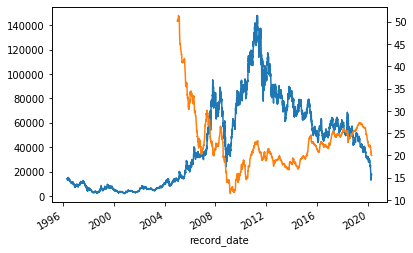

417    BGF리테일
Name: name, dtype: object 34.35802325581393


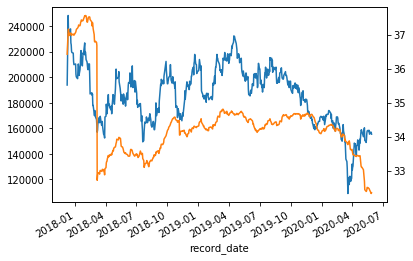

418    CJ제일제당
Name: name, dtype: object 21.815099510603574


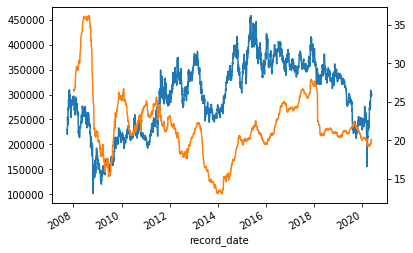

419    DB금융투자
Name: name, dtype: object 5.040486133768362


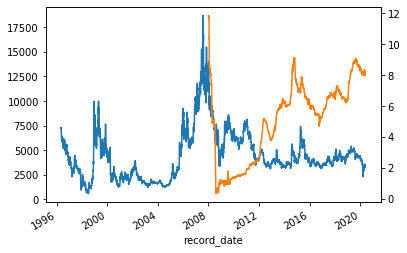

420    DGB금융지주
Name: name, dtype: object 67.33871887731998


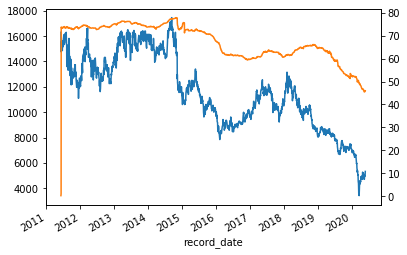

421    E1
Name: name, dtype: object 3.865500815660686


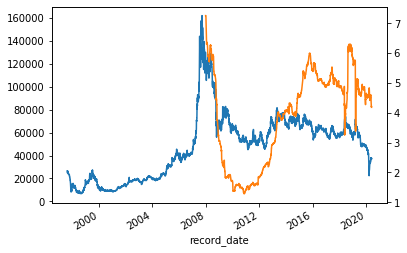

422    GS
Name: name, dtype: object 19.354773246329515


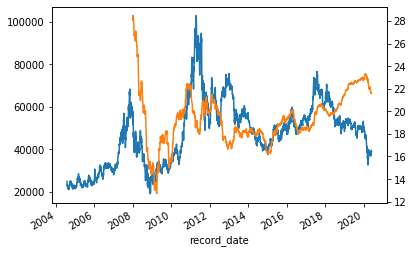

423    HDC현대EP
Name: name, dtype: object 3.1856019575856442


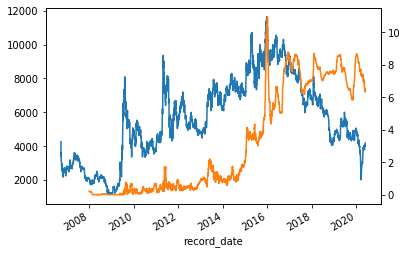

424    KEC
Name: name, dtype: object 5.951637846655802


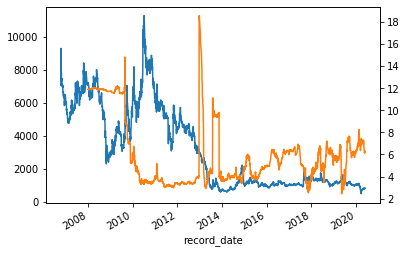

425    KISCO홀딩스
Name: name, dtype: object 9.79602119205298


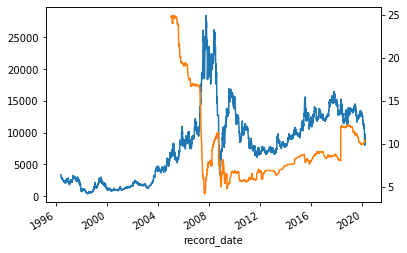

426    LG
Name: name, dtype: object 28.386519205297866


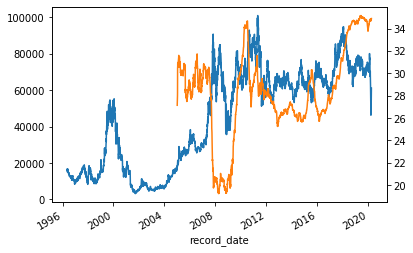

427    LS전선아시아
Name: name, dtype: object 3.7837513873473854


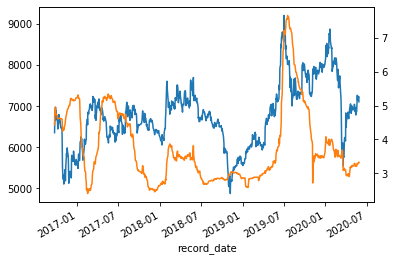

428    NH프라임리츠
Name: name, dtype: object 0.27660869565217394


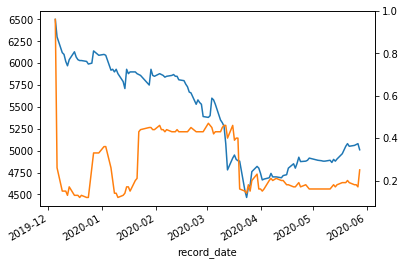

429    S&T중공업
Name: name, dtype: object 11.501062251655638


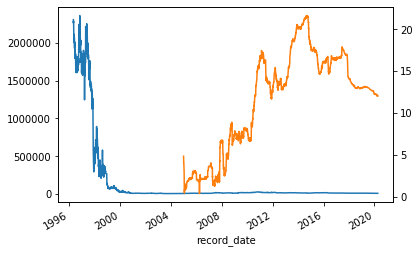

430    S&T홀딩스
Name: name, dtype: object 8.432988580750408


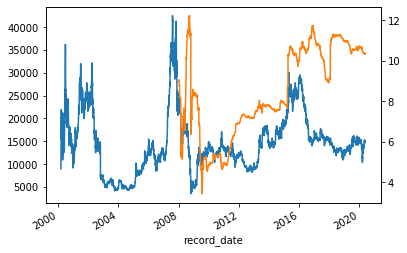

431    S-Oil
Name: name, dtype: object 59.48942631058352


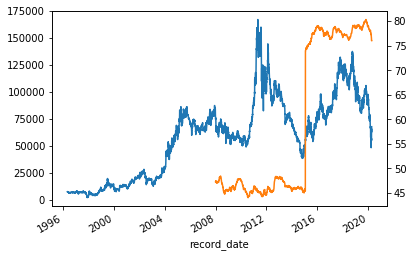

432    계룡건설산업
Name: name, dtype: object 17.421856443719395


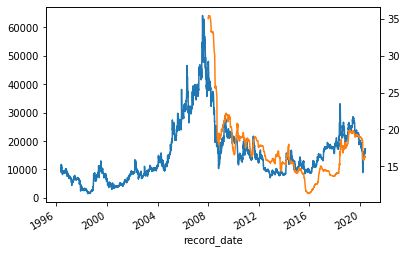

433    노루페인트
Name: name, dtype: object 2.820851549755299


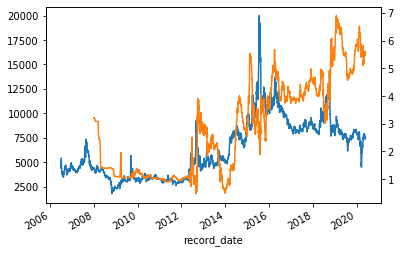

434    대덕전자
Name: name, dtype: object 18.363613583910293


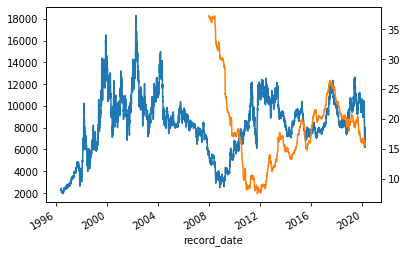

435    대상홀딩스
Name: name, dtype: object 4.879621533442111


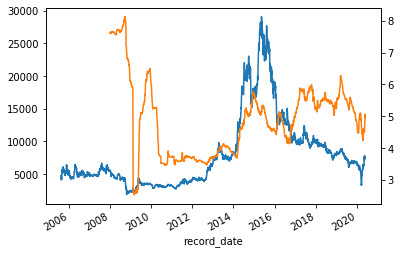

436    대성홀딩스
Name: name, dtype: object 2.187187601957588


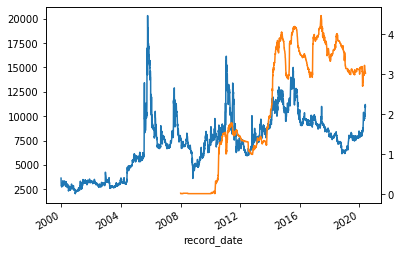

437    대우조선해양
Name: name, dtype: object 14.215083197389855


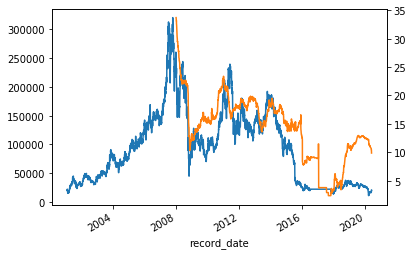

438    덴티움
Name: name, dtype: object 19.71347826086956


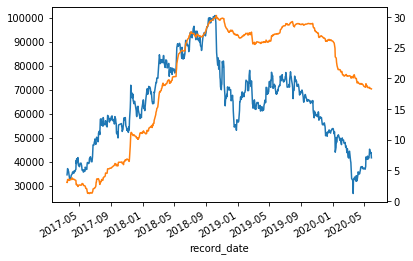

439    동양네트웍스
Name: name, dtype: object 0.5860456769983703


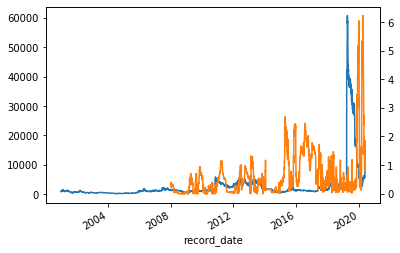

440    동원F&B
Name: name, dtype: object 6.6053017944534815


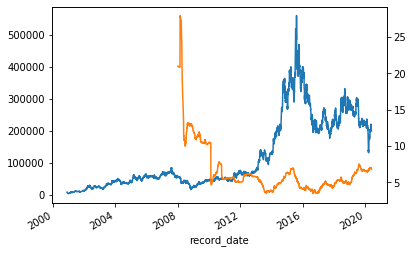

441    두산건설
Name: name, dtype: object 1.4353113553113555


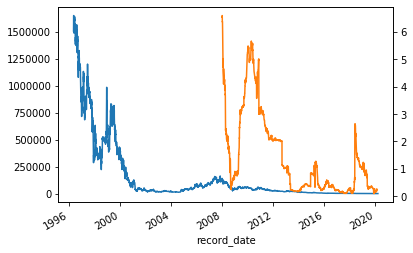

442    두산밥캣
Name: name, dtype: object 25.177003484320544


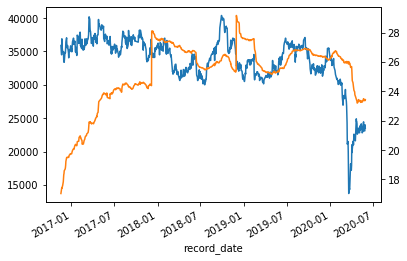

443    두산중공업
Name: name, dtype: object 11.468845024469832


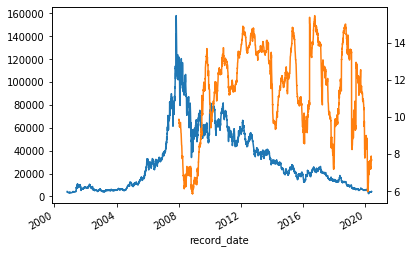

444    드림텍
Name: name, dtype: object 29.620976430976427


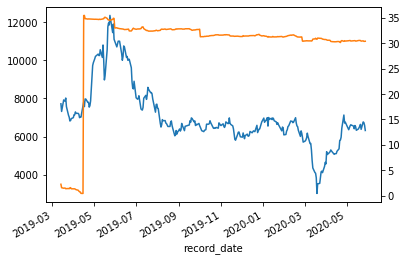

445    디아이동일
Name: name, dtype: object 3.561862251655604


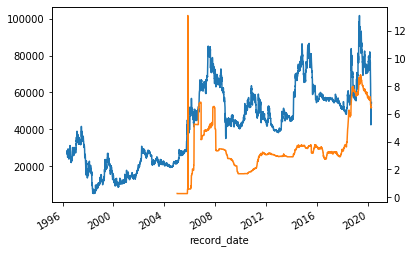

446    롯데제과
Name: name, dtype: object 21.813137876386715


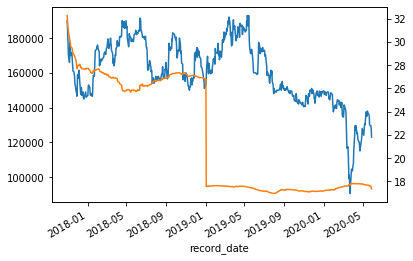

447    만호제강
Name: name, dtype: object 1.6964821192053137


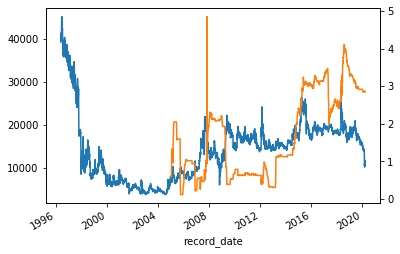

448    모나미
Name: name, dtype: object 1.8863152317880834


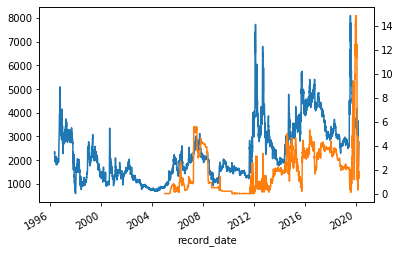

449    문배철강
Name: name, dtype: object 0.9785657764589533


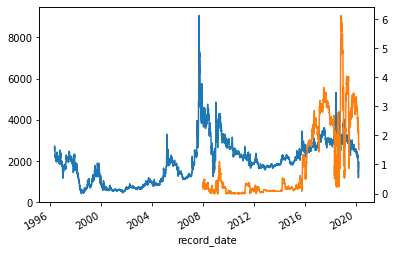

450    미래에셋생명
Name: name, dtype: object 6.467195325542561


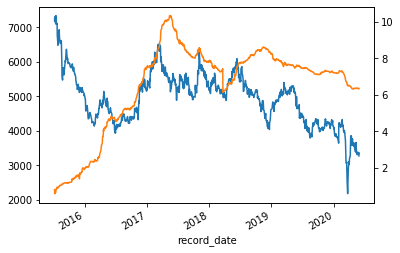

451    미원상사
Name: name, dtype: object 2.995570860927148


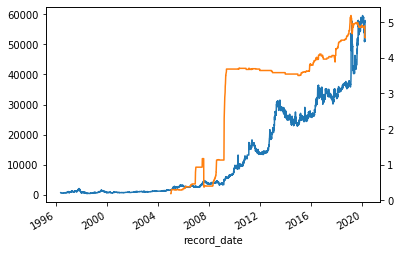

452    미창석유공업
Name: name, dtype: object 31.042993377483747


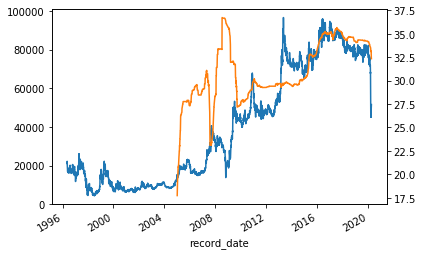

453    백광산업
Name: name, dtype: object 3.785316556291393


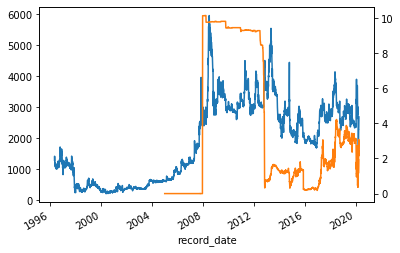

454    벽산
Name: name, dtype: object 8.441747444774164


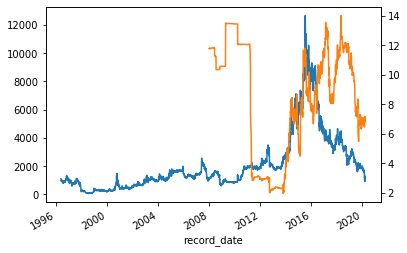

455    부광약품
Name: name, dtype: object 6.195602649006636


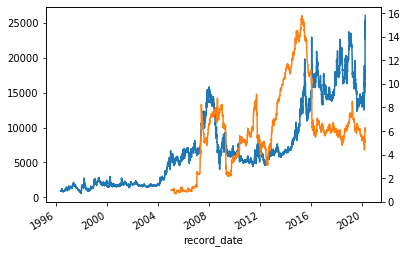

456    부국철강
Name: name, dtype: object 4.022337577538377


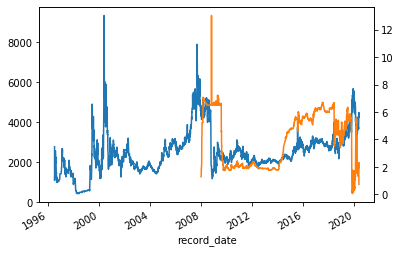

457    부산도시가스
Name: name, dtype: object 3.748433931484505


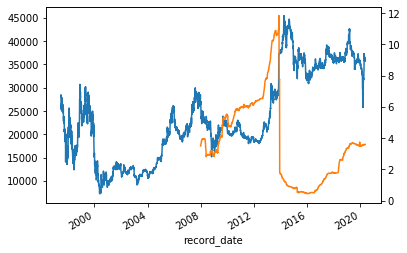

458    비상교육
Name: name, dtype: object 3.8722010869565193


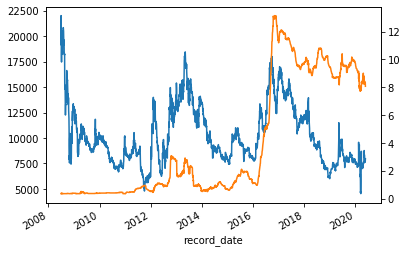

459    삼성공조
Name: name, dtype: object 11.029086712825615


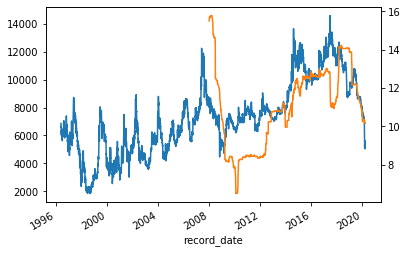

460    삼성생명
Name: name, dtype: object 13.084650505050483


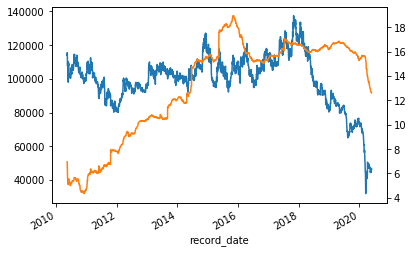

461    삼성전기
Name: name, dtype: object 18.197045829211945


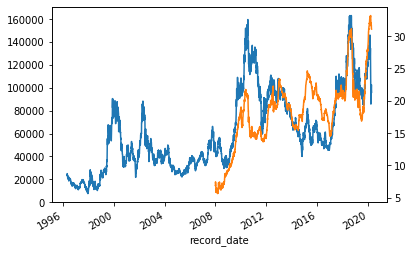

462    삼양패키징
Name: name, dtype: object 10.27022988505747


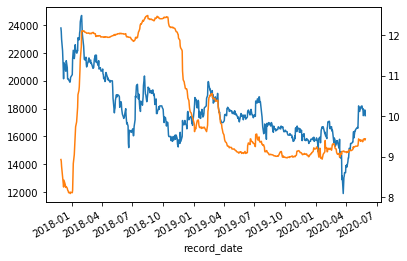

463    삼화전기
Name: name, dtype: object 23.702954170787965


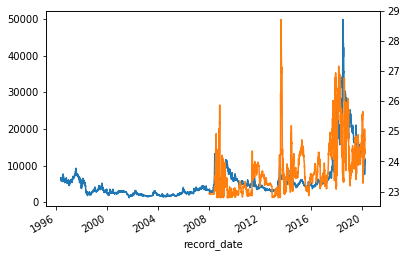

464    샘표
Name: name, dtype: object 3.1505703923508084


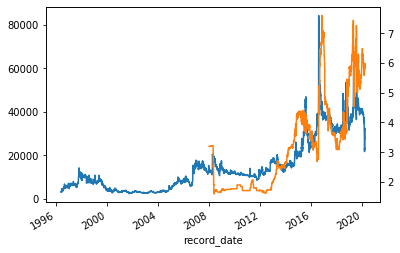

465    서흥
Name: name, dtype: object 5.701427629409835


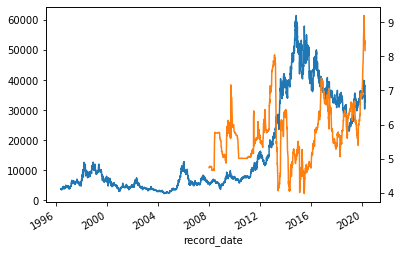

466    세진중공업
Name: name, dtype: object 1.1337943585077346


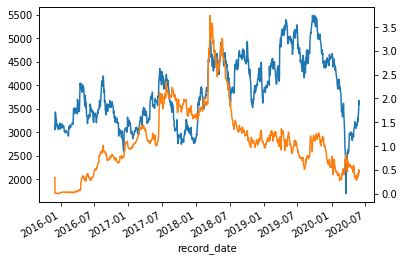

467    수산중공업
Name: name, dtype: object 1.2365350734094636


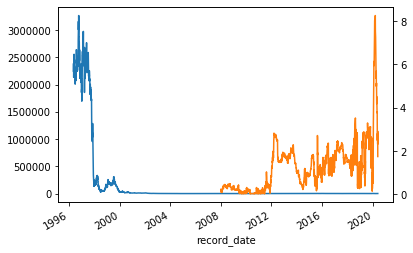

468    신세계I&C
Name: name, dtype: object 6.7136541598695025


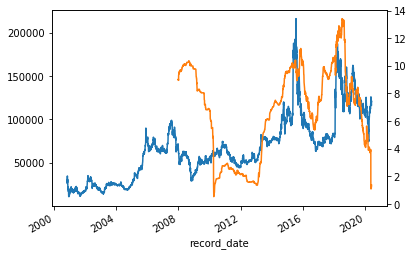

469    신세계건설
Name: name, dtype: object 11.948616639478024


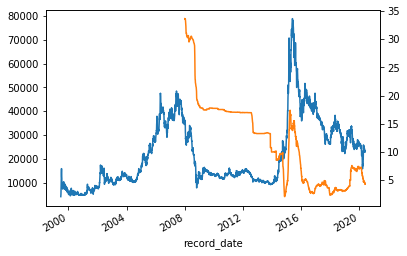

470    신원
Name: name, dtype: object 3.844276294098249


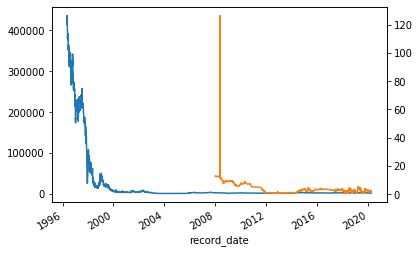

471    쎌마테라퓨틱스
Name: name, dtype: object 1.1406296900489377


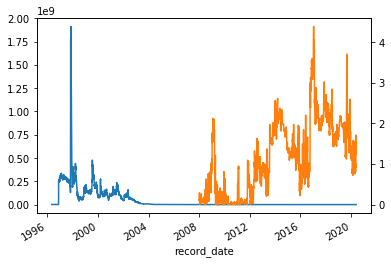

472    에이프로젠 KIC
Name: name, dtype: object 1.9896604022420092


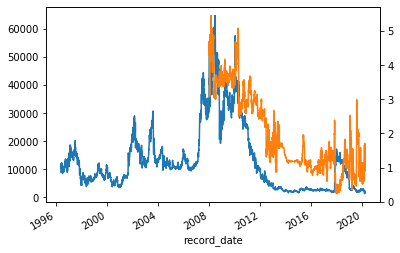

473    오리온
Name: name, dtype: object 40.029900709219845


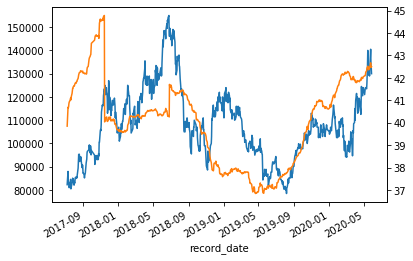

474    우리금융지주
Name: name, dtype: object 29.676656151419575


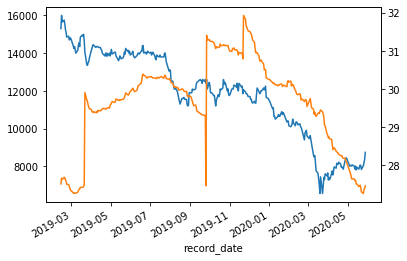

475    우리종금
Name: name, dtype: object 1.0490735245631382


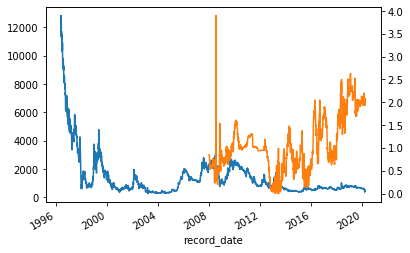

476    우성사료
Name: name, dtype: object 2.8198318496538044


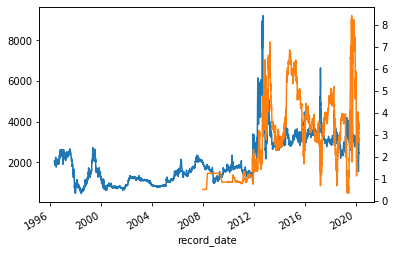

477    웰바이오텍
Name: name, dtype: object 0.9687767886580934


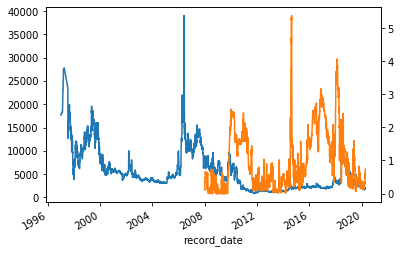

478    이아이디
Name: name, dtype: object 0.7055040783034249


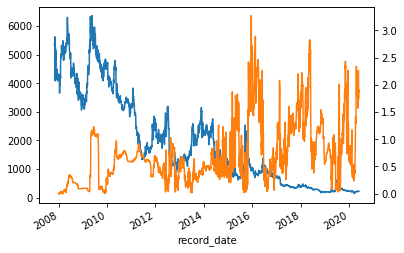

479    인천도시가스
Name: name, dtype: object 0.3387047308319746


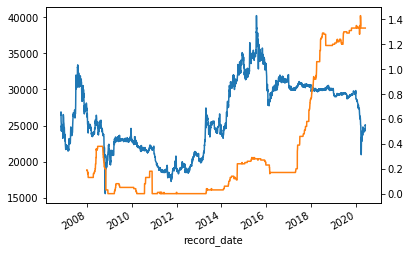

480    일동홀딩스
Name: name, dtype: object 13.707997350993312


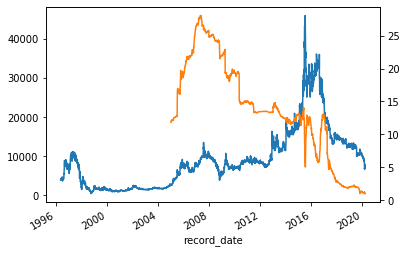

481    일진머티리얼즈
Name: name, dtype: object 3.179256489221289


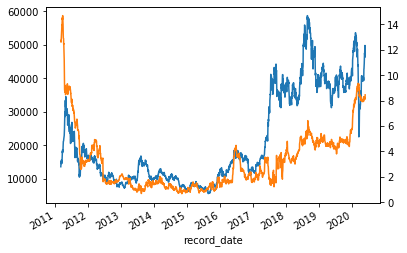

482    조광피혁
Name: name, dtype: object 0.8302993377483435


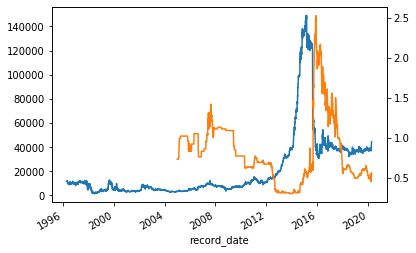

483    조일알미늄
Name: name, dtype: object 4.608734094616645


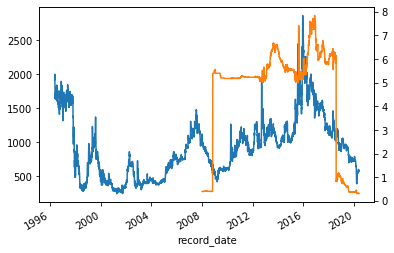

484    진흥기업
Name: name, dtype: object 0.5810357615894022


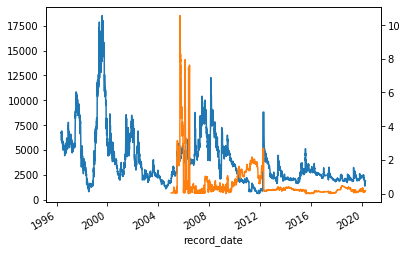

485    청호컴넷
Name: name, dtype: object 11.013076672104473


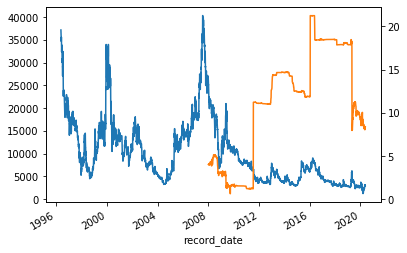

486    카카오
Name: name, dtype: object 30.398000000000003


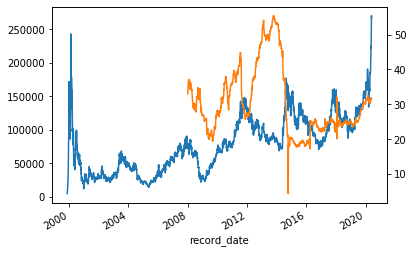

487    케이씨티시
Name: name, dtype: object 0.5241641938674539


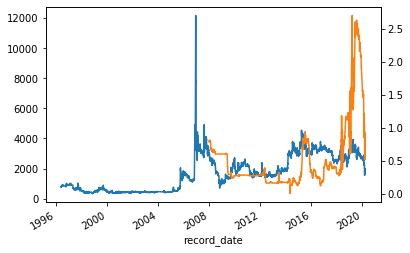

488    케이티스카이라이프
Name: name, dtype: object 13.866095022624414


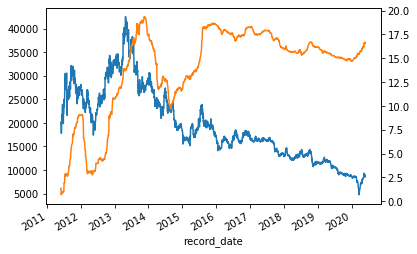

489    코리안리
Name: name, dtype: object 37.84266225165565


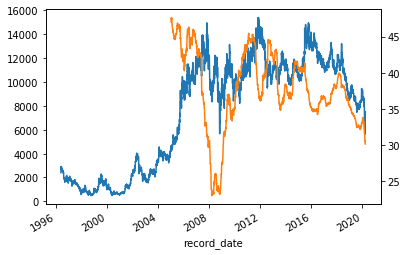

490    크라운해태홀딩스
Name: name, dtype: object 5.080649521925486


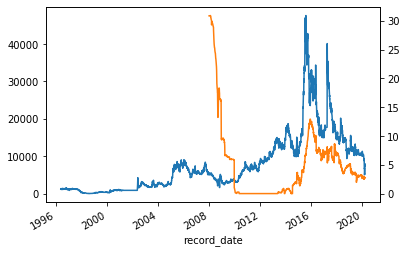

491    태림포장
Name: name, dtype: object 1.679070146818923


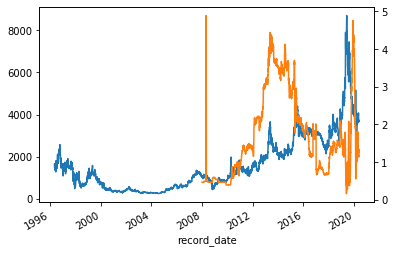

492    태원물산
Name: name, dtype: object 0.5845430463576164


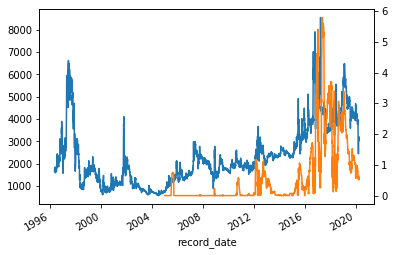

493    팬오션
Name: name, dtype: object 5.872267536704736


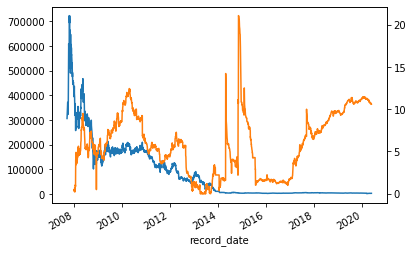

494    평화산업
Name: name, dtype: object 3.4079477977161448


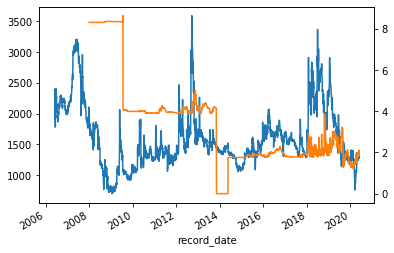

495    한국타이어앤테크놀로지
Name: name, dtype: object 40.560378263185925


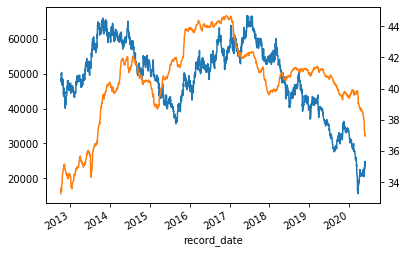

496    한국프랜지공업
Name: name, dtype: object 3.795783053082756


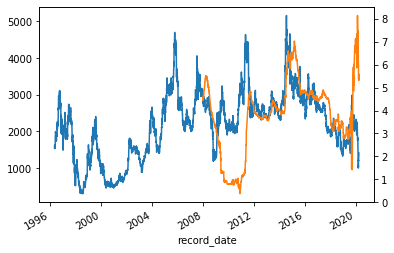

497    한미글로벌
Name: name, dtype: object 2.287220163083754


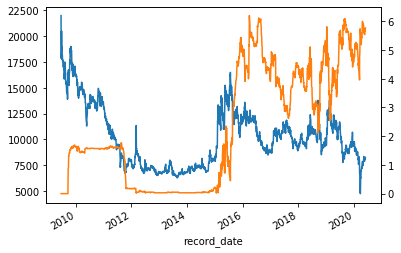

498    한솔케미칼
Name: name, dtype: object 7.249768352365421


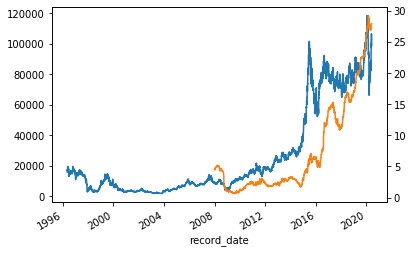

499    한솔테크닉스
Name: name, dtype: object 6.534400000000014


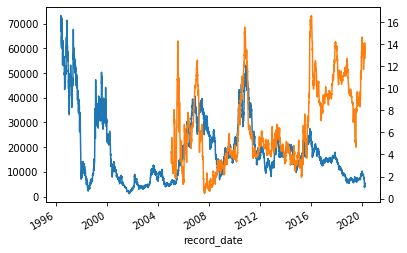

500    한온시스템
Name: name, dtype: object 59.982293637846695


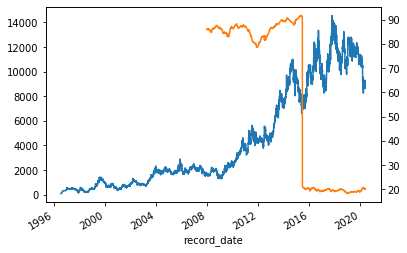

501    현대로템
Name: name, dtype: object 16.306360818350903


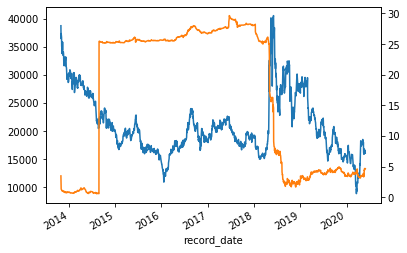

502    현대상선
Name: name, dtype: object 11.435047308319744


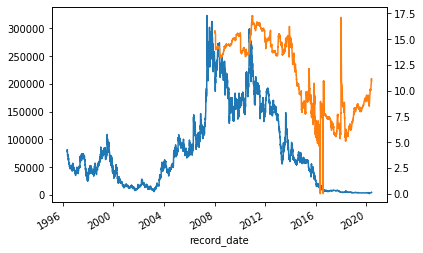

503    현대오토에버
Name: name, dtype: object 1.343066202090592


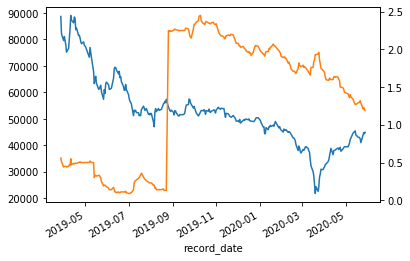

504    형지엘리트
Name: name, dtype: object 0.31047546595663744


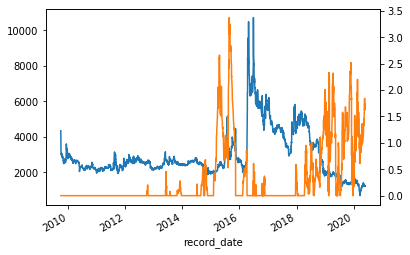

505    혜인
Name: name, dtype: object 2.144423841059608


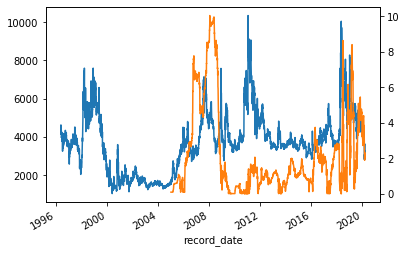

506    화성산업
Name: name, dtype: object 12.092007947019825


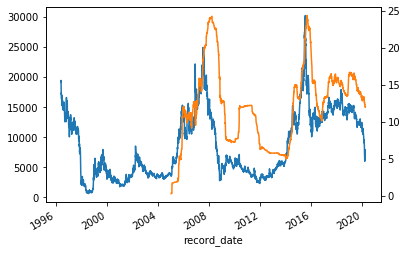

507    화승엔터프라이즈
Name: name, dtype: object 6.027091722595077


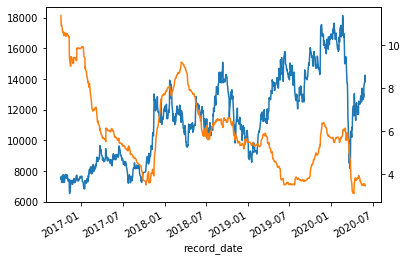

508    휠라홀딩스
Name: name, dtype: object 31.780058798824033


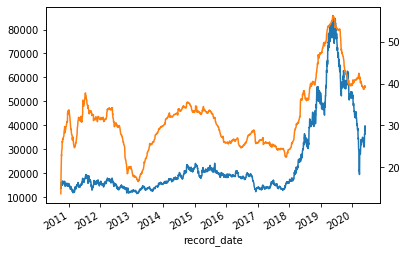

509    휴비스
Name: name, dtype: object 6.562690980778705


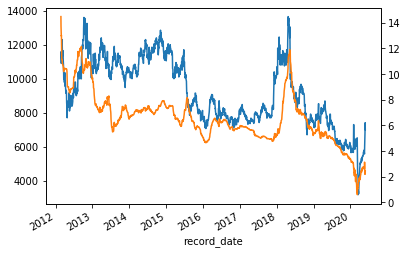

510    흥아해운
Name: name, dtype: object 37.07642119205296


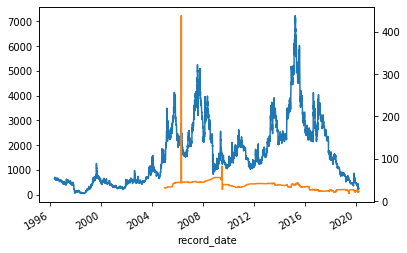

511    DB
Name: name, dtype: object 2.0271810766721123


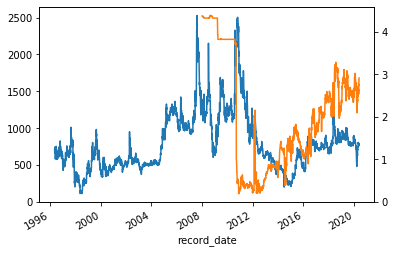

512    DB손해보험
Name: name, dtype: object 39.280609957138076


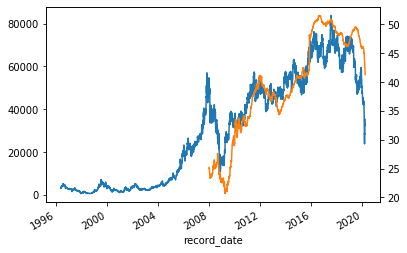

513    F&F
Name: name, dtype: object 10.722429937355786


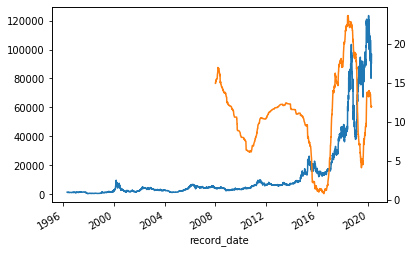

514    GS리테일
Name: name, dtype: object 16.748631010794895


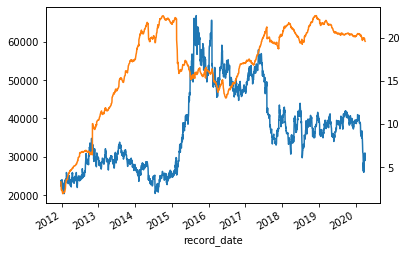

515    HDC
Name: name, dtype: object 48.518166394780025


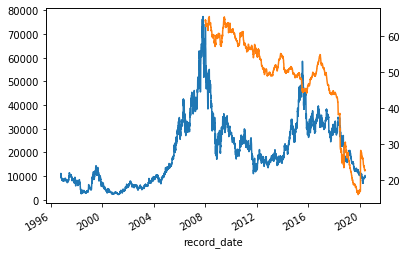

516    JW생명과학
Name: name, dtype: object 5.274059293044475


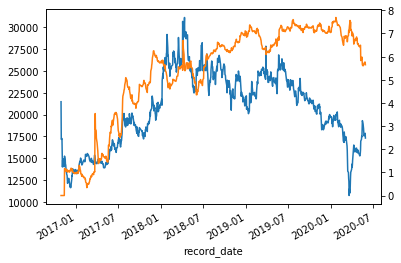

517    KC그린홀딩스
Name: name, dtype: object 3.108180019782385


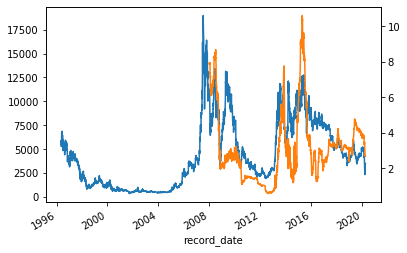

518    KR모터스
Name: name, dtype: object 6.771303311258275


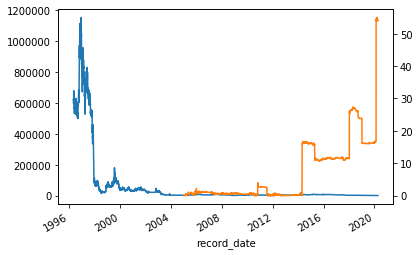

519    LG유플러스
Name: name, dtype: object 33.42006201044379


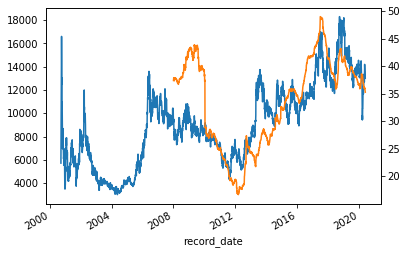

520    LG전자
Name: name, dtype: object 26.17292006525288


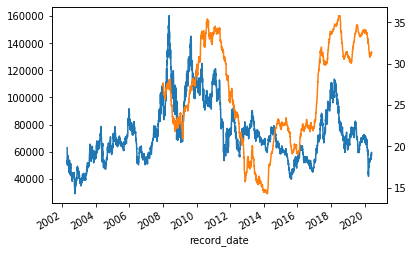

521    STX중공업
Name: name, dtype: object 5.931064220183526


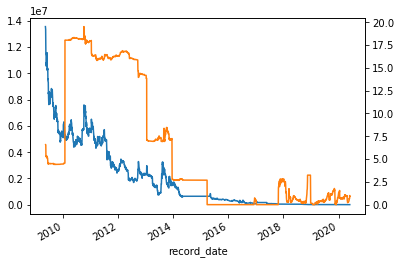

522    경농
Name: name, dtype: object 0.8030278145695324


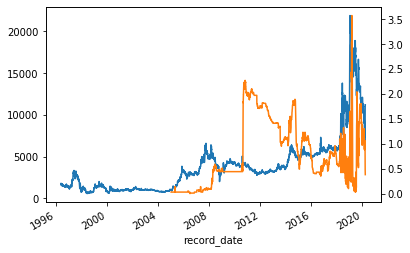

523    경방
Name: name, dtype: object 1.4596000000000018


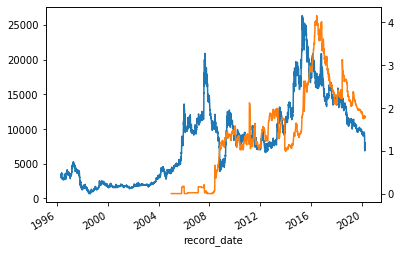

524    계양전기
Name: name, dtype: object 3.93274388254486


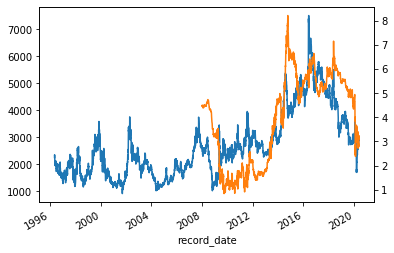

525    광동제약
Name: name, dtype: object 17.2133300362677


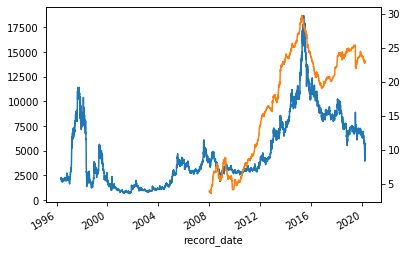

526    교보증권
Name: name, dtype: object 6.1434290375203915


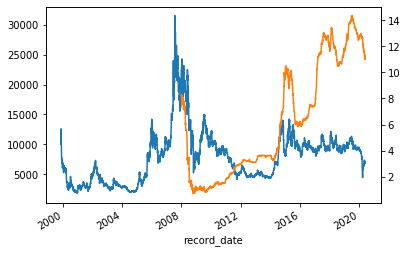

527    국도화학
Name: name, dtype: object 31.35953511374866


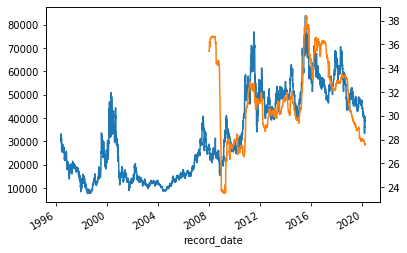

528    금비
Name: name, dtype: object 2.956644671725523


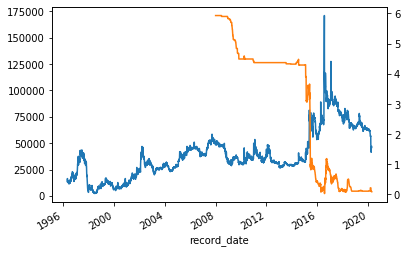

529    금호타이어
Name: name, dtype: object 7.387719412724314


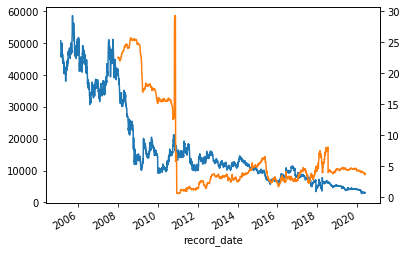

530    기아자동차
Name: name, dtype: object 30.99274437086092


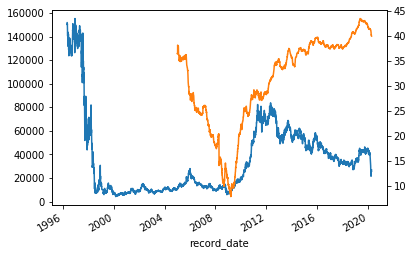

531    남해화학
Name: name, dtype: object 4.543791190864601


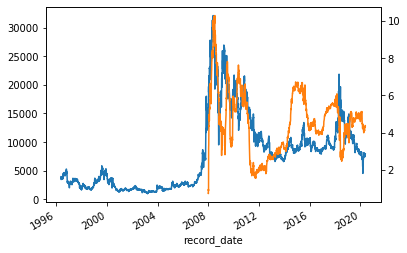

532    넷마블
Name: name, dtype: object 24.84970430107527


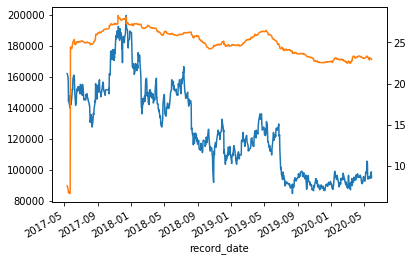

533    대림산업
Name: name, dtype: object 41.74329536423843


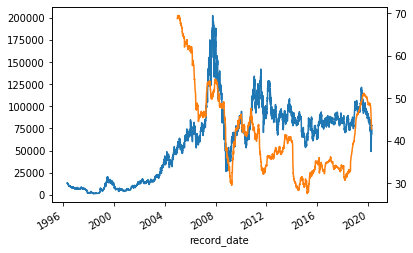

534    대림통상
Name: name, dtype: object 1.4749571240105552


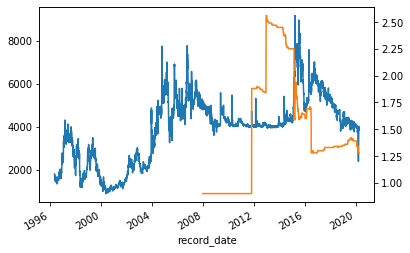

535    대웅
Name: name, dtype: object 3.2062649006622426


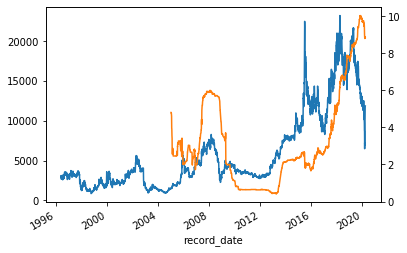

536    대원강업
Name: name, dtype: object 2.7385615894039943


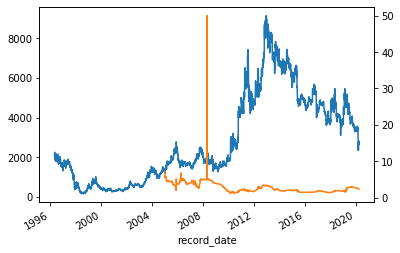

537    대원전선
Name: name, dtype: object 4.829953841081443


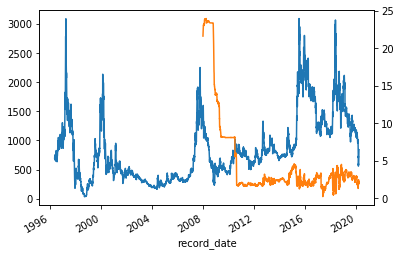

538    대원화성
Name: name, dtype: object 0.9555269168026098


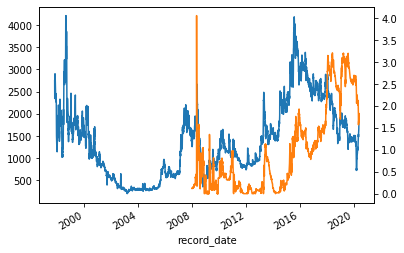

539    대유에이텍
Name: name, dtype: object 0.9449350993377462


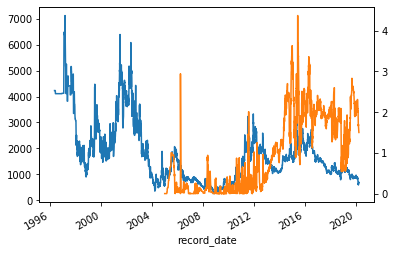

540    동부건설
Name: name, dtype: object 3.551668315199472


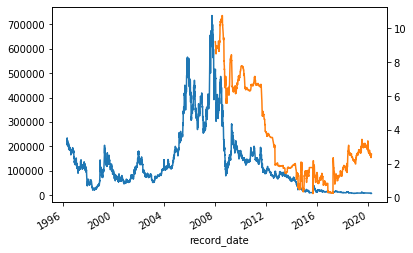

541    동성제약
Name: name, dtype: object 2.588747019867548


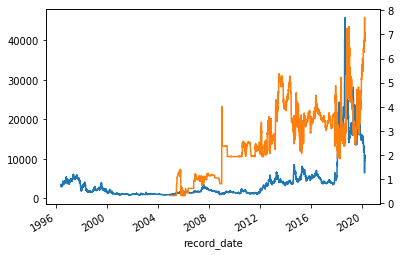

542    동양고속
Name: name, dtype: object 1.9509363784665614


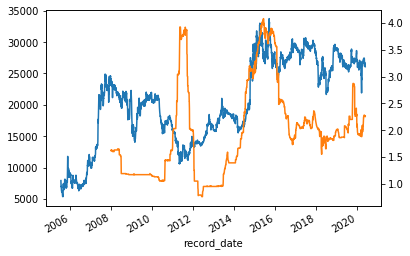

543    동양철관
Name: name, dtype: object 0.7235179690075837


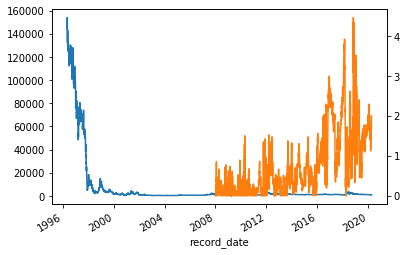

544    동원수산
Name: name, dtype: object 1.265699836867862


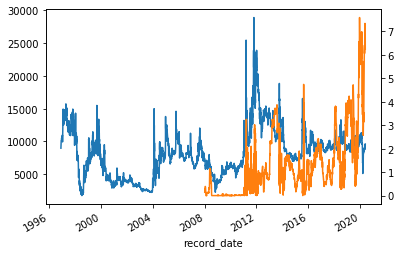

545    동일고무벨트
Name: name, dtype: object 2.9407395498392312


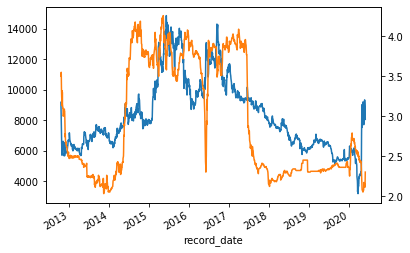

546    롯데쇼핑
Name: name, dtype: object 16.612933115823818


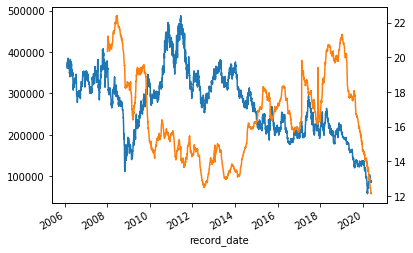

547    롯데정보통신
Name: name, dtype: object 1.8440401785714282


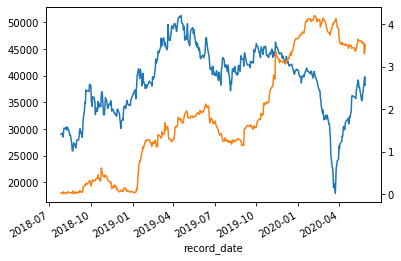

548    만도
Name: name, dtype: object 27.066093862815926


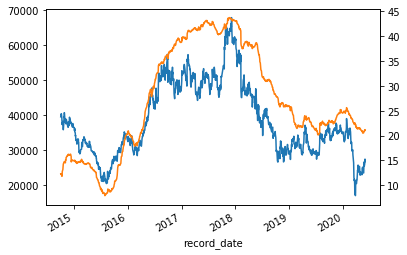

549    메리츠화재
Name: name, dtype: object 17.326047682119203


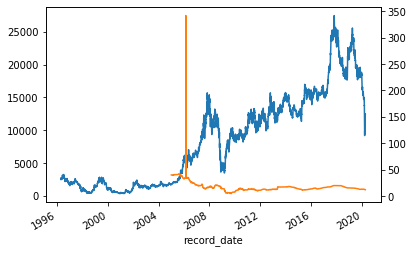

550    미원에스씨
Name: name, dtype: object 1.7586991869918744


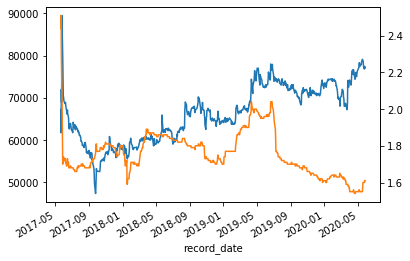

551    백광소재
Name: name, dtype: object 1.4142969004893975


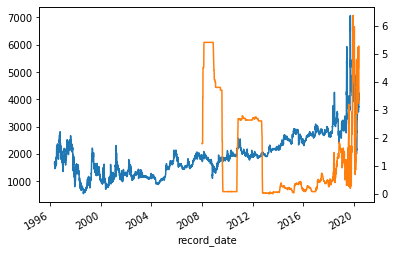

552    부산산업
Name: name, dtype: object 0.5195628058727589


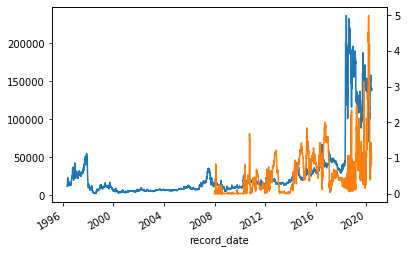

553    삼광글라스
Name: name, dtype: object 2.751072847682118


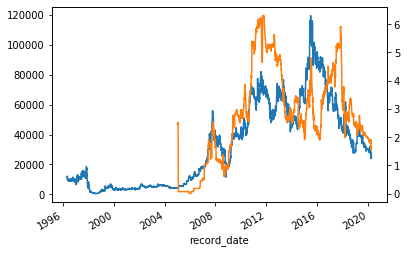

554    삼성엔지니어링
Name: name, dtype: object 27.355853181076625


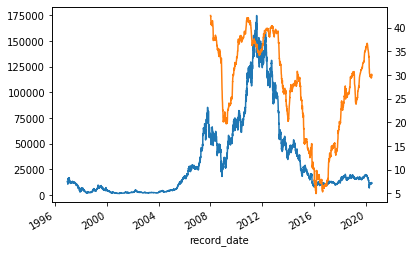

555    삼익악기
Name: name, dtype: object 3.260611920529789


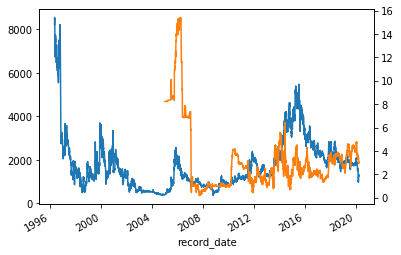

556    삼천리
Name: name, dtype: object 27.87813509933766


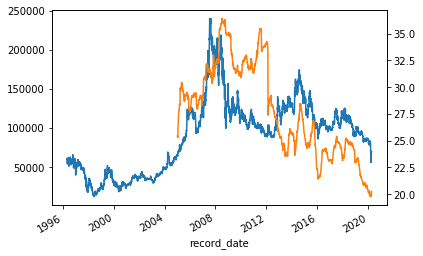

557    서울식품공업
Name: name, dtype: object 0.9507867549668859


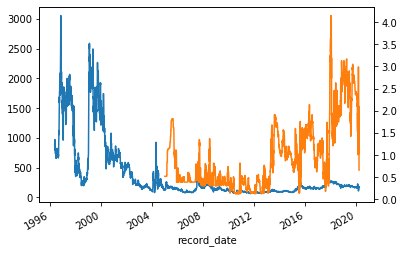

558    성창기업지주
Name: name, dtype: object 2.1534940397351043


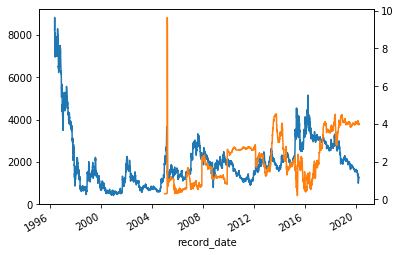

559    세종공업
Name: name, dtype: object 6.856300163132136


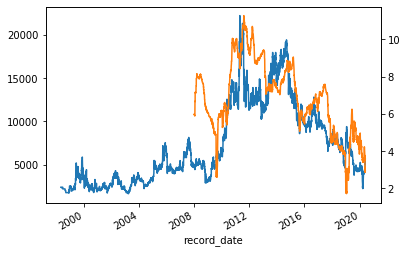

560    세하
Name: name, dtype: object 0.6114616639478063


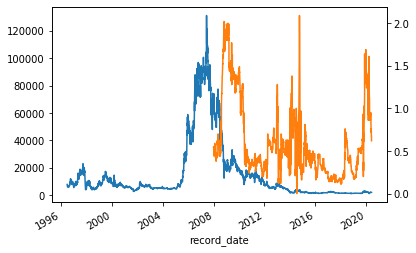

561    시디즈
Name: name, dtype: object 6.833661297344362


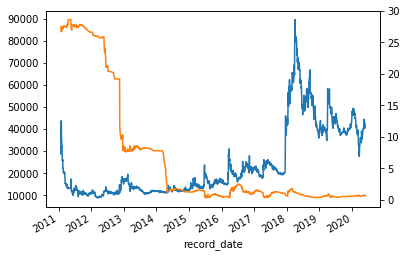

562    신한
Name: name, dtype: object 2.040725827814556


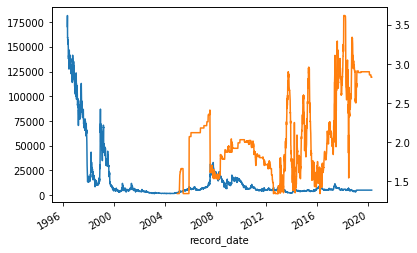

563    쌍용자동차
Name: name, dtype: object 70.63162119205313


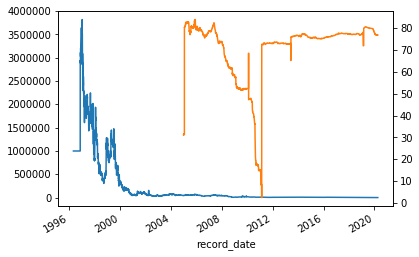

564    씨아이테크
Name: name, dtype: object 0.599719205298012


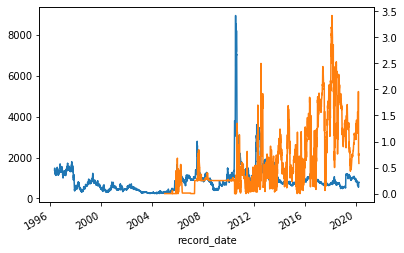

565    아모레퍼시픽그룹
Name: name, dtype: object 22.814190728476838


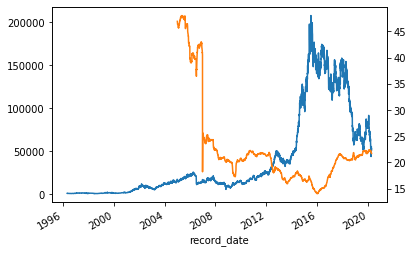

566    아시아나IDT
Name: name, dtype: object 0.44626016260162615


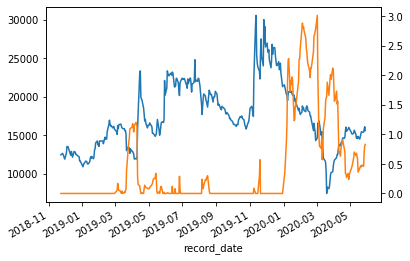

567    아주캐피탈
Name: name, dtype: object 0.5770437685459961


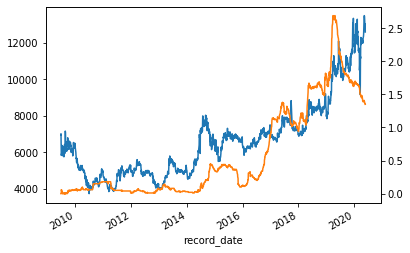

568    알루코
Name: name, dtype: object 1.2559047919293804


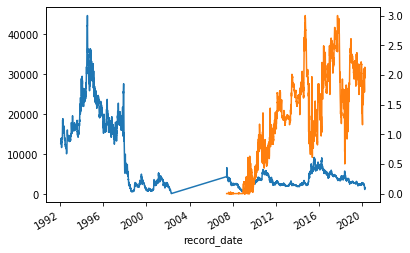

569    에스제이엠홀딩스
Name: name, dtype: object 9.258084828711251


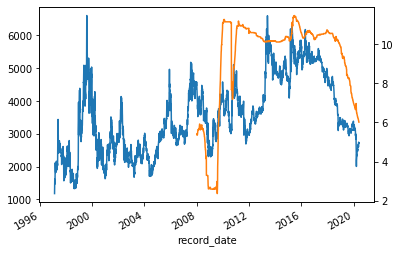

570    엘브이엠씨
Name: name, dtype: object 13.946952789699598


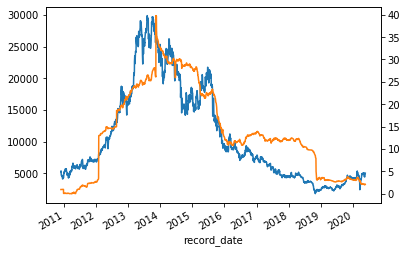

571    오뚜기
Name: name, dtype: object 17.349142762941


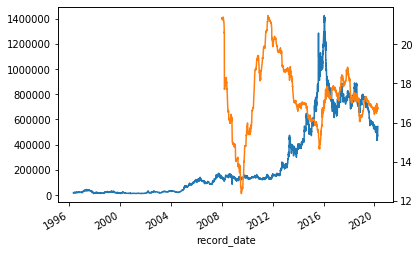

572    이구산업
Name: name, dtype: object 1.108838499184339


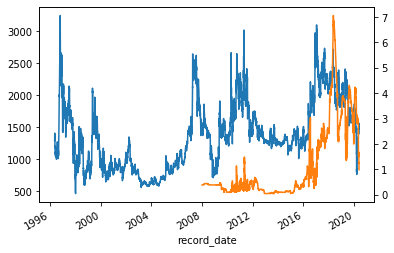

573    이수페타시스
Name: name, dtype: object 5.0993669634025744


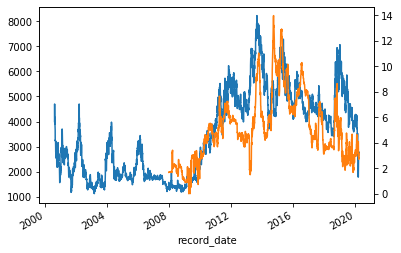

574    인디에프
Name: name, dtype: object 4.2932561174551385


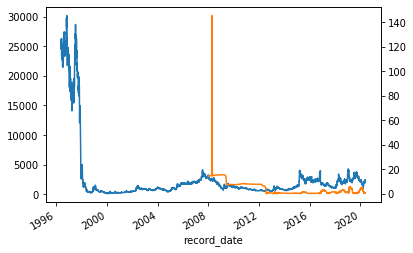

575    일진다이아
Name: name, dtype: object 1.610623164763457


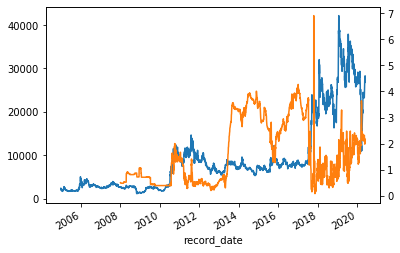

576    일진홀딩스
Name: name, dtype: object 1.8880848287112584


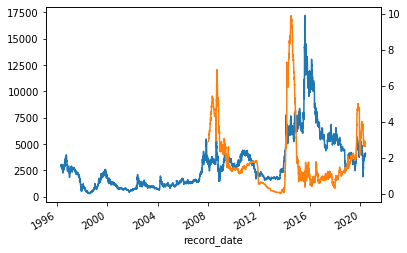

577    자화전자
Name: name, dtype: object 12.91246329526921


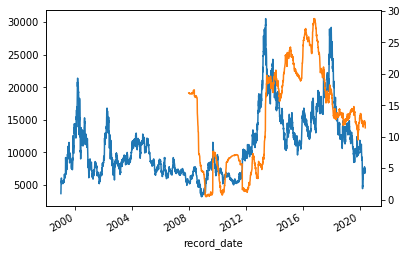

578    전방
Name: name, dtype: object 0.14126391096979132


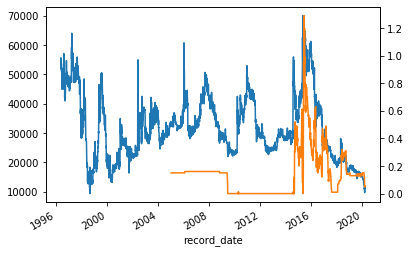

579    제이준코스메틱
Name: name, dtype: object 1.065735725938011


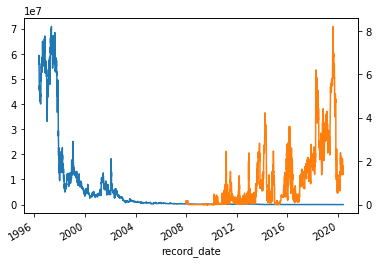

580    제이콘텐트리
Name: name, dtype: object 1.86534747145188


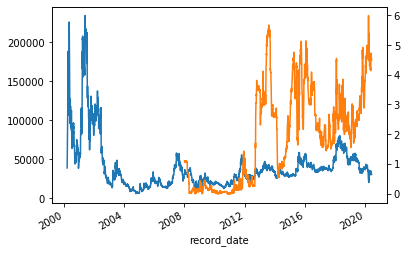

581    제일기획
Name: name, dtype: object 34.45607504078305


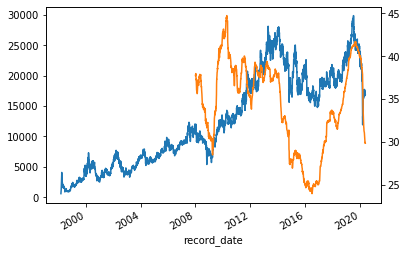

582    지투알
Name: name, dtype: object 32.56697553017942


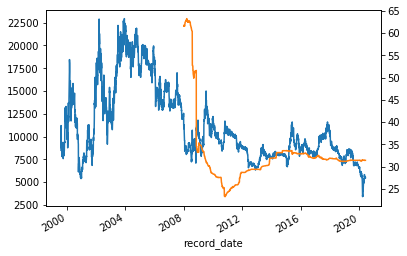

583    진양폴리우레탄
Name: name, dtype: object 0.5814540059347194


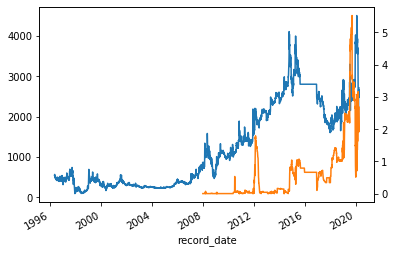

584    진원생명과학
Name: name, dtype: object 17.69148038245966


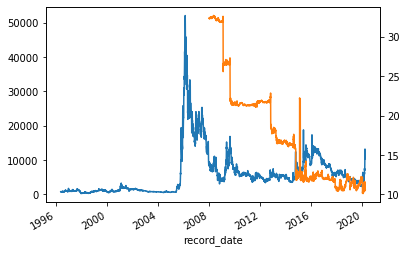

585    키위미디어그룹
Name: name, dtype: object 0.2916084828711253


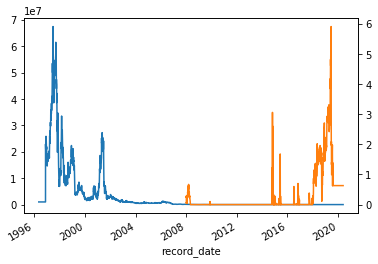

586    티에이치엔
Name: name, dtype: object 0.7471810766721056


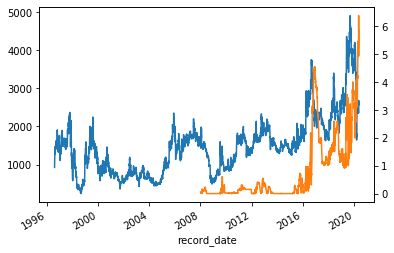

587    퍼스텍
Name: name, dtype: object 0.8052555225848986


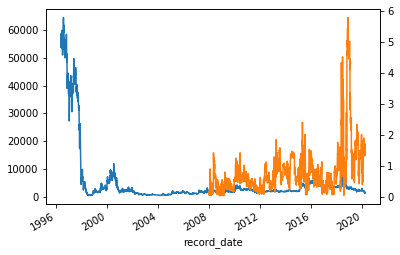

588    하이골드3호
Name: name, dtype: object 0.012463402322059511


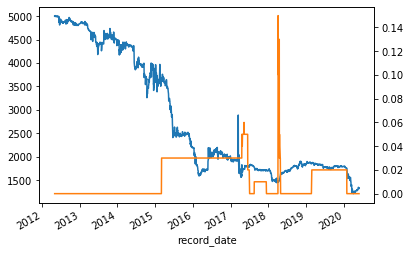

589    한국ANKOR유전
Name: name, dtype: object 0.014292079207920775


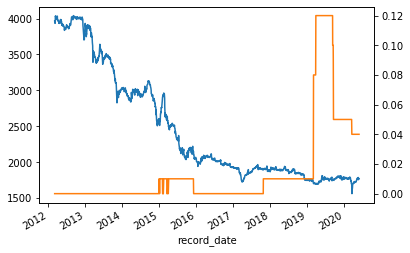

590    한국내화
Name: name, dtype: object 0.9501747444774138


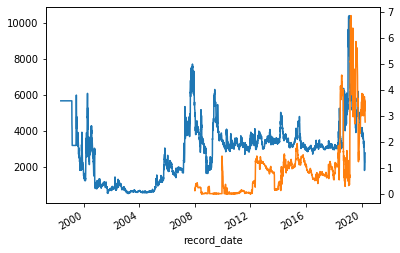

591    한국주철관공업
Name: name, dtype: object 2.4212688741721813


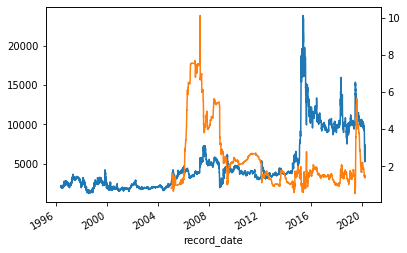

592    한국콜마
Name: name, dtype: object 41.38428724544473


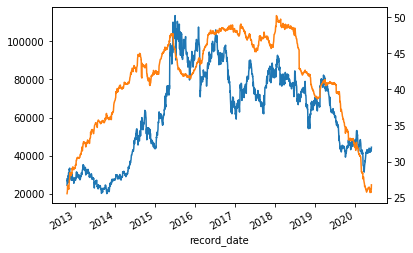

593    한국화장품
Name: name, dtype: object 1.132392363931761


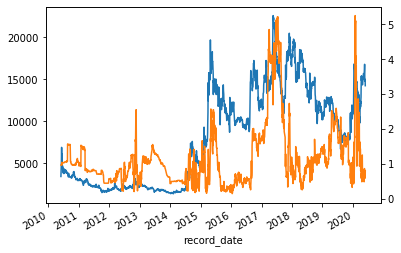

594    한라
Name: name, dtype: object 7.3305383360522205


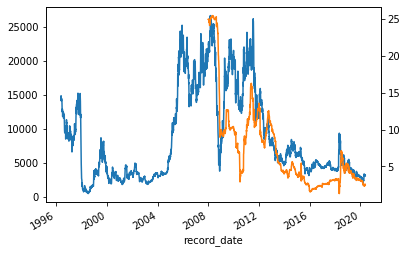

595    한미반도체
Name: name, dtype: object 6.1218270799347385


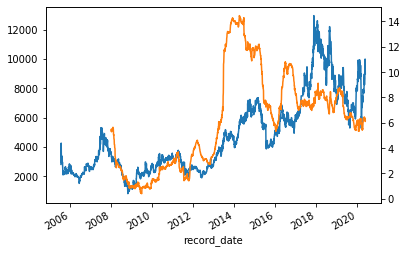

596    한섬
Name: name, dtype: object 21.59921370309955


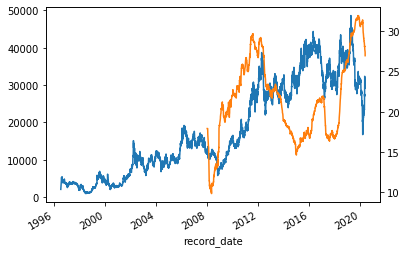

597    한세엠케이
Name: name, dtype: object 2.4704956798544835


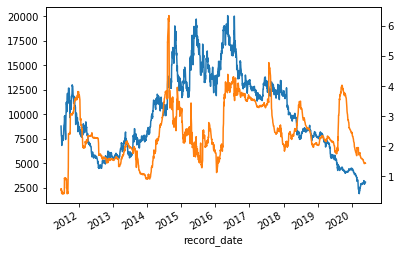

598    한솔제지
Name: name, dtype: object 13.400359052711972


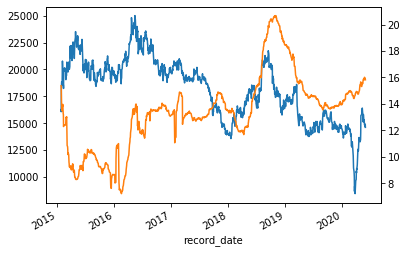

599    한솔홈데코
Name: name, dtype: object 2.655657422512233


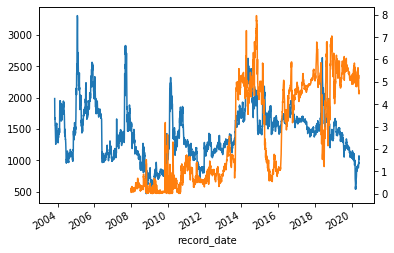

600    한올바이오파마
Name: name, dtype: object 2.1630069238377883


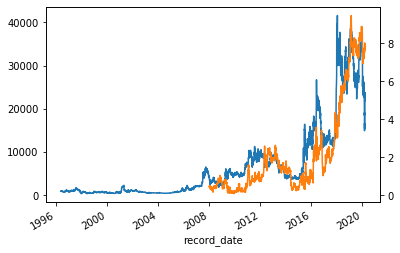

601    해성디에스
Name: name, dtype: object 1.707845993756502


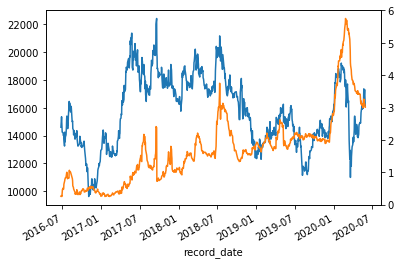

602    핸즈코퍼레이션
Name: name, dtype: object 0.773854289071682


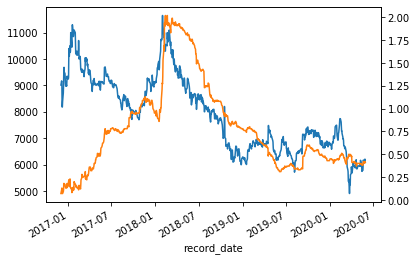

603    현대리바트
Name: name, dtype: object 3.96923327895595


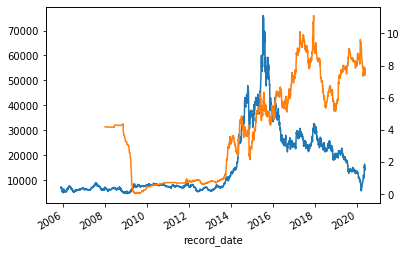

604    현대차증권
Name: name, dtype: object 6.163133774834433


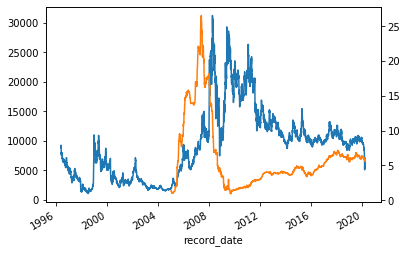

605    화천기계
Name: name, dtype: object 5.01943620178043


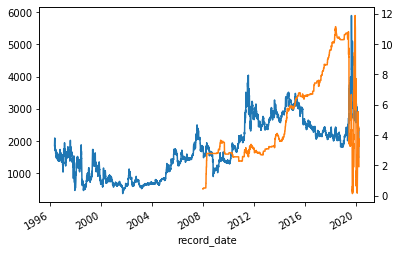

606    황금에스티
Name: name, dtype: object 3.070515497553022


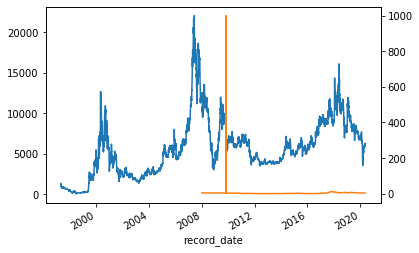

607    효성첨단소재
Name: name, dtype: object 10.899388646288207


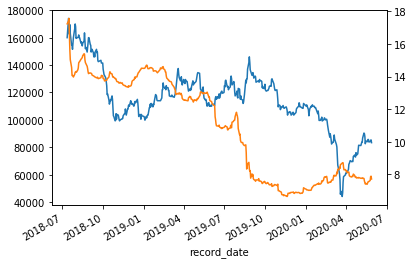

608    후성
Name: name, dtype: object 2.8187667210440392


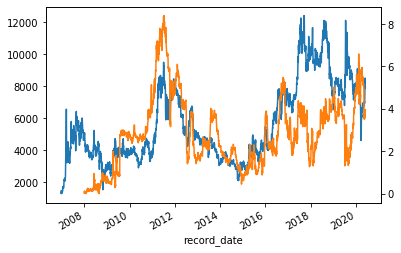

609    휴스틸
Name: name, dtype: object 6.615361589403959


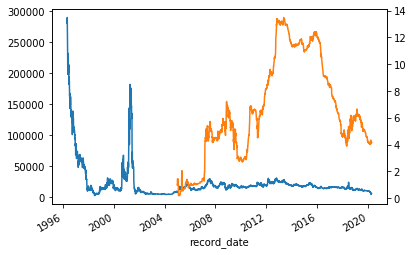

610    휴켐스
Name: name, dtype: object 10.360753670473098


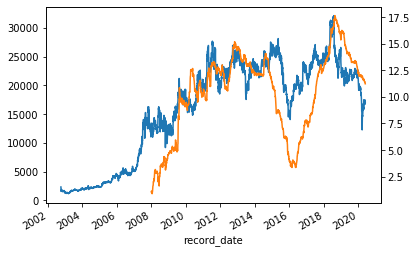

611    AK홀딩스
Name: name, dtype: object 18.23116056709527


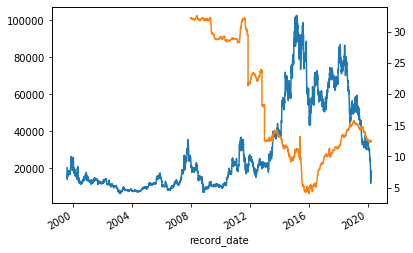

612    JB금융지주
Name: name, dtype: object 30.31133848899465


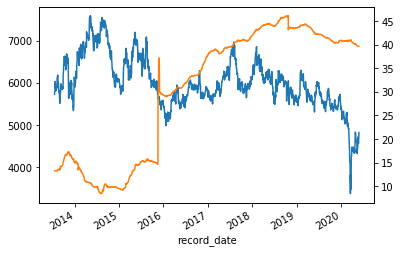

613    KC코트렐
Name: name, dtype: object 1.727697445972496


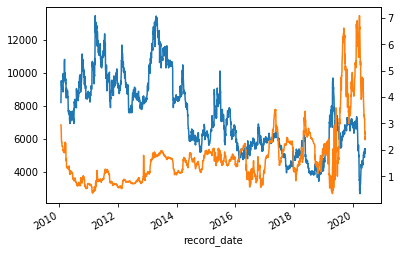

614    KG케미칼
Name: name, dtype: object 5.891843708609278


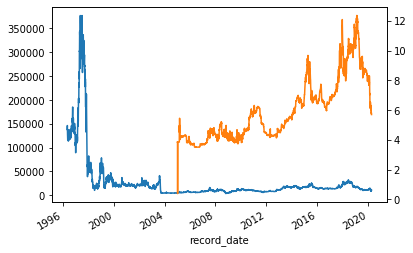

615    KTB투자증권
Name: name, dtype: object 14.021207177814034


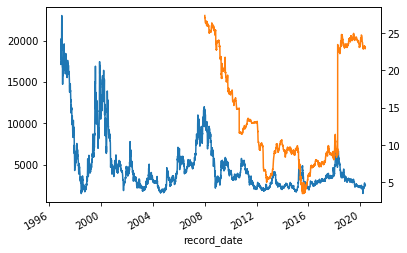

616    KTcs
Name: name, dtype: object 7.126965632858343


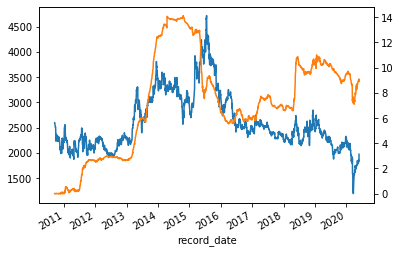

617    LG생활건강
Name: name, dtype: object 44.06824796084822


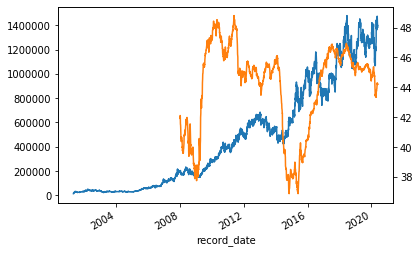

618    NICE
Name: name, dtype: object 8.1740554649266


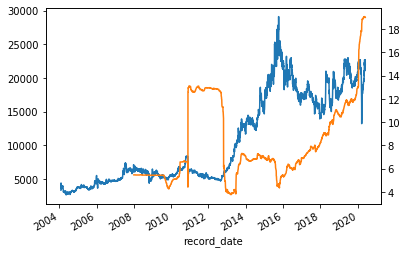

619    SG세계물산
Name: name, dtype: object 1.4413165562913934


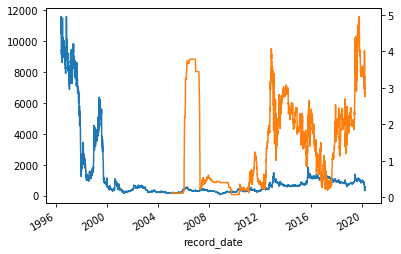

620    SIMPAC
Name: name, dtype: object 8.63307286515006


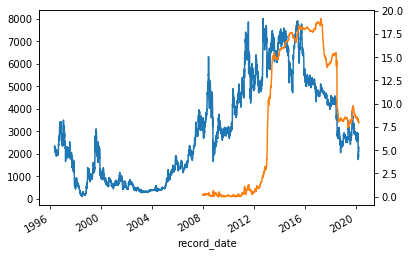

621    SK가스
Name: name, dtype: object 6.7364013050570914


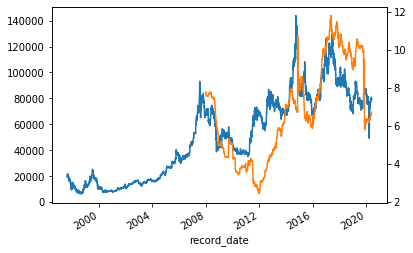

622    STX엔진
Name: name, dtype: object 4.912861337683534


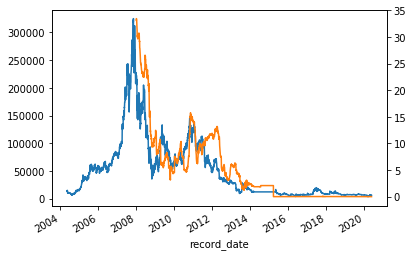

623    TCC스틸
Name: name, dtype: object 0.9392953642384057


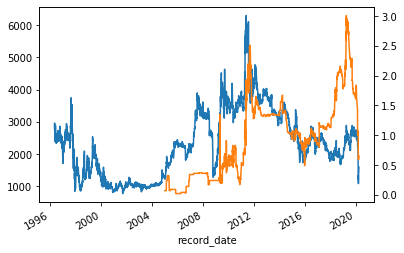

624    가온전선
Name: name, dtype: object 6.849454304635785


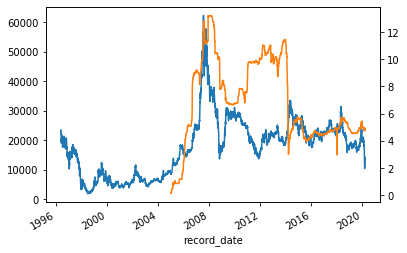

625    경보제약
Name: name, dtype: object 2.082547717842324


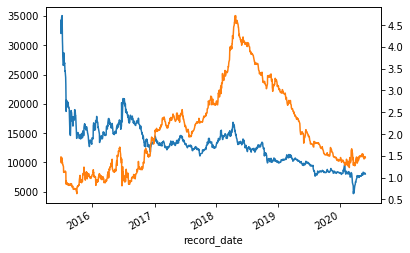

626    고려산업
Name: name, dtype: object 0.8121112582781466


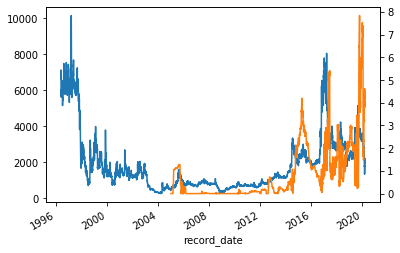

627    광전자
Name: name, dtype: object 16.725510603588884


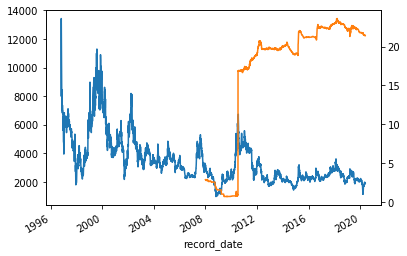

628    넥센
Name: name, dtype: object 5.682551928783351


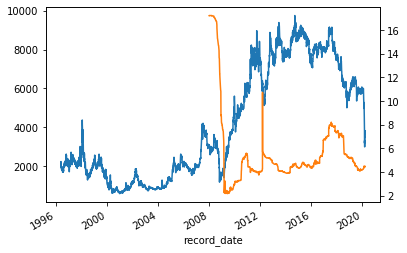

629    넥스트사이언스
Name: name, dtype: object 0.6606649006622457


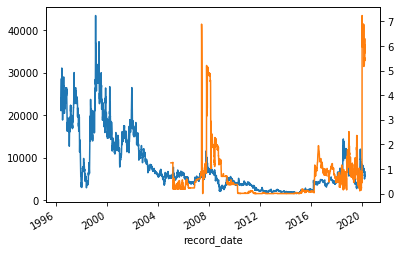

630    농심
Name: name, dtype: object 28.076749668874157


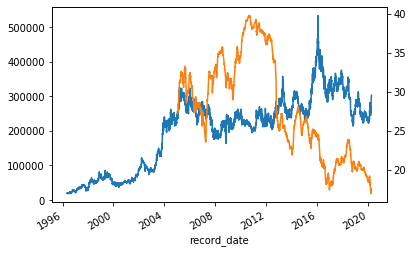

631    다우기술
Name: name, dtype: object 19.201983686786342


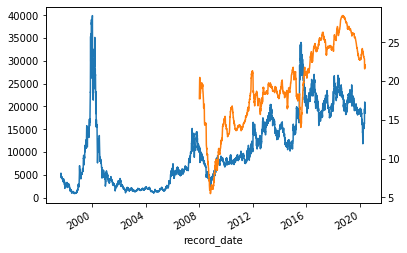

632    대동공업
Name: name, dtype: object 2.2892609271523185


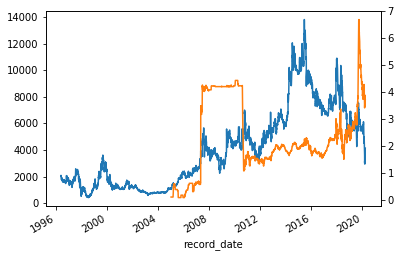

633    대림씨엔에스
Name: name, dtype: object 1.2046099290780103


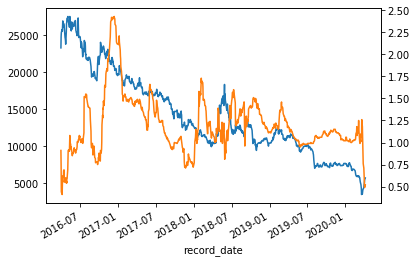

634    대성산업
Name: name, dtype: object 0.9270909090909113


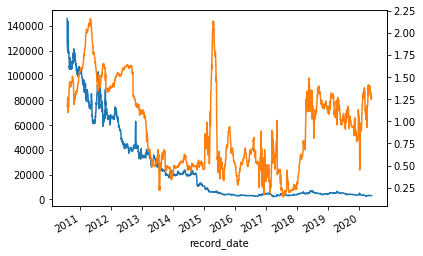

635    대유플러스
Name: name, dtype: object 1.6713139072847665


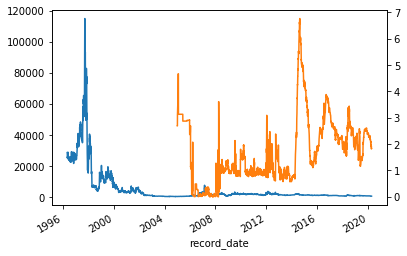

636    대한전선
Name: name, dtype: object 3.992373509933811


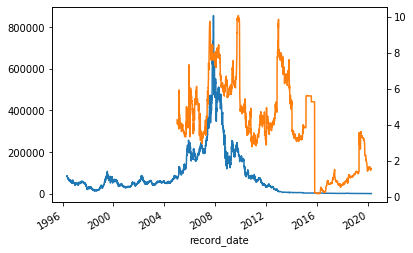

637    대한항공
Name: name, dtype: object 16.263517880794748


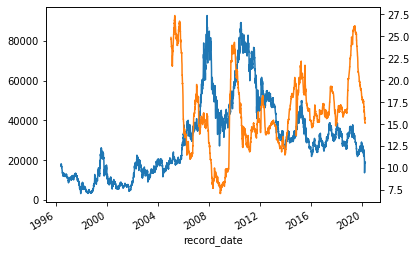

638    대한화섬
Name: name, dtype: object 4.657115231788089


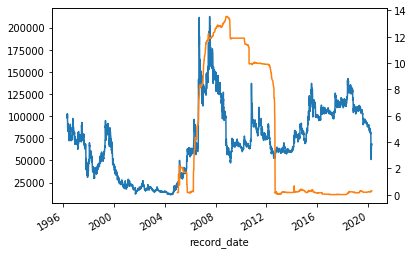

639    대호에이엘
Name: name, dtype: object 0.7428515497552993


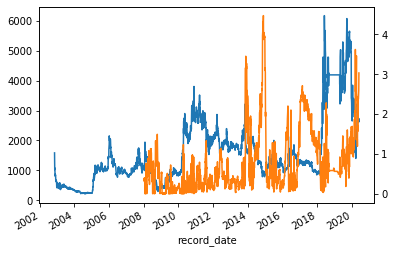

640    도화엔지니어링
Name: name, dtype: object 0.8490121899957962


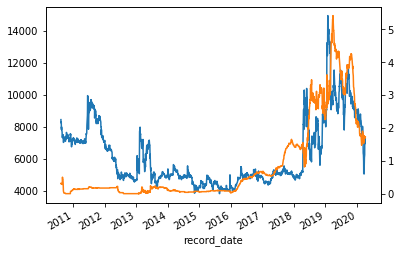

641    동방
Name: name, dtype: object 1.8169456953642433


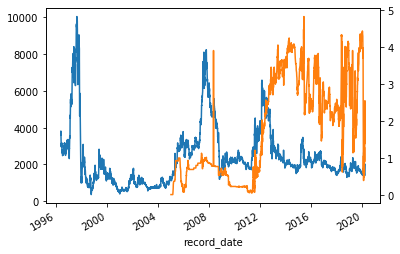

642    동북아13호선박투자
Name: name, dtype: object 0.0


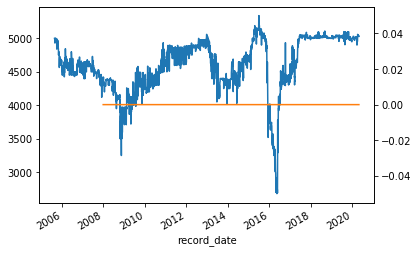

643    동아타이어
Name: name, dtype: object 3.7342036124794693


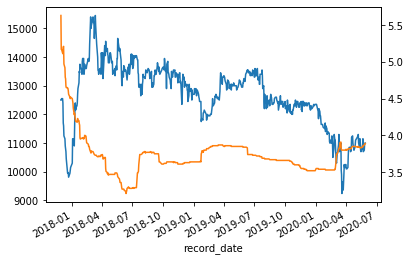

644    동양피스톤
Name: name, dtype: object 1.4310797342192687


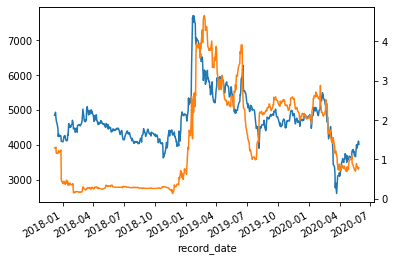

645    동원시스템즈
Name: name, dtype: object 0.9003621533442087


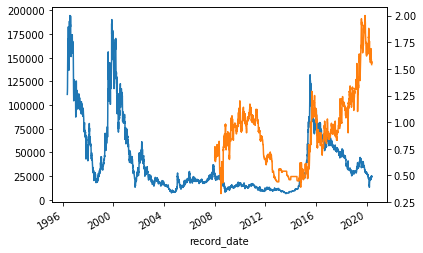

646    롯데리츠
Name: name, dtype: object 6.3785815602836875


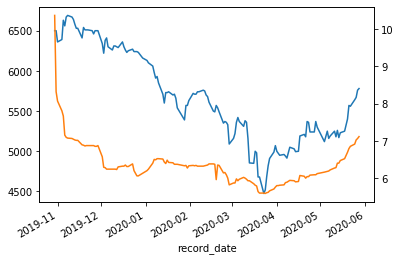

647    미래산업
Name: name, dtype: object 1.5763784665579148


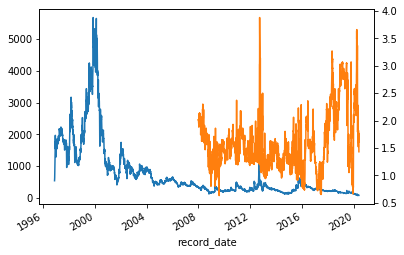

648    방림
Name: name, dtype: object 3.1395655629139565


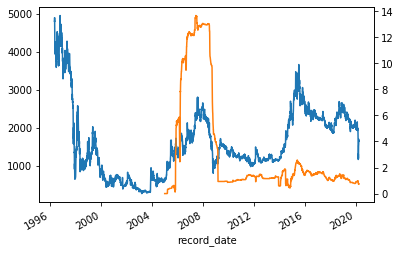

649    보령제약
Name: name, dtype: object 12.539774834437102


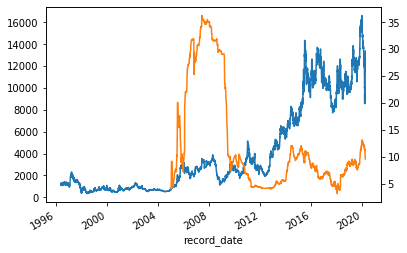

650    사조오양
Name: name, dtype: object 0.61938344873063


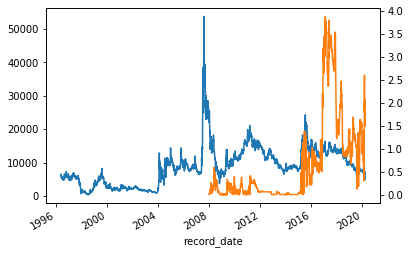

651    삼아알미늄
Name: name, dtype: object 33.449983514672226


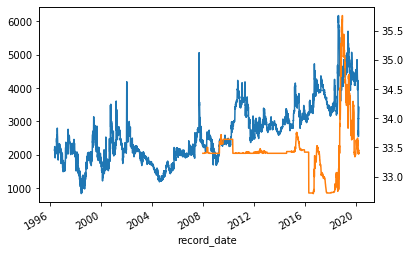

652    삼양사
Name: name, dtype: object 4.985662188099808


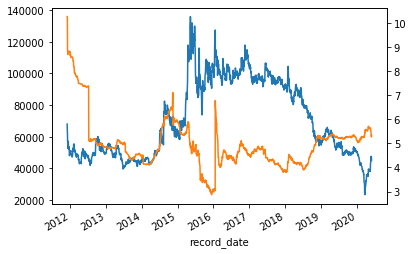

653    삼호개발
Name: name, dtype: object 8.42530827563468


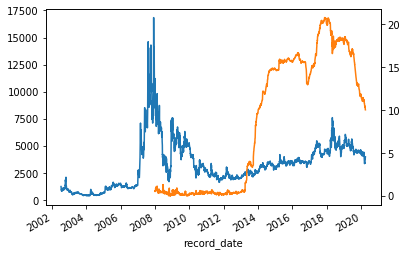

654    삼화전자공업
Name: name, dtype: object 1.6405774877650912


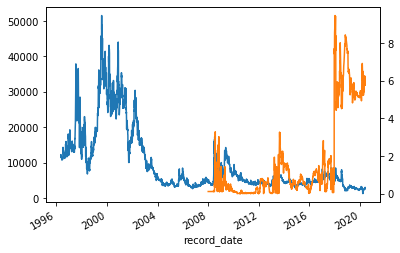

655    삼화콘덴서공업
Name: name, dtype: object 2.5283125827814596


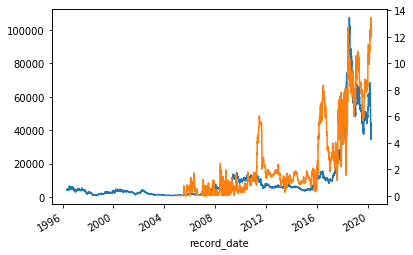

656    삼화페인트공업
Name: name, dtype: object 12.677568211920669


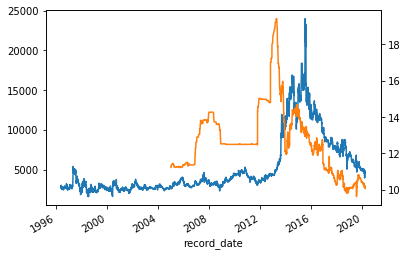

657    새론오토모티브
Name: name, dtype: object 65.59061337683512


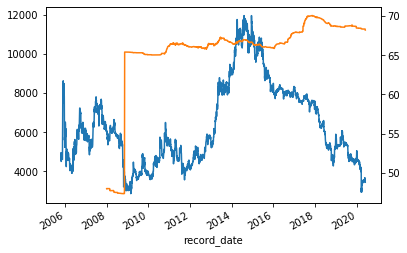

658    성문전자
Name: name, dtype: object 0.8649820554649259


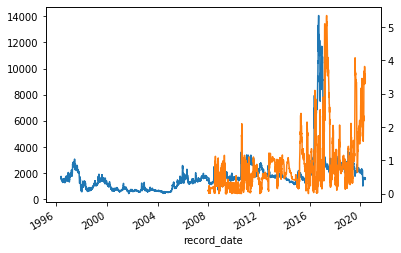

659    세아베스틸
Name: name, dtype: object 8.375329801324499


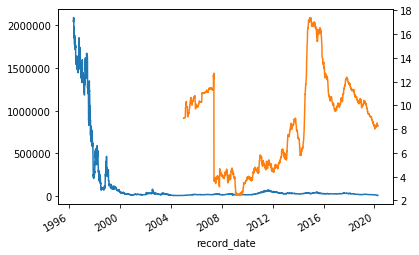

660    세아제강지주
Name: name, dtype: object 8.29818807947018


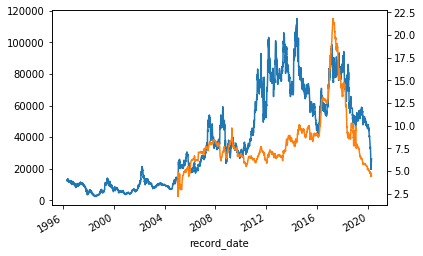

661    세화아이엠씨
Name: name, dtype: object 1.4224332810047269


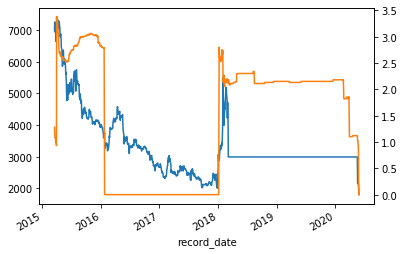

662    신도리코
Name: name, dtype: object 27.876727569331145


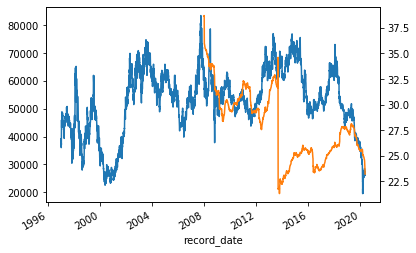

663    신세계
Name: name, dtype: object 42.521986754966974


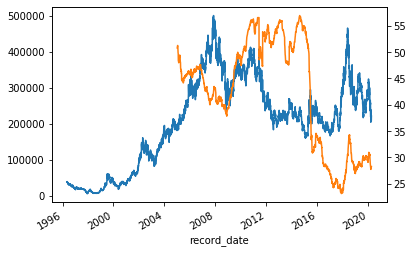

664    쌍용양회공업
Name: name, dtype: object 24.784966887417205


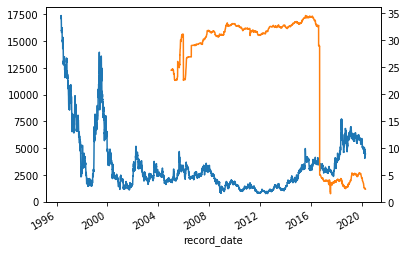

665    아남전자
Name: name, dtype: object 1.2103330036267759


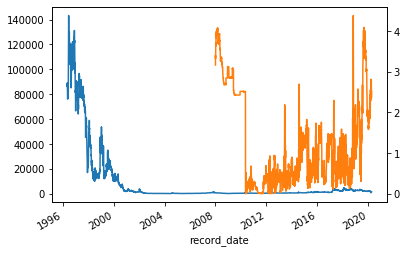

666    아세아제지
Name: name, dtype: object 5.298590728476799


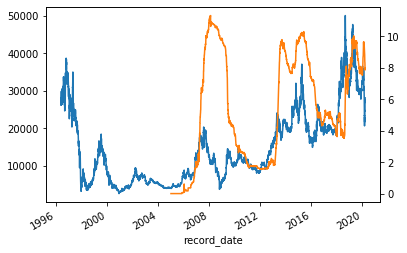

667    에스엘
Name: name, dtype: object 14.467441477085394


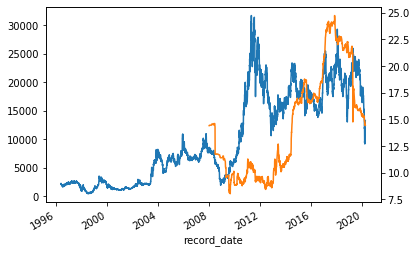

668    에쓰씨엔지니어링
Name: name, dtype: object 0.3980522022838502


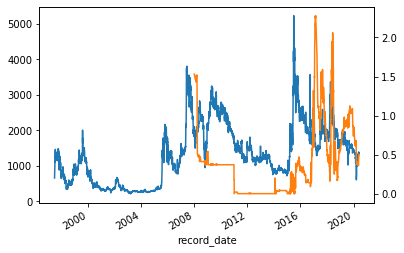

669    엔케이물산
Name: name, dtype: object 0.5790306627101884


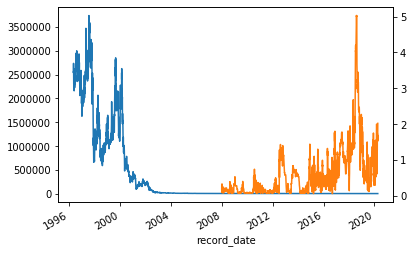

670    오리엔트바이오
Name: name, dtype: object 1.256111258278152


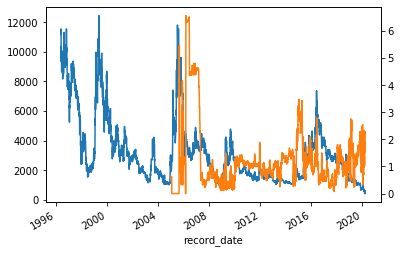

671    오리온홀딩스
Name: name, dtype: object 31.61866490066229


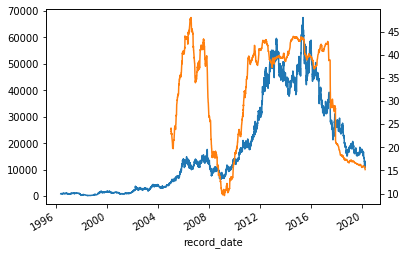

672    우리들휴브레인
Name: name, dtype: object 1.0824327485380134


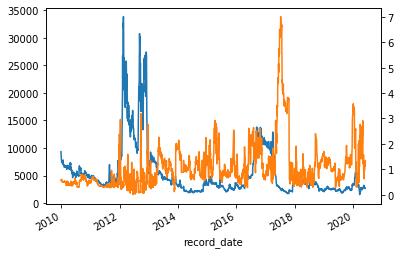

673    웅진
Name: name, dtype: object 2.3326786296900464


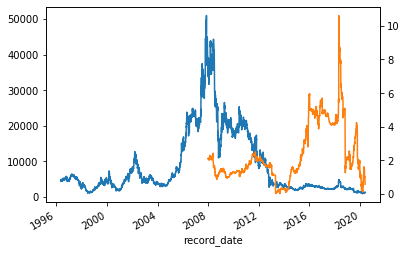

674    유니퀘스트
Name: name, dtype: object 55.33988907014678


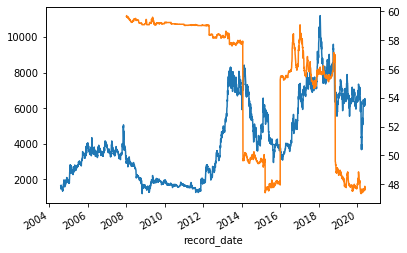

675    일신석재
Name: name, dtype: object 0.7760731948565782


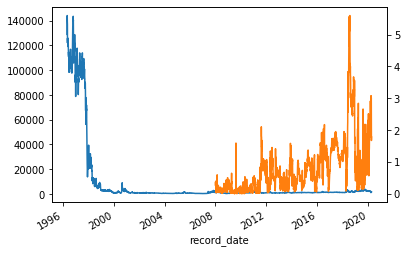

676    일양약품
Name: name, dtype: object 4.810972634355416


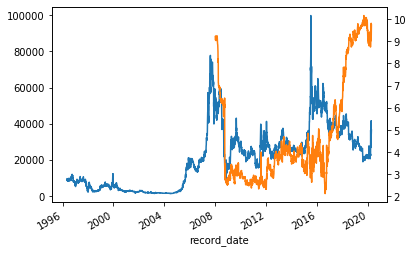

677    주연테크
Name: name, dtype: object 0.5861305057096268


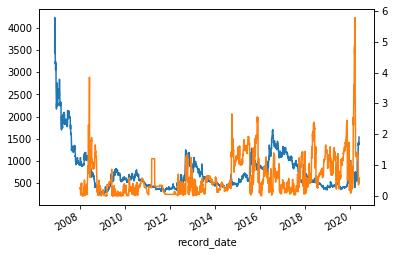

678    진양산업
Name: name, dtype: object 1.571822516556294


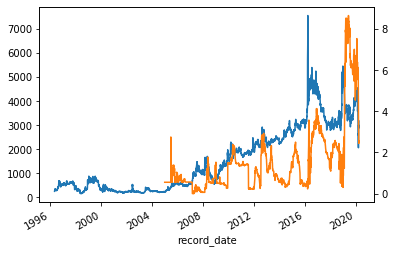

679    케이비아이동국실업
Name: name, dtype: object 2.514929801324501


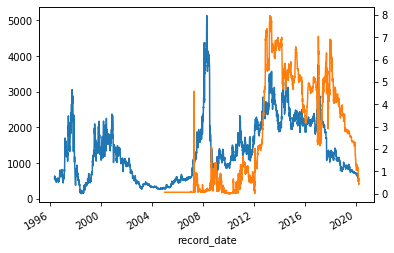

680    케이씨
Name: name, dtype: object 11.784916802610109


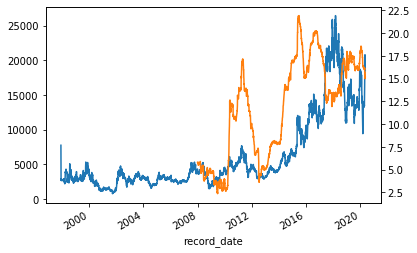

681    코오롱
Name: name, dtype: object 14.874704635761567


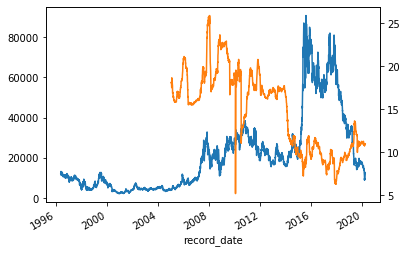

682    키움증권
Name: name, dtype: object 25.15128221859711


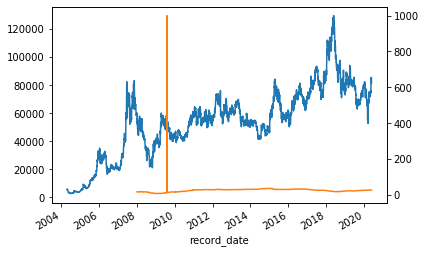

683    태경산업
Name: name, dtype: object 4.2646721044045215


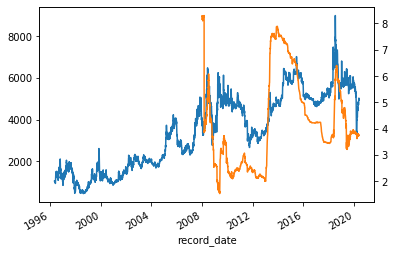

684    파미셀
Name: name, dtype: object 1.9949060336300743


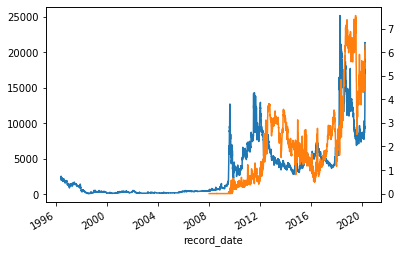

685    평화홀딩스
Name: name, dtype: object 20.464586218266003


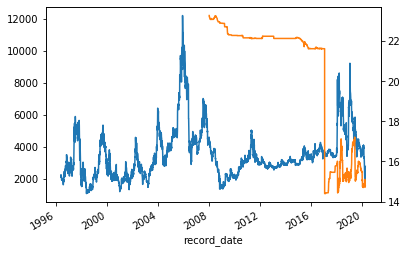

686    포스코인터내셔널
Name: name, dtype: object 10.251337683523658


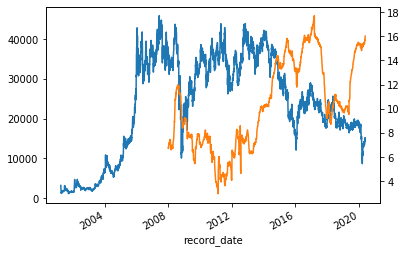

687    풀무원
Name: name, dtype: object 3.8791027732463395


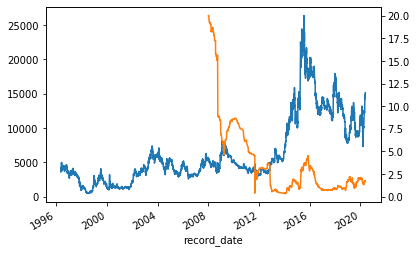

688    하이트진로홀딩스
Name: name, dtype: object 12.535332450331119


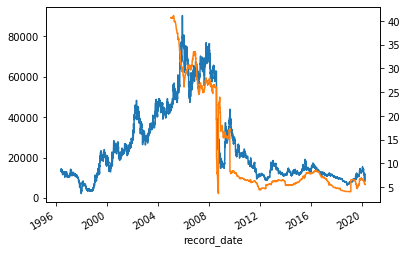

689    한국단자공업
Name: name, dtype: object 22.8465122349103


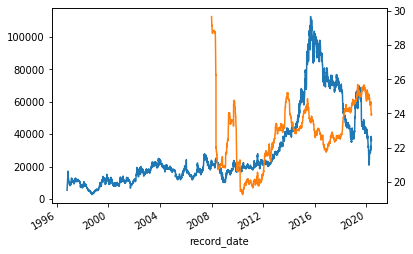

690    한국쉘석유
Name: name, dtype: object 65.94097483443723


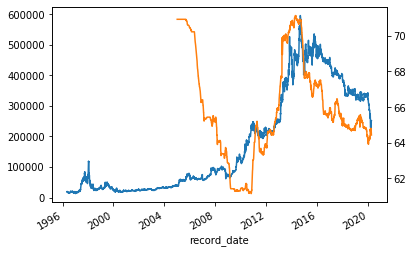

691    한국카본
Name: name, dtype: object 10.875504078303424


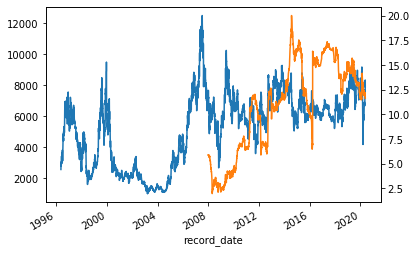

692    한국특수형강
Name: name, dtype: object 3.8832937685458964


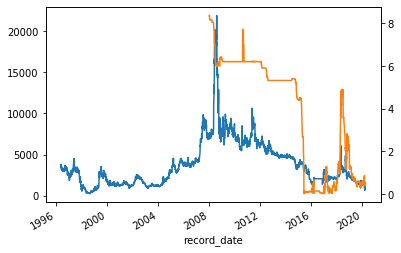

693    한농화성
Name: name, dtype: object 8.184750407830334


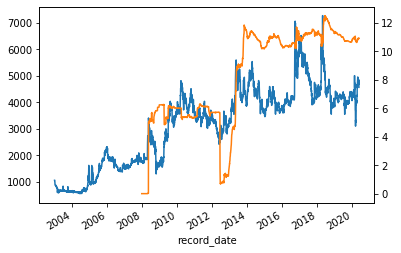

694    한미사이언스
Name: name, dtype: object 7.804929113089333


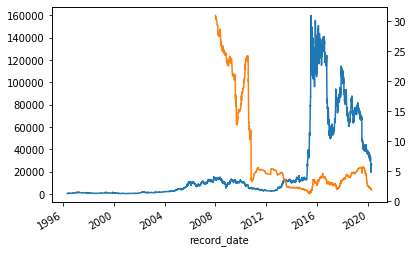

695    한신공영
Name: name, dtype: object 15.180956291390737


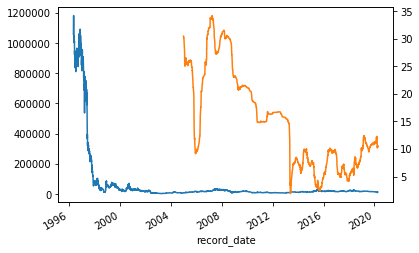

In [ ]:
#hi_for = 
for_rat = df_kosp[df_kosp['foreign_ratio'].notnull()]

for comp in company:
    
    df_company = df_kosp[df_kosp['company_id'] == comp]
    mean = df_company.loc[:,'foreign_ratio'].mean()
    
    name = df_comp[df_comp['company_id'] == comp]['name']
    
    print(name, mean)
    df_company.loc[:,'closing_price'].plot()
    df_company.loc[:,'foreign_ratio'].plot(secondary_y = True)
    plt.show()
    
    #if(mean > 50):
    #    
    #    name = df_comp[df_comp['company_id'] == comp]['name']
    #    print(name, mean)

In [ ]:
df_comp[df_comp['company_id'] == 6016]


### 데이터 정리해서 확인해보기

1. 전체 PER, PBR 추이
2. 1년 내 최저가
3. 현재 가격 기준 배당률
4. 외국인 보유율
5. PER, PBR


#### 전체 PER, PBR 추이

In [ ]:
# 2019년 eps를 바탕으로 현재 per을 구한다.

#df_fist[df_fist.index.year == 2019]


#df_fist[df_fist.index == 2019].loc[:,['company_id', 'eps']]
#df_kosp[df_kosp.index.date == datetime.strptime('2019-12-30', '%Y-%m-%d').date()]

## 통계청 자료 활용

path = r"C:\Users\Sunghyun\Desktop\Blog\개인 프로젝트\투자\키움증권 API를 활용하여 투자해보기\PBR.csv"
pbr = pd.read_csv(path)
path = r"C:\Users\Sunghyun\Desktop\Blog\개인 프로젝트\투자\키움증권 API를 활용하여 투자해보기\PER.csv"
per = pd.read_csv(path)



In [ ]:
pbr

In [ ]:

plt.rcParams["figure.figsize"] = (40,10)
per.iloc[0][3:].plot()
plt.show()
df_fina['kospi_price'][df_fina['kospi_price'].index.year > 2004].plot()
plt.show()
plt.rcParams["figure.figsize"] = (40,10)
pbr.iloc[0][3:].plot()

#### 1년 내 최저가, 최고가, 현재가, 현재 가격 기준 배당률
지금 PBR, PER은 가격만 반영해서 넣기

In [ ]:
## Company Data에 업데이트하기

today = datetime.now().date()
start_date = today - timedelta(days = 365)

df_1year = df_kosp[df_kosp.index.date>start_date]
df_fist_19 = df_fist[df_fist.index == 2019]
comp_list = df_comp.loc[:,['company_id', 'name']]
last_price = df_kosp[df_kosp.index.date == datetime.strptime('2019-12-30', '%Y-%m-%d').date()]
count = 0

for comp in comp_list.iterrows():
    
    comp_code = comp[1][0]
    comp_name = comp[1][1]
    comp_data = (df_1year[df_1year['company_id'] == comp_code]['closing_price'])
    comp_fist = (df_fist_19[df_fist_19['company_id'] == comp_code].loc[:,['per', 'pbr', 'dividend_yield']])
    lp = last_price[last_price['company_id'] == comp_code]['closing_price'].values[0]
    
    cur_price = comp_data[-1]
    min_price = min(comp_data)
    max_price = max(comp_data)
    dvy = comp_fist['dividend_yield'].iloc[0]
    cur_dvy = round(dvy * lp / cur_price, 2)
    per = comp_fist['per'].iloc[0]
    pbr = comp_fist['pbr'].iloc[0]
    #cur_per = round(comp_fist['per'].iloc[0] * lp/cur_price, 2)
    #cur_pbr = round(comp_fist['pbr'].iloc[0] * lp/cur_price, 2)
    #print(comp_code, comp_name, cur_per, lp, cur_price, comp_fist['per'].iloc[0] )
    count += 1
    print(f'''comp_code : {comp_code}, comp_name : {comp_name}, min_price : {min_price}, max_price : {max_price}, cur_price : {cur_price}, lp : {lp}, per : {per}, pbr : {pbr}, dvy : {dvy}, cur_dvy : {cur_dvy}''')
    if(count == 8):
        break

#### 성장주, 배당주, 안정주
1. 가치를 바탕으로 성장하는 주식은 어떤 재무제표를 보이는가? 성장주에 결과가 따라왔을 때는?
2. 가격이 떨어지는 주식은 어떤 재무제표를 보이는가?

처음부터 사전 정보를 통해 분석하지 않고 결과를 통해 과거를 돌아보자.

성장주 : 매출이 꾸준히 증가.(정량화할 수 없는 것들은 배제)
        
배당주 : 평균 배당률, 
안정주 : 


In [ ]:
df_fist.columns

In [ ]:
count = 0
for comp in up_rate:
    comp_code = comp[1]
    up_fist = df_fist[df_fist['company_id'] == comp_code]
    print(comp[0])
    up_fist.loc[:,['asset', 'liability']].plot()
    up_fist.loc[:,['asset', 'liability']].plot()
    up_fist.loc[:,['sales', 'operating_income', 'net_income']].plot(secondary_y = True)
    
    count += 1
    plt.show()
    

### 나는 어떤 Sector의 업종으로 투자공부를 시작할 것인가? → 전자제품 관련 업종

In [24]:
a = df_comp.loc[:,['company_id', 'name', 'sector']]
sector = set(list(a.loc[:, 'sector']))
print(len(sector))
interest_list =  ['정밀', '그외 기타 제품', '전지', '반도체', '전자']
int_sec = []
for sec in sector:
    for string in interest_list:
        if string in sec:
            int_sec.append(sec)
        
        
print(int_sec)
    

127
['측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외', '그외 기타 제품 제조업', '일차전지 및 축전지 제조업', '반도체 제조업', '전자부품 제조업']


In [25]:

for sec in int_sec:
    
    int_df = a[a['sector'] == sec]
    print(int_df)
    

     company_id   name                                 sector
194        6210  한화시스템  측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외
230        6246    디아이  측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외
379        6395     우진  측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외
647        6663   미래산업  측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외
680        6696    케이씨  측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외
774        6790   케이씨텍  측정, 시험, 항해, 제어 및 기타 정밀기기 제조업; 광학기기 제외
     company_id   name        sector
564        6580  씨아이테크  그외 기타 제품 제조업
     company_id      name          sector
34         6050     삼성SDI  일차전지 및 축전지 제조업
232        6248  디티알오토모티브  일차전지 및 축전지 제조업
360        6376      세방전지  일차전지 및 축전지 제조업
     company_id      name   sector
46         6062     신성이엔지  반도체 제조업
158        6174      써니전자  반도체 제조업
278        6294    티웨이홀딩스  반도체 제조업
300        6316     DB하이텍  반도체 제조업
320        6336    SK하이닉스  반도체 제조업
382        6398     웅진에너지  반도체 제조업
385        6401     유양디앤유  반도체 제조업
415        6431  현대에너지솔루션  반도체 제조업
424      